**ANT COLONY OPTIMIZATION & APPLICATIONS**


---
*Creator: Raza*

*Created: September 2022*

---
***`CONTENTS`***

*   `Ant Colony Optimization`
 *  *`Basic Implementation of Ant Colony Optimization`*
 *  *`Ant Colony Optimization with a bias towards exploitation`*
 *  *`Ant Colony Optimization with a local pheromone updating rule`*
 *  *`Elitist Ant System`*
 *  *`Max-Min Ant System`*
 *  *`Rank-based ant system`*
 *  *`Parallel Ant Colony Optimization`*
 *  *`Continuous Orthogonal Ant Colony`*
 *  *`Recursive Ant Colony Optimization`*
*    `Scheduling`
 *   *`Sequential Ordering Problem`*
 *   *`Job-Shop Scheduling Problem`*
 *   *`Open-Shop Scheduling Problem`*
 *   *`Permutation Flow Shop Problem`*
 *   *`Single Machine Total Tardiness Problem`*
 *   *`Single Machine Total Weighted Tardiness Problem`*
 *   *`Resource-Constrained Project Scheduling Problem`*
 *   *`Group-Shop Scheduling Problem`*
 *   *`Single-Machine Total Tardiness Problem with Sequence Dependent Setup Times`*
 *   *`Multistage Flowshop Scheduling Problem`*
 *   *`Assembly Sequence Planning`*
*    `Vehicle Routing`
 *   *`Capacitated Vehicle Routing Problem`*
 *   *`Multi-Depot Vehicle Routing Problem`*
 *   *`Period Vehicle Routing Problem`*
 *   *`Split Delivery Vehicle Routing Problem`*
 *   *`Stochastic Vehicle Routing Problem`*
 *   *`Vehicle Routing Problem with Pick-Up and Delivery`*
 *   *`Vehicle Routing Problem with Time Windows`*
 *   *`Time Dependent Vehicle Routing Problem with Time Windows`*
 *   *`Vehicle Routing Problem with Time Windows and Multiple Service Workers`*
*    `Assignment`
 *   *`Quadratic Assignment Problem`*
 *   *`Generalized Assignment Problem`*
 *   *`Frequency Assignment Problem`*
 *   *`Redundancy Allocation Problem`*
*    `Sets`
 *    *`Set Cover Problem`*
 *    *`Partition Problem`*
 *    *`Weight Constrained Graph Tree Partition Problem`*
 *    *`Arc-Weighted l-Cardinality Tree Problem`*
 *    *`Multiple Knapsack Problem`*
 *    *`Maximum Independent Set Problem`*
*     `Application in Electronics`
 *    *`Antenna Optimization`*
 *    *`CMOS Amplifier Optimization`*
 *    *`Reversible Circuit Synthesis`*


---









---



***ANT COLONY OPTIMIZATION***


---



**`Basic Implementation of Ant Colony Optimization`**

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, distances, n_ants, decay, alpha=1, beta=2, epsilon=1e-10):
        self.distances = distances
        self.pheromone = np.ones(self.distances.shape) / len(distances)
        self.all_inds = range(len(distances))
        self.n_ants = n_ants
        self.decay = decay
        self.alpha = alpha
        self.beta = beta
        self.epsilon = epsilon
    def run(self, n_iterations):
        best_path = None
        all_time_best_path = (self.gen_path(0), np.inf)
        for i in range(n_iterations):
            all_paths = self.gen_all_paths()
            self.spread_pheromone(all_paths, self.pheromone, self.distances)
            self.pheromone *= self.decay
            self.ant_update_pheromone(all_paths, self.pheromone, self.distances)
            self.global_update_pheromone(all_paths, self.pheromone, self.distances)
            current_best_distance = self.total_distance(all_time_best_path[0])
            if current_best_distance > self.total_distance(all_paths[0]):
                all_time_best_path = (all_paths[0], current_best_distance)
        return all_time_best_path
    def spread_pheromone(self, all_paths, pheromone, distances):
        for path in all_paths:
            total_distance = self.total_distance(path)
            for move in path:
                pheromone[move] += 1.0 / (total_distance + self.epsilon)
    def ant_update_pheromone(self, all_paths, pheromone, distances):
        for i in range(len(pheromone)):
            for j in range(len(pheromone)):
                if i != j:
                    pheromone[i, j] *= (1.0 - self.decay)
    def global_update_pheromone(self, all_paths, pheromone, distances):
        for i in range(len(pheromone)):
            for j in range(len(pheromone)):
                if i != j:
                    pheromone[i, j] += self.decay / (self.total_distance(all_paths[0]) + self.epsilon)
    def total_distance(self, path):
        return sum([self.distances[int(path[i-1]), int(path[i])] for i in range(1, len(path))])
    def gen_all_paths(self):
        all_paths = []
        for i in range(self.n_ants):
            path = self.gen_path(0)
            all_paths.append(path)
        return all_paths
    def gen_path(self, start):
        path = []
        visited = set()
        visited.add(start)
        prev = start
        for i in range(len(self.distances) - 1):
            move = self.pick_move(self.pheromone[prev], self.distances[prev], visited)
            path.append(move)
            prev = move
            visited.add(move)
        path.append(start)
        return path
    def pick_move(self, pheromone, distances, visited):
        pheromone = np.copy(pheromone)
        pheromone[list(visited)] = 0
        row = pheromone ** self.alpha * ((1.0 / (distances + self.epsilon)) ** self.beta)
        norm_row = row / row.sum()
        move = np_choice(self.all_inds, 1, p=norm_row)[0]
        return move
distances = np.array([[0, 2, 2, 5],
                      [2, 0, 4, 1],
                      [2, 4, 0, 3],
                      [5, 1, 3, 0]])
ant_colony = AntColony(distances, n_ants=5, decay=0.95, alpha=1, beta=2)
best_path = ant_colony.run(n_iterations=100)
print("All Paths =", ant_colony.gen_all_paths())
print("Best Path =", best_path[0])
print("Best Distance =", ant_colony.total_distance(best_path[0]))

All Paths = [[2, 1, 3, 0], [1, 3, 2, 0], [3, 1, 2, 0], [1, 3, 2, 0], [2, 3, 1, 0]]
Best Path = [1, 3, 2, 0]
Best Distance = 6


**`Ant Colony Optimization with a bias towards exploitation`**

In [ ]:
import random
import numpy as np
class AntColony:
    def __init__(self, distances, n_ants, n_best, n_iteration, decay, alpha=1, beta=2):
        self.distances  = distances
        self.pheromone = np.ones(self.distances.shape) / len(distances)
        self.all_inds = range(len(distances))
        self.n_ants = n_ants
        self.n_best = n_best
        self.n_iteration = n_iteration
        self.decay = decay
        self.alpha = alpha
        self.beta = beta
    def run(self):
        self.all_time_best_path = None
        self.all_time_best_length = np.inf
        for i in range(self.n_iteration):
            all_paths = self.gen_all_paths()
            self.spread_pheromone(all_paths, self.n_best, self.distances)
            self.pheromone * self.decay
            self.update_all_time_best(all_paths)
        return self.all_time_best_path
    def gen_path_dist(self, start):
        path = []
        visited = set()
        visited.add(start)
        prev = start
        for _ in range(len(self.distances) - 1):
            row = self.pheromone[prev]
            row[list(visited)] = 0
            next_index = np.argmax(row)
            path.append((prev, next_index))
            visited.add(next_index)
            prev = next_index
        return path
    def gen_all_paths(self):
        all_paths = []
        for i in range(self.n_ants):
            start = random.randint(0, len(self.distances) - 1)
            path = self.gen_path_dist(start)
            all_paths.append((path, self.gen_path_length(path)))
        return all_paths
    def spread_pheromone(self, all_paths, n_best, dists):
        sorted_paths = sorted(all_paths, key=lambda x: x[1])
        for path, dist in sorted_paths[:n_best]:
            for edge in path:
                self.pheromone[edge] += 1.0 / dist
    def gen_path_length(self, path):
        total_dist = 0
        for edge in path:
            total_dist += self.distances[edge]
        return total_dist
    def update_all_time_best(self, all_paths):
        for path, dist in all_paths:
            if dist < self.all_time_best_length:
                self.all_time_best_length = dist
                self.all_time_best_path = path
distances = np.array([[0, 2, 3, 4],
                     [2, 0, 5, 6],
                     [3, 5, 0, 7],
                     [4, 6, 7, 0]])
aco = AntColony(distances, n_ants=3, n_best=2, n_iteration=100, decay=0.95)
best_path = aco.run()
print("Best Path =", best_path)

Best Path = [(3, 0), (0, 1), (1, 2)]


**`Ant Colony Optimization with a local pheromone updating rule`**

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, distances, n_ants, decay, alpha=1, beta=1):
        self.distances = distances
        self.pheromone = np.ones(self.distances.shape) / len(distances)
        self.all_inds = range(len(distances))
        self.n_ants = n_ants
        self.decay = decay
        self.alpha = alpha
        self.beta = beta
    def run(self, n_iterations):
        best_path = None
        all_time_best_path = ("placeholder", np.inf)
        for i in range(n_iterations):
            all_paths = self.gen_all_paths()
            self.spread_pheromone(all_paths, self.n_ants, self.decay, self.alpha, self.beta)
            self.pheromone *= self.decay
            self.intensify_pheromone(all_paths, self.alpha)
            self.decrease_pheromone(self.decay)
            self.all_inds = range(len(self.pheromone))
            self.pheromone[self.pheromone < 0.01] = 0.01
            current_best_path = min(all_paths, key=lambda x: x[1])
            if current_best_path[1] < all_time_best_path[1]:
                all_time_best_path = current_best_path
        return all_time_best_path
    def spread_pheromone(self, all_paths, n_ants, decay, alpha, beta):
        sorted_paths = sorted(all_paths, key=lambda x: x[1])
        for path, dist in sorted_paths:
            for move in path:
                self.pheromone[move] += 1.0 / self.distances[move]
    def intensify_pheromone(self, all_paths, alpha):
        sorted_paths = sorted(all_paths, key=lambda x: x[1])
        for path, dist in sorted_paths:
            for move in path:
                self.pheromone[move] += (1.0 / dist) * alpha
    def decrease_pheromone(self, decay):
        self.pheromone *= decay
    def gen_path_dist(self, path):
        total_dist = 0
        for move in path:
            total_dist += self.distances[move]
        return total_dist
    def gen_all_paths(self):
        all_paths = []
        for i in range(self.n_ants):
            path = self.gen_path()
            path_dist = self.gen_path_dist(path)
            all_paths.append((path, path_dist))
        return all_paths
    def gen_path(self):
        path = []
        visited = set()
        start = np.random.randint(len(self.distances))
        current = start
        visited.add(current)
        for _ in range(len(self.distances) - 1):
            neighbors = [i for i in self.all_inds if i not in visited]
            probabilities = self.calculate_probabilities(current, neighbors)
            next_node = np.random.choice(neighbors, p=probabilities)
            path.append((current, next_node))
            current = next_node
            visited.add(current)
        path.append((current, start))
        return path
    def calculate_probabilities(self, current, neighbors):
        pheromone = self.pheromone[current][neighbors]
        distance = 1.0 / self.distances[current][neighbors]
        total = np.sum(pheromone**self.alpha * distance**self.beta)
        probabilities = (pheromone**self.alpha * distance**self.beta) / total
        return probabilities
distances = np.array([[np.inf, 2, 2, 5, 7],
                      [2, np.inf, 4, 8, 2],
                      [2, 4, np.inf, 1, 3],
                      [5, 8, 1, np.inf, 2],
                      [7, 2, 3, 2, np.inf]])
ant_colony = AntColony(distances=distances, n_ants=5, decay=0.95, alpha=1, beta=2)
best_path = ant_colony.run(n_iterations=100)
print("Best Path =", best_path[0])
print("Best Path Length =", best_path[1])

Best Path = [(3, 2), (2, 0), (0, 1), (1, 4), (4, 3)]
Best Path Length = 9.0


**`Ant Colony Optimization only the best ant updates the trails at the end of each iteration`**

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, distances, n_ants, decay, alpha=1, beta=1):
        self.distances  = distances
        self.pheromone = np.ones(self.distances.shape) / len(distances)
        self.all_inds = range(len(distances))
        self.n_ants = n_ants
        self.decay = decay
        self.alpha = alpha
        self.beta = beta
    def run(self, n_iterations):
        for i in range(n_iterations):
            all_tours = self.gen_all_tours()
            self.spread_pheronome(all_tours, self.n_ants, self.alpha, self.beta)
            self.pheromone *= self.decay
    def spread_pheronome(self, all_tours, n_ants, alpha, beta):
        sorted_tours = sorted(all_tours, key=lambda x: self.get_distance(x, alpha, beta))
        best_tour = sorted_tours[0]
        self.pheromone *= self.decay
        for tour in all_tours:
            distance = self.get_distance(tour, alpha, beta)
            for move in tour:
                self.pheromone[move] += 1.0 / (distance + 1e-10)
    def gen_all_tours(self):
        all_tours = []
        for i in range(self.n_ants):
            tour = self.gen_tour(0)
            all_tours.append(tour)
        return all_tours
    def gen_tour(self, start):
        tour = []
        visited = set()
        visited.add(start)
        prev = start
        for i in range(len(self.distances) - 1):
            move = self.pick_move(self.pheromone[prev], self.distances[prev], visited)
            tour.append((prev, move))
            prev = move
            visited.add(move)
        tour.append((prev, start))
        return tour
    def pick_move(self, pheromone, dist, visited):
        pheromone = np.copy(pheromone)
        pheromone[list(visited)] = 0
        row = pheromone ** self.alpha * ((1.0 / (dist + 1e-10)) ** self.beta)  # Add a small value to avoid division by zero
        norm_row = row / row.sum()
        move = np_choice(self.all_inds, 1, p=norm_row)[0]
        return move
    def get_distance(self, tour, alpha, beta):
        total_distance = 0
        for move in tour:
            total_distance += self.distances[move]
        return total_distance
def np_choice(a, size, replace=True, p=None):
    try:
        return np.random.choice(a, size=size, replace=replace, p=p)
    except AttributeError:
        return np.random.choice(a, size=size, replace=replace)
distances = np.array([
    [0, 2, 5, 8],
    [2, 0, 4, 6],
    [5, 4, 0, 3],
    [8, 6, 3, 0]
])
ant_colony = AntColony(distances, n_ants=3, decay=0.95, alpha=1, beta=2)
ant_colony.run(n_iterations=100)
final_pheromone = ant_colony.pheromone
print("Final Pheromone Matrix =")
print(final_pheromone)

Final Pheromone Matrix =
[[8.76316656e-06 1.71930464e+00 1.13010725e-04 1.33385341e-05]
 [1.15981851e-04 8.76316656e-06 1.71926244e+00 5.25648651e-05]
 [5.09606241e-05 1.49427751e-05 8.76316656e-06 1.71936508e+00]
 [1.71926404e+00 1.11406484e-04 5.55359916e-05 8.76316656e-06]]


**`Elitist Ant System`**

In [ ]:
import numpy as np
def ant_system(distance_matrix, n_ants, n_best, n_best_elitist, decay, alpha=1, beta=2, iterations=100):
    pheromone = np.ones(distance_matrix.shape) / len(distance_matrix)
    all_inds = range(len(distance_matrix))
    best_path = []
    best_cost = np.inf
    def gen_path_dist0():
        path_dist0 = []
        for i in range(len(all_inds)):
            allowed_inds = list(all_inds)
            prev_ind = -1
            for ele in range(len(all_inds)):
                allowed_inds = [ind for ind in allowed_inds if ind != prev_ind]
                row = pheromone[prev_ind, allowed_inds]
                row = row ** alpha
                dist = distance_matrix[prev_ind, allowed_inds]
                if np.any(dist == 0):
                    row = np.ones_like(row) / len(allowed_inds)
                else:
                    row = row * (1 / dist ** beta)
                    row = row / np.sum(row) if np.sum(row) != 0 else np.ones_like(row) / len(allowed_inds)
                row /= np.sum(row)
                next_ind = np.random.choice(allowed_inds, 1, p=row)[0]
                path_dist0.append((prev_ind, next_ind))
                prev_ind = next_ind
        return path_dist0
    def gen_path_dist(path):
        total_dist = 0
        for ele in path:
            total_dist += distance_matrix[ele[0], ele[1]]
        return total_dist
    def deposit_pheromone(to_deposit):
      nonlocal pheromone
      pheromone *= decay
      for path in to_deposit:
        for move in path:
          pheromone[move[0], move[1]] += 1 / gen_path_dist(path)
    for iteration in range(iterations):
        all_paths = [gen_path_dist0() for _ in range(n_ants)]
        all_costs = [gen_path_dist(path) for path in all_paths]
        deposit_pheromone(all_paths[:n_best])
        deposit_pheromone([best_path] * n_best_elitist)
        if min(all_costs) < best_cost:
            best_path = all_paths[np.argmin(all_costs)]
            best_cost = min(all_costs)
    return best_path, best_cost
distance_matrix = np.array([[0, 2, 4, 1],
                            [2, 0, 3, 2],
                            [4, 3, 0, 5],
                            [1, 2, 5, 0]])
n_ants = 5
n_best = 2
n_best_elitist = 1
decay = 0.95
alpha = 1
beta = 2
iterations = 100
best_path, best_cost = ant_system(distance_matrix, n_ants, n_best, n_best_elitist, decay, alpha, beta, iterations)
print("Best Path =", best_path)
print("Best Cost =", best_cost)

Best Path = [(-1, 3), (3, 0), (0, 1), (1, 2), (-1, 3), (3, 0), (0, 1), (1, 2), (-1, 0), (0, 3), (3, 1), (1, 2), (-1, 3), (3, 0), (0, 1), (1, 2)]
Best Cost = 25


Best Path = [(-1, 3), (3, 0), (0, 1), (1, 2), (-1, 3), (3, 0), (0, 1), (1, 2), (-1, 3), (3, 0), (0, 1), (1, 2), (-1, 3), (3, 0), (0, 1), (1, 2)]
Best Cost = 24


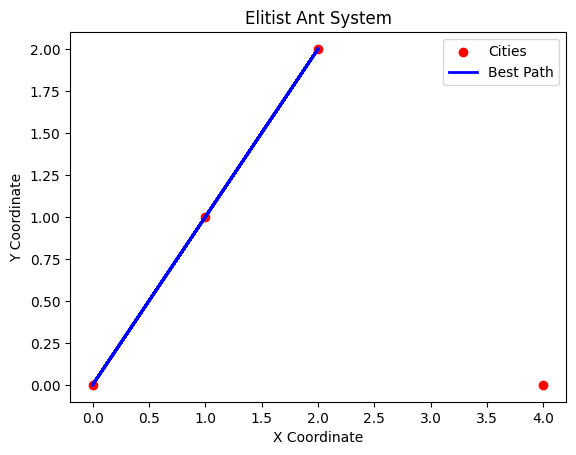

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
def plot_tsp(path, cities):
    x = [city[0] for city in cities]
    y = [city[1] for city in cities]
    plt.scatter(x, y, c='red', marker='o', label='Cities')
    path_x = [cities[i][0] for i, _ in path]
    path_y = [cities[i][1] for i, _ in path]
    path_x.append(cities[path[0][0]][0])
    path_y.append(cities[path[0][0]][1])
    plt.plot(path_x, path_y, linestyle='-', linewidth=2, c='blue', label='Best Path')
    plt.title('Elitist Ant System')
    plt.xlabel('X Coordinate')
    plt.ylabel('Y Coordinate')
    plt.legend()
    plt.show()
distance_matrix = np.array([[0, 2, 4, 1],
                            [2, 0, 3, 2],
                            [4, 3, 0, 5],
                            [1, 2, 5, 0]])
n_ants = 5
n_best = 2
n_best_elitist = 1
decay = 0.95
alpha = 1
beta = 2
iterations = 100
cities = [(0, 0), (2, 2), (4, 0), (1, 1)]
best_path, best_cost = ant_system(distance_matrix, n_ants, n_best, n_best_elitist, decay, alpha, beta, iterations)
print("Best Path =", best_path)
print("Best Cost =", best_cost)
plot_tsp(best_path, cities)

**`Max-Min Ant System`**

In [ ]:
import random
import numpy as np
class MaxMinAntSystem:
    def __init__(self, num_nodes, distances, max_pheromone, min_pheromone, alpha=1.0, beta=2.0, rho=0.5, stagnation_limit=10):
        self.num_nodes = num_nodes
        self.distances = distances
        self.max_pheromone = max_pheromone
        self.min_pheromone = min_pheromone
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.stagnation_limit = stagnation_limit
        self.pheromone_matrix = np.full((num_nodes, num_nodes), max_pheromone)
    def find_path(self, num_ants, max_iterations):
        best_path = None
        best_path_length = float('inf')
        stagnation_count = 0
        for iteration in range(max_iterations):
            ant_paths = self.run_ants(num_ants)
            self.update_pheromones(ant_paths)
            current_best_path, current_best_length = min(ant_paths, key=lambda x: x[1])
            if current_best_length < best_path_length:
                best_path = current_best_path
                best_path_length = current_best_length
                stagnation_count = 0
            else:
                stagnation_count += 1
            if stagnation_count >= self.stagnation_limit:
                self.pheromone_matrix = np.full((self.num_nodes, self.num_nodes), self.max_pheromone)
                stagnation_count = 0
        return best_path, best_path_length
    def run_ants(self, num_ants):
        ant_paths = []
        for ant in range(num_ants):
            start_node = random.randint(0, self.num_nodes - 1)
            ant_path = self.construct_solution(start_node)
            ant_paths.append((ant_path, self.calculate_path_length(ant_path)))
        return ant_paths
    def construct_solution(self, start_node):
        ant_path = [start_node]
        visited_nodes = set([start_node])
        while len(visited_nodes) < self.num_nodes:
            current_node = ant_path[-1]
            next_node = self.choose_next_node(current_node, visited_nodes)
            ant_path.append(next_node)
            visited_nodes.add(next_node)
        return ant_path
    def choose_next_node(self, current_node, visited_nodes):
        probabilities = self.calculate_probabilities(current_node, visited_nodes)
        next_node = np.random.choice(self.num_nodes, p=probabilities)
        return next_node
    def calculate_probabilities(self, current_node, visited_nodes):
        pheromone_values = self.pheromone_matrix[current_node, :]
        distances_values = 1 / (self.distances[current_node, :] + 1e-10)
        unvisited_nodes = [node for node in range(self.num_nodes) if node not in visited_nodes]
        pheromone_values = np.array([pheromone_values[node] for node in unvisited_nodes])
        distances_values = np.array([distances_values[node] for node in unvisited_nodes])
        probabilities = np.zeros(self.num_nodes)
        probabilities[unvisited_nodes] = (pheromone_values ** self.alpha) * (distances_values ** self.beta)
        probabilities /= probabilities.sum()
        return probabilities
    def calculate_path_length(self, path):
        length = 0
        for i in range(len(path) - 1):
            length += self.distances[path[i], path[i + 1]]
        length += self.distances[path[-1], path[0]]  # Return to the starting node
        return length
    def update_pheromones(self, ant_paths):
        self.pheromone_matrix *= (1 - self.rho)
        for ant_path, path_length in ant_paths:
            for i in range(len(ant_path) - 1):
                current_node, next_node = ant_path[i], ant_path[i + 1]
                self.pheromone_matrix[current_node, next_node] += 1 / path_length
                self.pheromone_matrix[next_node, current_node] += 1 / path_length
                self.pheromone_matrix[current_node, next_node] = min(self.max_pheromone,
                                                                     max(self.min_pheromone,
                                                                         self.pheromone_matrix[current_node, next_node]))
                self.pheromone_matrix[next_node, current_node] = min(self.max_pheromone,
                                                                     max(self.min_pheromone,
                                                                         self.pheromone_matrix[next_node, current_node]))
num_nodes = 5
distances = np.array([[0, 2, 3, 4, 5],
                      [2, 0, 4, 5, 6],
                      [3, 4, 0, 6, 7],
                      [4, 5, 6, 0, 8],
                      [5, 6, 7, 8, 0]])
max_pheromone = 1.0
min_pheromone = 0.1
alpha = 1.0
beta = 2.0
rho = 0.5
stagnation_limit = 10
max_min_ant_system = MaxMinAntSystem(num_nodes, distances, max_pheromone, min_pheromone, alpha, beta, rho, stagnation_limit)
num_ants = 5
max_iterations = 100
best_path, best_length = max_min_ant_system.find_path(num_ants, max_iterations)
print("Best Path =", best_path)
print("Best Path Length =", best_length)

Best Path = [3, 1, 0, 2, 4]
Best Path Length = 25


In [ ]:
!apt install libgraphviz-dev

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common libgvc6-plugins-gtk
  librsvg2-common libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk librsvg2-common libxdot4
0 upgraded, 9 newly installed, 0 to remove and 32 not upgraded.
Need to get 2,433 kB of archives.
After this operation, 7,694 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-common all 2.24.33-2ubuntu2 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-0 amd64 2.24.33-2ubuntu2 [2,037 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgail18 amd64 2.24.33-2ubuntu2 [15.9 kB]
Get:4 http://archive.ubuntu.com/ubuntu jammy/main amd64

In [ ]:
!pip install pygraphviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.9/104.9 kB 1.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pygraphviz: filename=pygraphviz-1.12-cp310-cp310-linux_x86_64.whl size=168134 sha256=62678a77e91b4a3762ff74b7d8c14ee389797a63e8f0b8d1759a0f19b3cc46ae
  Stored in directory: /root/.cache/pip/wheels/1d/ee/b5/a2f54f9e9b3951599c05dcce270ca85e472f8e6cec470e397a
Successfully built pygraphviz


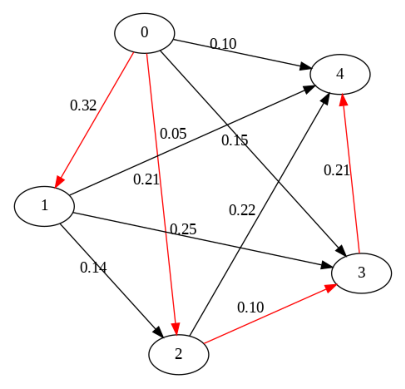

In [ ]:
import random
import numpy as np
import pygraphviz as pgv
import matplotlib.pyplot as plt
class MaxMinAntSystem:
    def __init__(self, num_nodes, distances, max_pheromone, min_pheromone, alpha=1.0, beta=2.0, rho=0.5, stagnation_limit=10):
        self.num_nodes = num_nodes
        self.distances = distances
        self.max_pheromone = max_pheromone
        self.min_pheromone = min_pheromone
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.stagnation_limit = stagnation_limit
        self.pheromone_matrix = np.full((num_nodes, num_nodes), max_pheromone)
    def find_path(self, num_ants, max_iterations):
        best_path = None
        best_path_length = float('inf')
        stagnation_count = 0
        for iteration in range(max_iterations):
            ant_paths = self.run_ants(num_ants)
            self.update_pheromones(ant_paths)
            current_best_path, current_best_length = min(ant_paths, key=lambda x: x[1])
            if current_best_length < best_path_length:
                best_path = current_best_path
                best_path_length = current_best_length
                stagnation_count = 0
            else:
                stagnation_count += 1
            if stagnation_count >= self.stagnation_limit:
                self.pheromone_matrix = np.full((self.num_nodes, self.num_nodes), self.max_pheromone)
                stagnation_count = 0
        return best_path, best_path_length
    def run_ants(self, num_ants):
        ant_paths = []
        for ant in range(num_ants):
            start_node = random.randint(0, self.num_nodes - 1)
            ant_path = self.construct_solution(start_node)
            ant_paths.append((ant_path, self.calculate_path_length(ant_path)))
        return ant_paths
    def construct_solution(self, start_node):
        ant_path = [start_node]
        visited_nodes = set([start_node])
        while len(visited_nodes) < self.num_nodes:
            current_node = ant_path[-1]
            next_node = self.choose_next_node(current_node, visited_nodes)
            ant_path.append(next_node)
            visited_nodes.add(next_node)
        return ant_path
    def choose_next_node(self, current_node, visited_nodes):
        probabilities = self.calculate_probabilities(current_node, visited_nodes)
        next_node = np.random.choice(self.num_nodes, p=probabilities)
        return next_node
    def calculate_probabilities(self, current_node, visited_nodes):
        pheromone_values = np.array([self.pheromone_matrix[current_node, node] for node in range(self.num_nodes)])
        distances_values = np.array([1 / (self.distances[current_node, node] + 1e-10) for node in range(self.num_nodes)])
        unvisited_nodes = [node for node in range(self.num_nodes) if node not in visited_nodes]
        pheromone_values = np.array([pheromone_values[node] for node in unvisited_nodes])
        distances_values = np.array([distances_values[node] for node in unvisited_nodes])
        probabilities = np.zeros(self.num_nodes)
        probabilities[unvisited_nodes] = (pheromone_values ** self.alpha) * (distances_values ** self.beta)
        probabilities /= probabilities.sum()
        return probabilities
    def calculate_path_length(self, path):
        length = 0
        for i in range(len(path) - 1):
            length += self.distances[path[i], path[i + 1]]
        length += self.distances[path[-1], path[0]]
        return length
    def update_pheromones(self, ant_paths):
        self.pheromone_matrix *= (1 - self.rho)
        for ant_path, path_length in ant_paths:
            for i in range(len(ant_path) - 1):
                current_node, next_node = ant_path[i], ant_path[i + 1]
                self.pheromone_matrix[current_node, next_node] += 1 / path_length
                self.pheromone_matrix[next_node, current_node] += 1 / path_length
                self.pheromone_matrix[current_node, next_node] = min(self.max_pheromone,
                                                                     max(self.min_pheromone,
                                                                         self.pheromone_matrix[current_node, next_node]))
                self.pheromone_matrix[next_node, current_node] = min(self.max_pheromone,
                                                                     max(self.min_pheromone,
                                                                         self.pheromone_matrix[next_node, current_node]))
    def visualize(self, best_path):
        graph = self.create_graph()
        for i in range(len(best_path) - 1):
            current_node, next_node = best_path[i], best_path[i + 1]
            try:
                edge = graph.get_edge(current_node, next_node)
                edge.attr.update(color='red')
            except KeyError:
                edge = graph.get_edge(next_node, current_node)
                edge.attr.update(color='red')
        graph.layout(prog='sfdp')
        graph.draw('max_min_ant_system.png')
        plt.imshow(plt.imread('max_min_ant_system.png'))
        plt.axis('off')
        plt.show()
    def create_graph(self):
        graph = pgv.AGraph(directed=True)
        for i in range(self.num_nodes):
            graph.add_node(i, label=f'{i}')
        for i in range(self.num_nodes):
            for j in range(i + 1, self.num_nodes):
                graph.add_edge(i, j, label=f'{self.pheromone_matrix[i][j]:.2f}')
        return graph
num_nodes = 5
distances = np.array([[0, 2, 3, 4, 5],
                      [2, 0, 4, 5, 6],
                      [3, 4, 0, 6, 7],
                      [4, 5, 6, 0, 8],
                      [5, 6, 7, 8, 0]])
max_pheromone = 1.0
min_pheromone = 0.1
alpha = 1.0
beta = 2.0
rho = 0.5
stagnation_limit = 10
num_ants = 5
max_iterations = 100
max_min_ant_system = MaxMinAntSystem(num_nodes, distances, max_pheromone, min_pheromone, alpha, beta, rho, stagnation_limit)
best_path, _ = max_min_ant_system.find_path(num_ants, max_iterations)
max_min_ant_system.visualize(best_path)

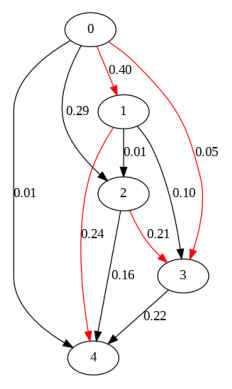

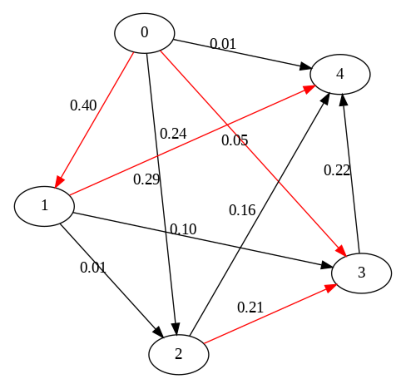

In [ ]:
import random
import numpy as np
import pygraphviz as pgv
import matplotlib.pyplot as plt
class MaxMinAntSystem:
    def __init__(self, num_nodes, distances, max_pheromone, min_pheromone, alpha=1.0, beta=2.0, rho=0.5, stagnation_limit=10):
        self.num_nodes = num_nodes
        self.distances = distances
        self.max_pheromone = max_pheromone
        self.min_pheromone = min_pheromone
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.stagnation_limit = stagnation_limit
        self.pheromone_matrix = np.full((num_nodes, num_nodes), max_pheromone)
    def find_path(self, num_ants, max_iterations):
        best_path = None
        best_path_length = float('inf')
        stagnation_count = 0
        for iteration in range(max_iterations):
            ant_paths = self.run_ants(num_ants)
            self.update_pheromones(ant_paths)
            current_best_path, current_best_length = min(ant_paths, key=lambda x: x[1])
            if current_best_length < best_path_length:
                best_path = current_best_path
                best_path_length = current_best_length
                stagnation_count = 0
            else:
                stagnation_count += 1
            if stagnation_count >= self.stagnation_limit:
                self.pheromone_matrix = np.full((self.num_nodes, self.num_nodes), self.max_pheromone)
                stagnation_count = 0
        return best_path, best_path_length
    def run_ants(self, num_ants):
        ant_paths = []
        for ant in range(num_ants):
            start_node = random.randint(0, self.num_nodes - 1)
            ant_path = self.construct_solution(start_node)
            ant_paths.append((ant_path, self.calculate_path_length(ant_path)))
        return ant_paths
    def construct_solution(self, start_node):
        ant_path = [start_node]
        visited_nodes = set([start_node])
        while len(visited_nodes) < self.num_nodes:
            current_node = ant_path[-1]
            next_node = self.choose_next_node(current_node, visited_nodes)
            ant_path.append(next_node)
            visited_nodes.add(next_node)
        return ant_path
    def choose_next_node(self, current_node, visited_nodes):
        probabilities = self.calculate_probabilities(current_node, visited_nodes)
        next_node = np.random.choice(self.num_nodes, p=probabilities)
        return next_node
    def calculate_probabilities(self, current_node, visited_nodes):
        pheromone_values = np.array([self.pheromone_matrix[current_node, node] for node in range(self.num_nodes)])
        distances_values = np.array([1 / (self.distances[current_node, node] + 1e-10) for node in range(self.num_nodes)])
        unvisited_nodes = [node for node in range(self.num_nodes) if node not in visited_nodes]
        pheromone_values = np.array([pheromone_values[node] for node in unvisited_nodes])
        distances_values = np.array([distances_values[node] for node in unvisited_nodes])
        probabilities = np.zeros(self.num_nodes)
        probabilities[unvisited_nodes] = (pheromone_values ** self.alpha) * (distances_values ** self.beta)
        probabilities /= probabilities.sum()
        return probabilities
    def calculate_path_length(self, path):
        length = 0
        for i in range(len(path) - 1):
            length += self.distances[path[i], path[i + 1]]
        length += self.distances[path[-1], path[0]]
        return length
    def update_pheromones(self, ant_paths):
        self.pheromone_matrix *= (1 - self.rho)
        for ant_path, path_length in ant_paths:
            for i in range(len(ant_path) - 1):
                current_node, next_node = ant_path[i], ant_path[i + 1]
                self.pheromone_matrix[current_node, next_node] += 1 / path_length
                self.pheromone_matrix[next_node, current_node] += 1 / path_length
                self.pheromone_matrix[current_node, next_node] = min(self.max_pheromone,
                                                                     max(self.min_pheromone,
                                                                         self.pheromone_matrix[current_node, next_node]))
                self.pheromone_matrix[next_node, current_node] = min(self.max_pheromone,
                                                                     max(self.min_pheromone,
                                                                         self.pheromone_matrix[next_node, current_node]))
    def visualize(self, best_path, layout='neato'):
        graph = self.create_graph()
        for i in range(len(best_path) - 1):
            current_node, next_node = best_path[i], best_path[i + 1]
            try:
                edge = graph.get_edge(current_node, next_node)
                edge.attr.update(color='red')
            except KeyError:
                edge = graph.get_edge(next_node, current_node)
                edge.attr.update(color='red')
        graph.layout(prog=layout)
        graph.draw(f'max_min_ant_system_{layout}.png')
        plt.imshow(plt.imread(f'max_min_ant_system_{layout}.png'))
        plt.axis('off')
        plt.show()
    def create_graph(self):
        graph = pgv.AGraph(directed=True)
        for i in range(self.num_nodes):
            graph.add_node(i, label=f'{i}')
        for i in range(self.num_nodes):
            for j in range(i + 1, self.num_nodes):
                graph.add_edge(i, j, label=f'{self.pheromone_matrix[i][j]:.2f}')
        return graph
num_nodes = 5
distances = np.array([[0, 2, 3, 4, 5],
                      [2, 0, 4, 5, 6],
                      [3, 4, 0, 6, 7],
                      [4, 5, 6, 0, 8],
                      [5, 6, 7, 8, 0]])
max_pheromone = 1.0
min_pheromone = 0.1
alpha = 1.0
beta = 2.0
rho = 0.5
stagnation_limit = 10
num_ants = 5
max_iterations = 100
max_min_ant_system = MaxMinAntSystem(num_nodes, distances, max_pheromone, min_pheromone, alpha, beta, rho, stagnation_limit)
best_path, _ = max_min_ant_system.find_path(num_ants, max_iterations)
max_min_ant_system.visualize(best_path, layout='dot')
max_min_ant_system.visualize(best_path, layout='sfdp')

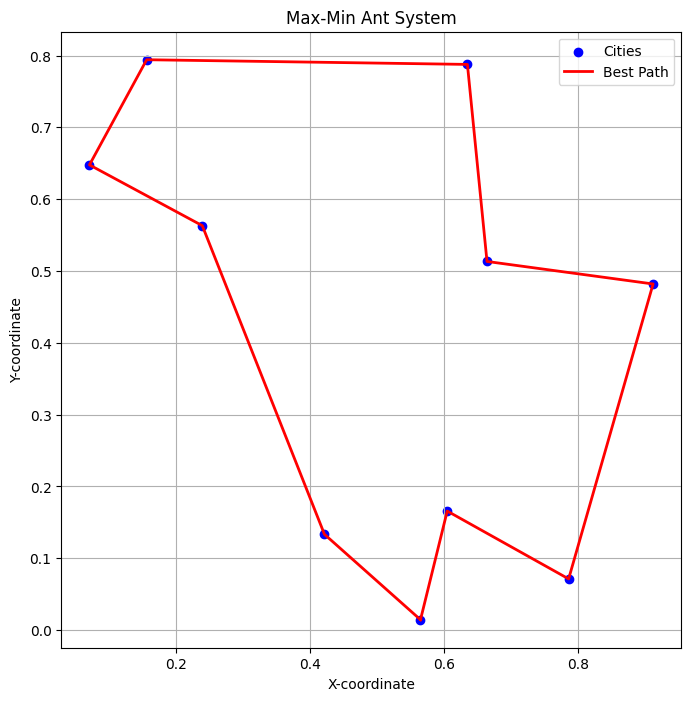

In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
class MaxMinAntSystem:
    def __init__(self, num_nodes, distances, max_pheromone, min_pheromone, alpha=1.0, beta=2.0, rho=0.5, stagnation_limit=10):
        self.num_nodes = num_nodes
        self.distances = distances
        self.max_pheromone = max_pheromone
        self.min_pheromone = min_pheromone
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.stagnation_limit = stagnation_limit
        self.pheromone_matrix = np.full((num_nodes, num_nodes), max_pheromone)
    def find_path(self, num_ants, max_iterations):
        best_path = None
        best_path_length = float('inf')
        stagnation_count = 0
        for iteration in range(max_iterations):
            ant_paths = self.run_ants(num_ants)
            self.update_pheromones(ant_paths)
            current_best_path, current_best_length = min(ant_paths, key=lambda x: x[1])
            if current_best_length < best_path_length:
                best_path = current_best_path
                best_path_length = current_best_length
                stagnation_count = 0
            else:
                stagnation_count += 1
            if stagnation_count >= self.stagnation_limit:
                self.pheromone_matrix = np.full((self.num_nodes, self.num_nodes), self.max_pheromone)
                stagnation_count = 0
        return best_path, best_path_length
    def run_ants(self, num_ants):
        ant_paths = []
        for ant in range(num_ants):
            start_node = random.randint(0, self.num_nodes - 1)
            ant_path = self.construct_solution(start_node)
            ant_paths.append((ant_path, self.calculate_path_length(ant_path)))
        return ant_paths
    def construct_solution(self, start_node):
        ant_path = [start_node]
        visited_nodes = set([start_node])
        while len(visited_nodes) < self.num_nodes:
            current_node = ant_path[-1]
            next_node = self.choose_next_node(current_node, visited_nodes)
            ant_path.append(next_node)
            visited_nodes.add(next_node)
        return ant_path
    def choose_next_node(self, current_node, visited_nodes):
        probabilities = self.calculate_probabilities(current_node, visited_nodes)
        next_node = np.random.choice(self.num_nodes, p=probabilities)
        return next_node
    def calculate_probabilities(self, current_node, visited_nodes):
        pheromone_values = np.array([self.pheromone_matrix[current_node, node] for node in range(self.num_nodes)])
        distances_values = np.array([1 / (np.linalg.norm(self.distances[current_node] - self.distances[node]) + 1e-10) for node in range(self.num_nodes)])
        unvisited_nodes = [node for node in range(self.num_nodes) if node not in visited_nodes]
        pheromone_values = np.array([pheromone_values[node] for node in unvisited_nodes])
        distances_values = np.array([distances_values[node] for node in unvisited_nodes])
        probabilities = np.zeros(self.num_nodes)
        probabilities[unvisited_nodes] = (pheromone_values ** self.alpha) * (distances_values ** self.beta)
        probabilities /= probabilities.sum()
        return probabilities
    def calculate_path_length(self, path):
        length = 0
        for i in range(len(path) - 1):
            length += np.linalg.norm(self.distances[path[i]] - self.distances[path[i + 1]])
        length += np.linalg.norm(self.distances[path[-1]] - self.distances[path[0]])
        return length
    def update_pheromones(self, ant_paths):
        self.pheromone_matrix *= (1 - self.rho)
        for ant_path, path_length in ant_paths:
            for i in range(len(ant_path) - 1):
                current_node, next_node = ant_path[i], ant_path[i + 1]
                self.pheromone_matrix[current_node, next_node] += 1 / path_length
                self.pheromone_matrix[next_node, current_node] += 1 / path_length
                self.pheromone_matrix[current_node, next_node] = min(self.max_pheromone,
                                                                     max(self.min_pheromone,
                                                                         self.pheromone_matrix[current_node, next_node]))
                self.pheromone_matrix[next_node, current_node] = min(self.max_pheromone,
                                                                     max(self.min_pheromone,
                                                                         self.pheromone_matrix[next_node, current_node]))
    def visualize_matplotlib(self, best_path):
        plt.figure(figsize=(8, 8))
        cities_x = [self.distances[i, 0] for i in range(self.num_nodes)]
        cities_y = [self.distances[i, 1] for i in range(self.num_nodes)]
        plt.scatter(cities_x, cities_y, color='blue', label='Cities')
        path_x = [self.distances[i, 0] for i in best_path]
        path_y = [self.distances[i, 1] for i in best_path]
        path_x.append(path_x[0])
        path_y.append(path_y[0])
        plt.plot(path_x, path_y, color='red', linestyle='-', linewidth=2, label='Best Path')
        plt.title('Max-Min Ant System')
        plt.xlabel('X-coordinate')
        plt.ylabel('Y-coordinate')
        plt.legend()
        plt.grid(True)
        plt.show()
num_nodes = 10
distances = np.random.rand(num_nodes, 2)
max_pheromone = 1.0
min_pheromone = 0.1
alpha = 1.0
beta = 2.0
rho = 0.5
stagnation_limit = 10
num_ants = 5
max_iterations = 100
max_min_ant_system = MaxMinAntSystem(num_nodes, distances, max_pheromone, min_pheromone, alpha, beta, rho, stagnation_limit)
best_path, _ = max_min_ant_system.find_path(num_ants, max_iterations)
max_min_ant_system.visualize_matplotlib(best_path)

**`Rank-based Any System`**

In [ ]:
import numpy as np
class ASRank:
    def __init__(self, num_ants, num_nodes, alpha=1.0, beta=2.0, rho=0.1, q0=0.9, max_iterations=100):
        self.num_ants = num_ants
        self.num_nodes = num_nodes
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q0 = q0
        self.max_iterations = max_iterations
        self.pheromone_matrix = np.ones((num_nodes, num_nodes))
        self.distances = np.random.randint(1, 10, size=(num_nodes, num_nodes))
        np.fill_diagonal(self.distances, 0)
    def run(self):
        best_solution = None
        best_length = float('inf')
        for iteration in range(self.max_iterations):
            solutions = self.generate_solutions()
            ranked_solutions = sorted(solutions, key=lambda x: self.calculate_length(x))
            num_updates = int(self.num_ants * 0.2)
            for ant in ranked_solutions[:num_updates]:
                self.update_pheromones(ant)
            self.pheromone_matrix *= (1 - self.rho)
            if self.calculate_length(ranked_solutions[0]) < best_length:
                best_solution = ranked_solutions[0]
                best_length = self.calculate_length(best_solution)
            print(f"Iteration-{iteration + 1}, Best Length = {best_length}")
        return best_solution, best_length
    def generate_solutions(self):
        solutions = []
        for ant in range(self.num_ants):
            solution = self.construct_solution()
            solutions.append(solution)
        return solutions
    def construct_solution(self):
        solution = [0]
        for _ in range(self.num_nodes - 1):
            next_node = self.choose_next_node(solution)
            solution.append(next_node)
        return solution
    def choose_next_node(self, solution):
        current_node = solution[-1]
        available_nodes = list(set(range(self.num_nodes)) - set(solution))
        if np.random.rand() < self.q0:
            pheromone_values = [self.pheromone_matrix[current_node][next_node] for next_node in available_nodes]
            next_node = available_nodes[np.argmax(pheromone_values)]
        else:
            probabilities = self.calculate_probabilities(current_node, available_nodes)
            next_node = np.random.choice(available_nodes, p=probabilities)
        return next_node
    def calculate_probabilities(self, current_node, available_nodes):
        pheromone_values = [self.pheromone_matrix[current_node][next_node] for next_node in available_nodes]
        distances = [1 / self.distances[current_node][next_node] for next_node in available_nodes]
        total = np.sum(np.power(pheromone_values, self.alpha) * np.power(distances, self.beta))
        probabilities = [(np.power(pheromone, self.alpha) * np.power(distance, self.beta)) / total
                         for pheromone, distance in zip(pheromone_values, distances)]
        return probabilities
    def update_pheromones(self, solution):
        pheromone_deposit = 1 / self.calculate_length(solution)
        for i in range(self.num_nodes - 1):
            current_node, next_node = solution[i], solution[i + 1]
            self.pheromone_matrix[current_node][next_node] += pheromone_deposit
            self.pheromone_matrix[next_node][current_node] += pheromone_deposit
    def calculate_length(self, solution):
        length = sum([self.distances[solution[i]][solution[i + 1]] for i in range(len(solution) - 1)])
        return length
num_ants = 10
num_nodes = 5
asrank = ASRank(num_ants=num_ants, num_nodes=num_nodes)
best_solution, best_length = asrank.run()
print(f"Best Solution = {best_solution}")
print(f"Best Length = {best_length}")

Iteration-1, Best Length = 19
Iteration-2, Best Length = 17
Iteration-3, Best Length = 17
Iteration-4, Best Length = 17
Iteration-5, Best Length = 16
Iteration-6, Best Length = 16
Iteration-7, Best Length = 16
Iteration-8, Best Length = 16
Iteration-9, Best Length = 16
Iteration-10, Best Length = 16
Iteration-11, Best Length = 16
Iteration-12, Best Length = 16
Iteration-13, Best Length = 16
Iteration-14, Best Length = 16
Iteration-15, Best Length = 16
Iteration-16, Best Length = 16
Iteration-17, Best Length = 16
Iteration-18, Best Length = 16
Iteration-19, Best Length = 16
Iteration-20, Best Length = 16
Iteration-21, Best Length = 16
Iteration-22, Best Length = 16
Iteration-23, Best Length = 16
Iteration-24, Best Length = 16
Iteration-25, Best Length = 16
Iteration-26, Best Length = 16
Iteration-27, Best Length = 16
Iteration-28, Best Length = 16
Iteration-29, Best Length = 16
Iteration-30, Best Length = 16
Iteration-31, Best Length = 16
Iteration-32, Best Length = 16
Iteration-33, Bes

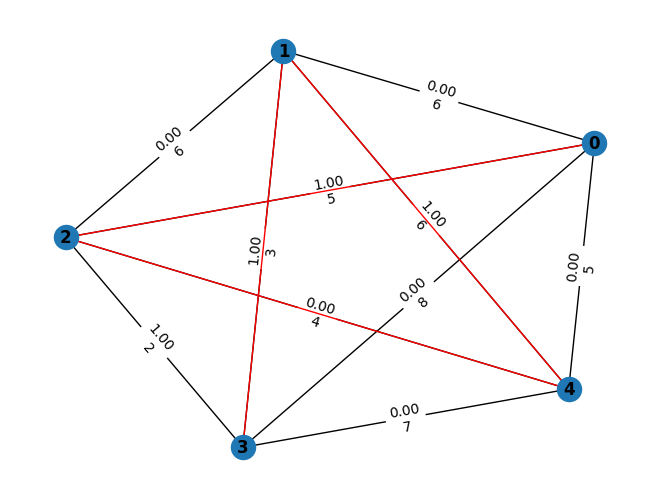

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
class ASRankVisualizer:
    def __init__(self, pheromone_matrix, distances, best_solution):
        self.pheromone_matrix = pheromone_matrix
        self.distances = distances
        self.best_solution = best_solution
    def visualize_graph(self, output_file='asrank.png'):
        graph = nx.Graph()
        for i in range(len(self.distances)):
            graph.add_node(i)
        for i in range(len(self.distances)):
            for j in range(i + 1, len(self.distances[i])):
                edge_label = f"{self.pheromone_matrix[i][j]:.2f}\n{self.distances[i][j]}"
                graph.add_edge(i, j, label=edge_label)
        pos = nx.spring_layout(graph)
        labels = nx.get_edge_attributes(graph, 'label')
        nx.draw(graph, pos, with_labels=True, font_weight='bold')
        nx.draw_networkx_edge_labels(graph, pos, edge_labels=labels)
        for i in range(len(self.best_solution) - 1):
            nx.draw_networkx_edges(graph, pos, edgelist=[(self.best_solution[i], self.best_solution[i + 1])], edge_color='red')
        plt.savefig(output_file)
        plt.show()
best_solution_reverse = best_solution[::-1]
asrank_visualizer = ASRankVisualizer(asrank.pheromone_matrix, asrank.distances, best_solution_reverse)
asrank_visualizer.visualize_graph()

**`Parallel Ant Colony Optimization`**

In [ ]:
import multiprocessing
import numpy as np
class AntColony:
    def __init__(self, num_ants, num_iterations, pheromone_decay, alpha=1, beta=2):
        self.num_ants = num_ants
        self.num_iterations = num_iterations
        self.pheromone_decay = pheromone_decay
        self.alpha = alpha
        self.beta = beta
        self.distances = np.array([[0, 2, 5, 8],
                                   [2, 0, 4, 7],
                                   [5, 4, 0, 3],
                                   [8, 7, 3, 0]])
        self.pheromones = np.ones_like(self.distances) / len(self.distances)
    def run(self):
        for iteration in range(self.num_iterations):
            with multiprocessing.Pool() as pool:
                results = pool.map(self.run_single_ant, range(self.num_ants))
            self.update_pheromones(results)
    def run_single_ant(self, ant_id):
        num_cities = len(self.distances)
        visited = set()
        current_city = np.random.randint(num_cities)
        tour_length = 0
        for _ in range(num_cities - 1):
            visited.add(current_city)
            allowed_cities = set(range(num_cities)) - visited
            probabilities = self.calculate_probabilities(current_city, allowed_cities)
            next_city = np.random.choice(list(allowed_cities), p=probabilities)
            tour_length += self.distances[current_city, next_city]
            current_city = next_city
        return ant_id, tour_length
    def calculate_probabilities(self, current_city, allowed_cities):
        pheromone_values = self.pheromones[current_city, list(allowed_cities)]
        distance_values = 1 / (self.distances[current_city, list(allowed_cities)] + 1e-10)
        total_values = np.power(pheromone_values, self.alpha) * np.power(distance_values, self.beta)
        probabilities = total_values / total_values.sum()
        return probabilities
    def update_pheromones(self, results):
        self.pheromones *= (1 - self.pheromone_decay)
        for ant_id, tour_length in results:
            self.pheromones[ant_id % len(self.distances), (ant_id + 1) % len(self.distances)] += 1 / tour_length
if __name__ == "__main__":
    num_ants = 4
    num_iterations = 100
    pheromone_decay = 0.1
    ant_colony = AntColony(num_ants, num_iterations, pheromone_decay)
    ant_colony.run()
    print("Final Pheromones =")
    print(ant_colony.pheromones)

Final Pheromones =
[[6.64034972e-06 1.11108547e+00 6.64034972e-06 6.64034972e-06]
 [6.64034972e-06 6.64034972e-06 7.20977990e-01 6.64034972e-06]
 [6.64034972e-06 6.64034972e-06 6.64034972e-06 1.05676380e+00]
 [1.11108086e+00 6.64034972e-06 6.64034972e-06 6.64034972e-06]]


**`Continuous Orthogonal Ant Colony`**

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, colony_size, dim, lower_bound, upper_bound, alpha=1.0, beta=2.0, rho=0.1, q0=0.9, iterations=100):
        self.colony_size = colony_size
        self.dim = dim
        self.lower_bound = lower_bound
        self.upper_bound = upper_bound
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q0 = q0
        self.iterations = iterations
        self.pheromone_matrix = np.ones((colony_size, dim))
        self.position_matrix = self.initialize_positions()
    def initialize_positions(self):
        return np.random.uniform(low=self.lower_bound, high=self.upper_bound, size=(self.colony_size, self.dim))
    def update_pheromones(self, delta_pheromones):
        self.pheromone_matrix = (1 - self.rho) * self.pheromone_matrix + delta_pheromones
    def run(self):
        for iteration in range(self.iterations):
            delta_pheromones = np.zeros((self.colony_size, self.dim))
            for ant in range(self.colony_size):
                current_position = self.position_matrix[ant]
                for dimension in range(self.dim):
                    if np.random.rand() < self.q0:
                        next_position = np.argmax(self.pheromone_matrix[:, dimension])
                    else:
                        distances = np.abs(self.position_matrix[:, dimension] - current_position[dimension])
                        probabilities = (self.pheromone_matrix[:, dimension] ** self.alpha) * (
                                (1 / (distances + 1e-8)) ** self.beta)
                        probabilities /= probabilities.sum()
                        next_position = np.random.choice(range(self.colony_size), p=probabilities)
                    delta_pheromones[next_position, dimension] += 1
                self.position_matrix[ant] = self.position_matrix[ant] + delta_pheromones[ant]
            self.update_pheromones(delta_pheromones)
        best_ant = np.argmax(self.pheromone_matrix.sum(axis=1))
        best_solution = self.position_matrix[best_ant]
        return best_solution
colony_size = 10
dimension = 2
lower_bound = -5.0
upper_bound = 5.0
aco = AntColony(colony_size, dimension, lower_bound, upper_bound)
best_solution = aco.run()
print("Best solution =", best_solution)

Best solution = [95.57303119 99.58466755]


In [ ]:
import numpy as np
import pygraphviz as pgv
import matplotlib.pyplot as plt
class AntColony:
    def __init__(self, colony_size, dim, lower_bound, upper_bound, alpha=1.0, beta=2.0, rho=0.1, q0=0.9, iterations=100):
        self.colony_size = colony_size
        self.dim = dim
        self.lower_bound = lower_bound
        self.upper_bound = upper_bound
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q0 = q0
        self.iterations = iterations
        self.pheromone_matrix = np.ones((colony_size, dim))
        self.position_matrix = self.initialize_positions()
        self.graph = pgv.AGraph(directed=True)
    def initialize_positions(self):
        return np.random.uniform(low=self.lower_bound, high=self.upper_bound, size=(self.colony_size, self.dim))
    def update_pheromones(self, delta_pheromones):
        self.pheromone_matrix = (1 - self.rho) * self.pheromone_matrix + delta_pheromones
    def run(self):
        for iteration in range(self.iterations):
            delta_pheromones = np.zeros((self.colony_size, self.dim))
            for ant in range(self.colony_size):
                current_position = self.position_matrix[ant]
                for dimension in range(self.dim):
                    if np.random.rand() < self.q0:
                        next_position = np.argmax(self.pheromone_matrix[:, dimension])
                    else:
                        distances = np.abs(self.position_matrix[:, dimension] - current_position[dimension])
                        probabilities = (self.pheromone_matrix[:, dimension] ** self.alpha) * (
                                (1 / (distances + 1e-8)) ** self.beta)
                        probabilities /= probabilities.sum()
                        next_position = np.random.choice(range(self.colony_size), p=probabilities)
                        self.graph.add_edge(ant, next_position)
                    delta_pheromones[next_position, dimension] += 1
                self.position_matrix[ant] = self.position_matrix[ant] + delta_pheromones[ant]
            self.update_pheromones(delta_pheromones)
        best_ant = np.argmax(self.pheromone_matrix.sum(axis=1))
        best_solution = self.position_matrix[best_ant]
        return best_solution
    def visualize(self, output_file="continuous_orthogonal_ant_colony.png"):
        self.graph.layout(prog="dot")
        self.graph.draw(output_file)
colony_size = 10
dimension = 2
lower_bound = -5.0
upper_bound = 5.0
aco = AntColony(colony_size, dimension, lower_bound, upper_bound)
best_solution = aco.run()
aco.visualize()
print("Best solution =", best_solution)

Best solution = [103.76983696  99.85228482]


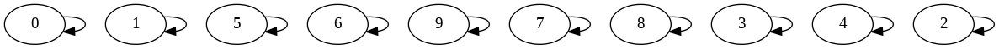

**`Recursive Ant Colony Optimization`**

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, distances, n_ants, pheromone_decay=0.1, alpha=1, beta=2):
        self.distances  = distances
        self.pheromone_decay = pheromone_decay
        self.pheromone = np.ones(self.distances.shape) / len(distances)
        self.all_inds = range(len(distances))
        self.alpha = alpha
        self.beta = beta
        self.n_ants = n_ants
    def run(self, n):
        self.initial_pheromone = np.copy(self.pheromone)
        self.best_path = None
        self.all_time_best_path = ("placeholder", np.inf)
        for i in range(n):
            all_paths = self.gen_all_paths()
            self.spread_pheronome(all_paths, self.pheromone_decay)
            self.intensify_pheronome(self.best_path)
            self.pheromone * self.pheromone_decay
            if self.best_path != None and self.all_time_best_path[1] > self.best_path[1]:
                self.all_time_best_path = self.best_path
            self.best_path = None
    def spread_pheronome(self, all_paths, decay = 0.9):
        pheromones = np.zeros(self.pheromone.shape)
        for path in all_paths:
            cost = path[1]
            for move in path[0]:
                pheromones[move] += 1.0 / cost
        self.pheromone * decay + pheromones
    def intensify_pheronome(self, path):
        for move in path[0]:
            self.pheromone[move] += 1.0 / path[1]
    def gen_path_dist(self, path):
        total_dist = 0
        for ele in path:
            total_dist += self.distances[ele]
        return total_dist
    def gen_all_paths(self):
        all_paths = []
        for i in range(self.n_ants):
            path = self.gen_path_dist(self.gen_path_dist())
            all_paths.append((path[0], path[1]))
            if self.best_path == None or path[1] < self.best_path[1]:
                self.best_path = path
        return all_paths
    def gen_path_dist(self):
        path = []
        visited = set()
        visited.add(0)
        prev = 0
        for i in range(len(self.distances) - 1):
            move = self.pick_move(self.pheromone[prev], self.distances[prev], visited)
            path.append((prev, move))
            prev = move
            visited.add(move)
        path.append((prev, 0))
        return path
    def pick_move(self, pheromone, dist, visited):
        pheromone = np.copy(pheromone)
        pheromone[list(visited)] = 0
        row = pheromone ** self.alpha * (( 1.0 / dist) ** self.beta)
        norm_row = row / row.sum()
        move = np_choice(self.all_inds, 1, p=norm_row)[0]
        return move

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, objective_function, num_ants, max_iter, subdomain_range):
        self.objective_function = objective_function
        self.num_ants = num_ants
        self.max_iter = max_iter
        self.subdomain_range = subdomain_range
    def optimize(self, subdomain):
        best_solution = None
        best_value = float('inf')
        for _ in range(self.num_ants):
            ant_solution = self.generate_solution(subdomain)
            ant_value = self.objective_function(ant_solution)
            if ant_value < best_value:
                best_solution = ant_solution
                best_value = ant_value
        return best_solution, best_value
    def generate_solution(self, subdomain):
        return np.random.uniform(subdomain[0], subdomain[1])
    def run_recursive_aco(self, current_subdomain, precision=1e-6):
        if np.abs(current_subdomain[0] - current_subdomain[1]) < precision:
            return current_subdomain[0]
        subdomain_size = (current_subdomain[1] - current_subdomain[0]) / self.num_ants
        next_level_subdomains = [
            (current_subdomain[0] + i * subdomain_size, current_subdomain[0] + (i + 1) * subdomain_size)
            for i in range(self.num_ants)
        ]
        best_solutions = []
        for subdomain in next_level_subdomains:
            best_solution, _ = self.optimize(subdomain)
            best_solutions.append(best_solution)
        best_solutions.sort(key=lambda x: self.objective_function(x))
        next_subdomain = (best_solutions[0], best_solutions[1])
        return self.run_recursive_aco(next_subdomain, precision)
def objective_function(x):
    return x**2
num_ants = 10
max_iter = 100
subdomain_range = (-10, 10)
precision = 1e-6
aco = AntColony(objective_function, num_ants, max_iter, subdomain_range)
result = aco.run_recursive_aco(subdomain_range, precision)
print("Optimal solution =", result)
print("Objective value =", objective_function(result))

Optimal solution = -4.061167115233758e-08
Objective value = 1.6493078337856086e-15


In [ ]:
import numpy as np
"""
I have used here Ackley function as an example for demonstration of Recursive Ant Colony Optimization.
Reference: https://en.wikipedia.org/wiki/Ackley_function
"""
def ackley_function(x):
    a = 20
    b = 0.2
    c = 2 * np.pi
    term1 = -a * np.exp(-b * np.sqrt(np.mean(x**2)))
    term2 = -np.exp(np.mean(np.cos(c * x)))
    return term1 + term2 + a + np.exp(1)
class AntColony:
    def __init__(self, objective_function, num_ants, max_iter, subdomain_range):
        self.objective_function = objective_function
        self.num_ants = num_ants
        self.max_iter = max_iter
        self.subdomain_range = subdomain_range
    def optimize(self, subdomain):
        best_solution = None
        best_value = float('inf')
        for _ in range(self.num_ants):
            ant_solution = self.generate_solution(subdomain)
            ant_value = self.objective_function(ant_solution)
            if ant_value < best_value:
                best_solution = ant_solution
                best_value = ant_value
        return best_solution, best_value
    def generate_solution(self, subdomain):
        return np.random.uniform(subdomain[0], subdomain[1])
    def run_recursive_aco(self, current_subdomain, precision=1e-6):
        if np.abs(current_subdomain[0] - current_subdomain[1]) < precision:
            return current_subdomain[0]
        subdomain_size = (current_subdomain[1] - current_subdomain[0]) / self.num_ants
        next_level_subdomains = [
            (current_subdomain[0] + i * subdomain_size, current_subdomain[0] + (i + 1) * subdomain_size)
            for i in range(self.num_ants)
        ]
        best_solutions = []
        for subdomain in next_level_subdomains:
            best_solution, _ = self.optimize(subdomain)
            best_solutions.append(best_solution)
        best_solutions.sort(key=lambda x: self.objective_function(x))
        next_subdomain = (best_solutions[0], best_solutions[1])
        return self.run_recursive_aco(next_subdomain, precision)
num_ants = 10
max_iter = 100
subdomain_range = (-5, 5)
precision = 1e-6
aco = AntColony(ackley_function, num_ants, max_iter, subdomain_range)
result = aco.run_recursive_aco(subdomain_range, precision)
print("Optimal solution =", result)
print("Objective value =", ackley_function(result))

Optimal solution = -0.0001192173193674518
Objective value = 0.00047762620302238545


In [ ]:
import numpy as np
"""
I have used here Ackley function as an example for demonstration of Recursive Ant Colony Optimization.
f(x,y) = -20*exp[-0.2*√(0.5*(x^2+y^2))] - exp[0.5(cos2πx + cos2πy)] + e + 20
Global optimum point: f(0,0)=0
Reference: https://en.wikipedia.org/wiki/Ackley_function
"""
class AntColony:
    def __init__(self, objective_function, num_ants, max_iter, subdomain_range):
        self.objective_function = objective_function
        self.num_ants = num_ants
        self.max_iter = max_iter
        self.subdomain_range = subdomain_range
    def optimize(self, subdomain):
        best_solution = None
        best_value = float('inf')
        for _ in range(self.num_ants):
            ant_solution = self.generate_solution(subdomain)
            ant_value = self.objective_function(*ant_solution)
            if ant_value < best_value:
                best_solution = ant_solution
                best_value = ant_value
        return best_solution, best_value
    def generate_solution(self, subdomain):
        return [np.random.uniform(subdomain[i][0], subdomain[i][1]) for i in range(len(subdomain))]
    def run_recursive_aco(self, current_subdomain, precision=1e-6):
        if np.all(np.abs(np.array(current_subdomain[0]) - np.array(current_subdomain[1])) < precision):
            return current_subdomain[0]
        subdomain_size = [(current_subdomain[i][1] - current_subdomain[i][0]) / self.num_ants for i in range(len(current_subdomain))]
        next_level_subdomains = [
            [(current_subdomain[i][0] + j * subdomain_size[i], current_subdomain[i][0] + (j + 1) * subdomain_size[i]) for i in range(len(current_subdomain))]
            for j in range(self.num_ants)
        ]
        best_solutions = []
        for subdomain in next_level_subdomains:
            best_solution, _ = self.optimize(subdomain)
            best_solutions.append(best_solution)
        best_solutions.sort(key=lambda x: self.objective_function(*x))
        next_subdomain = [(best_solutions[j][i], best_solutions[j+1][i]) for i in range(len(current_subdomain))]
        return self.run_recursive_aco(next_subdomain, precision)
def objective_function(x, y):
    return -20 * np.exp(-0.2 * np.sqrt(0.5 * (x**2 + y**2))) - np.exp(0.5 * (np.cos(2 * np.pi * x) + np.cos(2 * np.pi * y))) + np.e + 20
num_ants = 10
max_iter = 100
subdomain_range = [(-10, 10), (-10, 10)]
precision = 1e-6
aco = AntColony(objective_function, num_ants, max_iter, subdomain_range)
result = aco.run_recursive_aco(subdomain_range, precision)
print("Optimal solution =", result)
print("Objective value =", objective_function(*result))

Optimal solution = (-10, 10)
Objective value = 17.293294335267746




---


***SCHEDULING***

---



**`Sequential Ordering Problem`**

In [ ]:
from itertools import permutations
def solve_sequential_ordering_problem(items):
    permutations_list = permutations(items)
    for permutation in permutations_list:
        if satisfies_ordering_condition(permutation):
            return permutation
    return None
def satisfies_ordering_condition(permutation):
    for i in range(1, len(permutation)):
        if permutation[i-1] > permutation[i]:
            return False
    return True
items_to_order = [1, 2, 3, 4]
result = solve_sequential_ordering_problem(items_to_order)
if result:
    print("Solution found =", result)
else:
    print("No solution found!")

Solution found = (1, 2, 3, 4)


In [ ]:
from itertools import permutations
class SequentialOrderingProblemSolver:
    def __init__(self):
        self.items = []
        self.ordering_condition = None
    def set_items(self, items):
        self.items = items
    def set_ordering_condition(self, condition):
        self.ordering_condition = condition
    def solve(self):
        if not self.items or not self.ordering_condition:
            raise ValueError("Items and ordering condition must be set before solving the problem.")
        permutations_list = permutations(self.items)
        for permutation in permutations_list:
            if self.ordering_condition(permutation):
                return permutation
        return None
def alphabetical_order_condition(permutation):
    for i in range(1, len(permutation)):
        if permutation[i-1] > permutation[i]:
            return False
    return True
problem_solver = SequentialOrderingProblemSolver()
problem_solver.set_items(['CARBON', 'ALUMINIUM', 'IRON', 'BORON'])
problem_solver.set_ordering_condition(alphabetical_order_condition)
result = problem_solver.solve()
if result:
    print("Solution found =", result)
else:
    print("No solution found!")

Solution found = ('ALUMINIUM', 'BORON', 'CARBON', 'IRON')


In [ ]:
class Node:
    def __init__(self, key):
        self.left = None
        self.right = None
        self.val = key
def insert(root, key):
    if root is None:
        return Node(key)
    else:
        if key < root.val:
            root.left = insert(root.left, key)
        else:
            root.right = insert(root.right, key)
    return root
def in_order_traversal(root, result):
    if root:
        in_order_traversal(root.left, result)
        result.append(root.val)
        in_order_traversal(root.right, result)
sequence = [5, 3, 7, 2, 4, 6, 8]
root = None
for num in sequence:
    root = insert(root, num)
result = []
in_order_traversal(root, result)
print("Original sequence =", sequence)
print("Sequential ordering =", result)

Original sequence = [5, 3, 7, 2, 4, 6, 8]
Sequential ordering = [2, 3, 4, 5, 6, 7, 8]


In [ ]:
class Node:
    def __init__(self, element):
        self.element = element
        self.left = None
        self.right = None

def insert(root, element):
    if root is None:
        return Node(element)
    else:
        if element.atomic_number < root.element.atomic_number:
            root.left = insert(root.left, element)
        else:
            root.right = insert(root.right, element)
    return root

def in_order_traversal(node, result):
    if node:
        in_order_traversal(node.left, result)
        result.append(node.element.atomic_number)
        in_order_traversal(node.right, result)
elements_data = [
    {"name": "Hydrogen", "symbol": "H", "atomic_number": 1},
    {"name": "Helium", "symbol": "He", "atomic_number": 2},
    {"name": "Lithium", "symbol": "Li", "atomic_number": 3},
    {"name": "Beryllium", "symbol": "Be", "atomic_number": 4},
    {"name": "Boron", "symbol": "B", "atomic_number": 5},
    {"name": "Carbon", "symbol": "C", "atomic_number": 6},
    {"name": "Nitrogen", "symbol": "N", "atomic_number": 7},
    {"name": "Oxygen", "symbol": "O", "atomic_number": 8},
    {"name": "Fluorine", "symbol": "F", "atomic_number": 9},
    {"name": "Neon", "symbol": "Ne", "atomic_number": 10},
    {"name": "Sodium", "symbol": "Na", "atomic_number": 11},
    {"name": "Magnesium", "symbol": "Mg", "atomic_number": 12},
    {"name": "Aluminum", "symbol": "Al", "atomic_number": 13},
    {"name": "Silicon", "symbol": "Si", "atomic_number": 14},
    {"name": "Phosphorus", "symbol": "P", "atomic_number": 15},
    {"name": "Sulfur", "symbol": "S", "atomic_number": 16},
    {"name": "Chlorine", "symbol": "Cl", "atomic_number": 17},
    {"name": "Argon", "symbol": "Ar", "atomic_number": 18},
    {"name": "Potassium", "symbol": "K", "atomic_number": 19},
    {"name": "Calcium", "symbol": "Ca", "atomic_number": 20},
    {"name": "Scandium", "symbol": "Sc", "atomic_number": 21},
    {"name": "Titanium", "symbol": "Ti", "atomic_number": 22},
    {"name": "Vanadium", "symbol": "V", "atomic_number": 23},
    {"name": "Chromium", "symbol": "Cr", "atomic_number": 24},
    {"name": "Manganese", "symbol": "Mn", "atomic_number": 25},
    {"name": "Iron", "symbol": "Fe", "atomic_number": 26},
    {"name": "Cobalt", "symbol": "Co", "atomic_number": 27},
    {"name": "Nickel", "symbol": "Ni", "atomic_number": 28},
    {"name": "Copper", "symbol": "Cu", "atomic_number": 29},
    {"name": "Zinc", "symbol": "Zn", "atomic_number": 30},
    {"name": "Gallium", "symbol": "Ga", "atomic_number": 31},
    {"name": "Germanium", "symbol": "Ge", "atomic_number": 32},
    {"name": "Arsenic", "symbol": "As", "atomic_number": 33},
    {"name": "Selenium", "symbol": "Se", "atomic_number": 34},
    {"name": "Bromine", "symbol": "Br", "atomic_number": 35},
    {"name": "Krypton", "symbol": "Kr", "atomic_number": 36},
    {"name": "Rubidium", "symbol": "Rb", "atomic_number": 37},
    {"name": "Strontium", "symbol": "Sr", "atomic_number": 38},
    {"name": "Yttrium", "symbol": "Y", "atomic_number": 39},
    {"name": "Zirconium", "symbol": "Zr", "atomic_number": 40},
    {"name": "Niobium", "symbol": "Nb", "atomic_number": 41},
    {"name": "Molybdenum", "symbol": "Mo", "atomic_number": 42},
    {"name": "Technetium", "symbol": "Tc", "atomic_number": 43},
    {"name": "Ruthenium", "symbol": "Ru", "atomic_number": 44},
    {"name": "Rhodium", "symbol": "Rh", "atomic_number": 45},
    {"name": "Palladium", "symbol": "Pd", "atomic_number": 46},
    {"name": "Silver", "symbol": "Ag", "atomic_number": 47},
    {"name": "Cadmium", "symbol": "Cd", "atomic_number": 48},
    {"name": "Indium", "symbol": "In", "atomic_number": 49},
    {"name": "Tin", "symbol": "Sn", "atomic_number": 50},
    {"name": "Antimony", "symbol": "Sb", "atomic_number": 51},
    {"name": "Tellurium", "symbol": "Te", "atomic_number": 52},
    {"name": "Iodine", "symbol": "I", "atomic_number": 53},
    {"name": "Xenon", "symbol": "Xe", "atomic_number": 54},
    {"name": "Cesium", "symbol": "Cs", "atomic_number": 55},
    {"name": "Barium", "symbol": "Ba", "atomic_number": 56},
    {"name": "Lanthanum", "symbol": "La", "atomic_number": 57},
    {"name": "Cerium", "symbol": "Ce", "atomic_number": 58},
    {"name": "Praseodymium", "symbol": "Pr", "atomic_number": 59},
    {"name": "Neodymium", "symbol": "Nd", "atomic_number": 60},
    {"name": "Promethium", "symbol": "Pm", "atomic_number": 61},
    {"name": "Samarium", "symbol": "Sm", "atomic_number": 62},
    {"name": "Europium", "symbol": "Eu", "atomic_number": 63},
    {"name": "Gadolinium", "symbol": "Gd", "atomic_number": 64},
    {"name": "Terbium", "symbol": "Tb", "atomic_number": 65},
    {"name": "Dysprosium", "symbol": "Dy", "atomic_number": 66},
    {"name": "Holmium", "symbol": "Ho", "atomic_number": 67},
    {"name": "Erbium", "symbol": "Er", "atomic_number": 68},
    {"name": "Thulium", "symbol": "Tm", "atomic_number": 69},
    {"name": "Ytterbium", "symbol": "Yb", "atomic_number": 70},
    {"name": "Lutetium", "symbol": "Lu", "atomic_number": 71},
    {"name": "Hafnium", "symbol": "Hf", "atomic_number": 72},
    {"name": "Tantalum", "symbol": "Ta", "atomic_number": 73},
    {"name": "Tungsten", "symbol": "W", "atomic_number": 74},
    {"name": "Rhenium", "symbol": "Re", "atomic_number": 75},
    {"name": "Osmium", "symbol": "Os", "atomic_number": 76},
    {"name": "Iridium", "symbol": "Ir", "atomic_number": 77},
    {"name": "Platinum", "symbol": "Pt", "atomic_number": 78},
    {"name": "Gold", "symbol": "Au", "atomic_number": 79},
    {"name": "Mercury", "symbol": "Hg", "atomic_number": 80},
    {"name": "Thallium", "symbol": "Tl", "atomic_number": 81},
    {"name": "Lead", "symbol": "Pb", "atomic_number": 82},
    {"name": "Bismuth", "symbol": "Bi", "atomic_number": 83},
    {"name": "Polonium", "symbol": "Po", "atomic_number": 84},
    {"name": "Astatine", "symbol": "At", "atomic_number": 85},
    {"name": "Radon", "symbol": "Rn", "atomic_number": 86},
    {"name": "Francium", "symbol": "Fr", "atomic_number": 87},
    {"name": "Radium", "symbol": "Ra", "atomic_number": 88},
    {"name": "Actinium", "symbol": "Ac", "atomic_number": 89},
    {"name": "Thorium", "symbol": "Th", "atomic_number": 90},
    {"name": "Protactinium", "symbol": "Pa", "atomic_number": 91},
    {"name": "Uranium", "symbol": "U", "atomic_number": 92},
    {"name": "Neptunium", "symbol": "Np", "atomic_number": 93},
    {"name": "Plutonium", "symbol": "Pu", "atomic_number": 94},
    {"name": "Americium", "symbol": "Am", "atomic_number": 95},
    {"name": "Curium", "symbol": "Cm", "atomic_number": 96},
    {"name": "Berkelium", "symbol": "Bk", "atomic_number": 97},
    {"name": "Californium", "symbol": "Cf", "atomic_number": 98},
    {"name": "Einsteinium", "symbol": "Es", "atomic_number": 99},
    {"name": "Fermium", "symbol": "Fm", "atomic_number": 100},
    {"name": "Mendelevium", "symbol": "Md", "atomic_number": 101},
    {"name": "Nobelium", "symbol": "No", "atomic_number": 102},
    {"name": "Lawrencium", "symbol": "Lr", "atomic_number": 103},
    {"name": "Rutherfordium", "symbol": "Rf", "atomic_number": 104},
    {"name": "Dubnium", "symbol": "Db", "atomic_number": 105},
    {"name": "Seaborgium", "symbol": "Sg", "atomic_number": 106},
    {"name": "Bohrium", "symbol": "Bh", "atomic_number": 107},
    {"name": "Hassium", "symbol": "Hs", "atomic_number": 108},
    {"name": "Meitnerium", "symbol": "Mt", "atomic_number": 109},
    {"name": "Darmstadtium", "symbol": "Ds", "atomic_number": 110},
    {"name": "Roentgenium", "symbol": "Rg", "atomic_number": 111},
    {"name": "Copernicium", "symbol": "Cn", "atomic_number": 112},
    {"name": "Nihonium", "symbol": "Nh", "atomic_number": 113},
    {"name": "Flerovium", "symbol": "Fl", "atomic_number": 114},
    {"name": "Moscovium", "symbol": "Mc", "atomic_number": 115},
    {"name": "Livermorium", "symbol": "Lv", "atomic_number": 116},
    {"name": "Tennessine", "symbol": "Ts", "atomic_number": 117},
    {"name": "Oganesson", "symbol": "Og", "atomic_number": 118},
]
root = None
for data in elements_data:
    element = Element(data["name"], data["symbol"], data["atomic_number"])
    root = insert(root, element)

result = []
in_order_traversal(root, result)
print("Sequential ordering of elements =", result)

Sequential ordering of elements = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118]


In [ ]:
import numpy as np
class AntColony:
    def __init__(self, distances, n_ants, decay=0.95, alpha=1, beta=1):
        self.distances = distances
        self.pheromone = np.ones(self.distances.shape) / len(distances)
        self.all_inds = range(len(distances))
        self.n_ants = n_ants
        self.decay = decay
        self.alpha = alpha
        self.beta = beta
    def run(self, n_iterations):
        for _ in range(n_iterations):
            all_tours = self.gen_all_tours()
            self.spread_pheromone(all_tours, self.n_ants, self.distances)
    def spread_pheromone(self, all_tours, n_ants, distances):
        pheromone_to_spread = np.zeros(self.pheromone.shape)
        for tour in all_tours:
            tour_distance = self.get_tour_distance(tour, distances)
            for i in range(len(tour) - 1):
                pheromone_to_spread[tour[i][0]][tour[i][1]] += n_ants / tour_distance
            pheromone_to_spread[tour[-1][1]][tour[0][0]] += n_ants / tour_distance
        self.pheromone = self.pheromone * self.decay + pheromone_to_spread
    def gen_all_tours(self):
        all_tours = []
        for i in range(self.n_ants):
            tour = self.gen_single_tour()
            all_tours.append(tour)
        return all_tours
    def gen_single_tour(self):
        tour = []
        visited = set()
        current = np.random.randint(len(self.distances))
        visited.add(current)
        for _ in range(len(self.distances) - 1):
            indices = list(set(self.all_inds) - visited)
            if not indices:
                break
            values = [self.pheromone[current][i] ** self.alpha * (1.0 / self.distances[current][i]) ** self.beta for i in indices]
            norm_values = values / np.sum(values)
            next_city = np_choice(indices, p=norm_values)
            visited.add(next_city)
            tour.append((current, next_city))
            current = next_city
        tour.append((tour[-1][1], tour[0][0]))
        return tour
    def get_tour_distance(self, tour, distances):
        total_distance = 0
        for i in range(len(tour) - 1):
            total_distance += distances[tour[i][0]][tour[i][1]]
        return total_distance
def np_choice(a, p):
    if not a:
        return None
    return np.random.choice(a, p=p / np.sum(p))
if __name__ == "__main__":
    np.random.seed(42)
    distances = np.array([
        [np.inf, 2, 3, 1],
        [2, np.inf, 4, 2],
        [3, 4, np.inf, 1],
        [1, 2, 1, np.inf]
    ])
    n_ants = 10
    n_iterations = 100
    decay = 0.95
    alpha = 1
    beta = 2
    ant_colony = AntColony(distances, n_ants=n_ants, decay=decay, alpha=alpha, beta=beta)
    ant_colony.run(n_iterations)
    best_tour = ant_colony.gen_single_tour()
    print("Best Tour =", best_tour)
    print("Total Distance =", ant_colony.get_tour_distance(best_tour, distances))

Best Tour = [(3, 2), (2, 0), (0, 1), (1, 3)]
Total Distance = 6.0


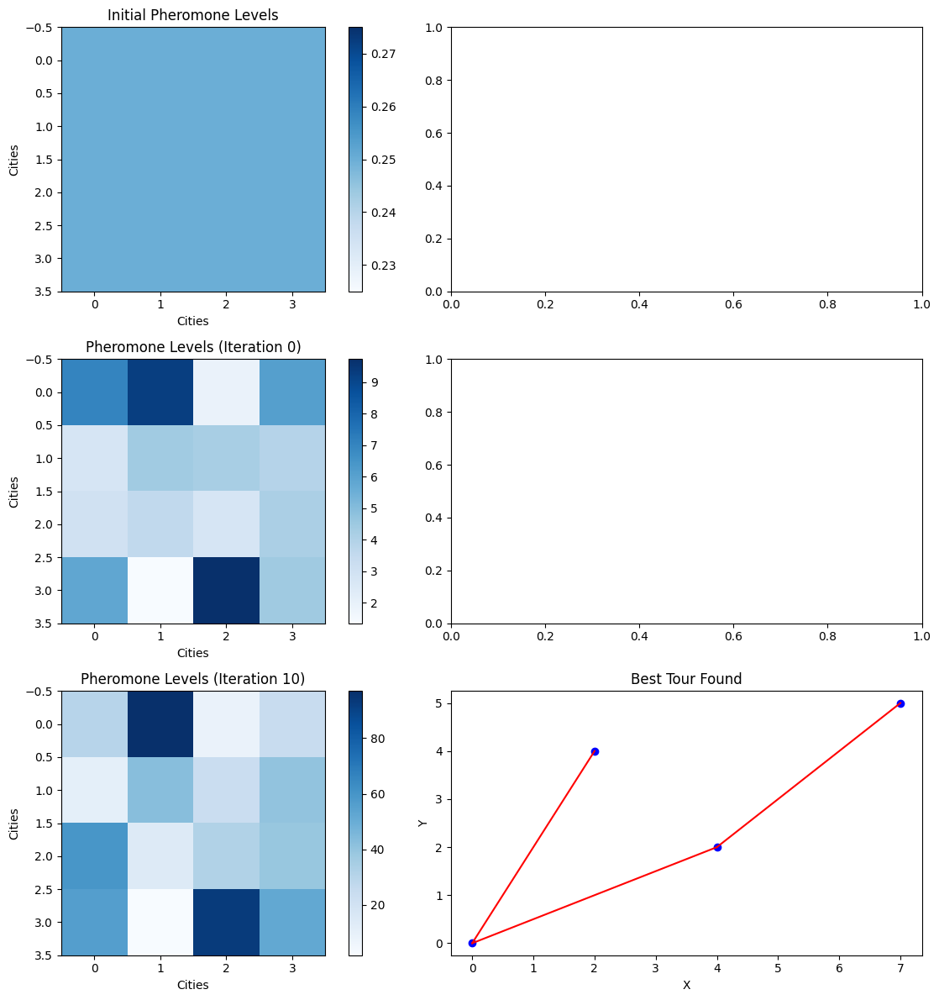

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
class AntColony:
    def __init__(self, distances, n_ants, decay=0.95, alpha=1, beta=1):
        self.distances = distances
        self.pheromone = np.ones(self.distances.shape) / len(distances)
        self.all_inds = range(len(distances))
        self.n_ants = n_ants
        self.decay = decay
        self.alpha = alpha
        self.beta = beta
    def run(self, n_iterations):
        for _ in range(n_iterations):
            all_tours = self.gen_all_tours()
            self.spread_pheromone(all_tours, self.n_ants, self.distances)
    def spread_pheromone(self, all_tours, n_ants, distances):
        pheromone_to_spread = np.zeros(self.pheromone.shape)
        for tour in all_tours:
            tour_distance = self.get_tour_distance(tour, distances)
            for i in range(len(tour) - 1):
                pheromone_to_spread[tour[i][0]][tour[i][1]] += n_ants / tour_distance
            pheromone_to_spread[tour[-1][1]][tour[0][0]] += n_ants / tour_distance
        self.pheromone = self.pheromone * self.decay + pheromone_to_spread
    def gen_all_tours(self):
        all_tours = []
        for i in range(self.n_ants):
            tour = self.gen_single_tour()
            all_tours.append(tour)
        return all_tours
    def gen_single_tour(self):
        tour = []
        visited = set()
        current = np.random.randint(len(self.distances))
        visited.add(current)
        for _ in range(len(self.distances) - 1):
            indices = list(set(self.all_inds) - visited)
            if not indices:
                break
            values = [self.pheromone[current][i] ** self.alpha * (1.0 / self.distances[current][i]) ** self.beta for i in indices]
            norm_values = values / np.sum(values)
            next_city = np_choice(indices, p=norm_values)
            visited.add(next_city)
            tour.append((current, next_city))
            current = next_city
        tour.append((tour[-1][1], tour[0][0]))
        return tour
    def get_tour_distance(self, tour, distances):
        total_distance = 0
        for i in range(len(tour) - 1):
            total_distance += distances[tour[i][0]][tour[i][1]]
        return total_distance
def np_choice(a, p):
    if not a:
        return None
    return np.random.choice(a, p=p / np.sum(p))
def plot_tour(ax, tour, cities, title):
    ax.set_title(title)
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    for city in cities:
        ax.scatter(city[0], city[1], c='blue', marker='o')
    for i in range(len(tour) - 1):
        start_city = cities[tour[i][0]]
        end_city = cities[tour[i][1]]
        ax.plot([start_city[0], end_city[0]], [start_city[1], end_city[1]], c='red')
    start_city = cities[tour[-1][1]]
    end_city = cities[tour[0][0]]
    ax.plot([start_city[0], end_city[0]], [start_city[1], end_city[1]], c='red')
def plot_pheromone(ax, pheromone, title):
    ax.set_title(title)
    ax.imshow(pheromone, cmap='Blues', interpolation='nearest')
    ax.set_xlabel("Cities")
    ax.set_ylabel("Cities")
    plt.colorbar(ax.imshow(pheromone, cmap='Blues', interpolation='nearest'), ax=ax)
def visualize_aco(distances, n_ants, n_iterations, decay, alpha, beta):
    np.random.seed(42)
    cities = np.array([
        [0, 0],
        [2, 4],
        [4, 2],
        [7, 5]
    ])
    ant_colony = AntColony(distances, n_ants=n_ants, decay=decay, alpha=alpha, beta=beta)
    num_pheromone_rows = min(n_iterations // 10 + 1, 2)
    fig, axes = plt.subplots(nrows=num_pheromone_rows + 1, ncols=2, figsize=(12, 12))
    plot_pheromone(axes[0, 0], ant_colony.pheromone, "Initial Pheromone Levels")
    for iteration in range(n_iterations):
        all_tours = ant_colony.gen_all_tours()
        ant_colony.spread_pheromone(all_tours, ant_colony.n_ants, ant_colony.distances)
        if iteration % 10 == 0 and iteration // 10 < num_pheromone_rows:
            plot_pheromone(axes[iteration // 10 + 1, 0], ant_colony.pheromone, f"Pheromone Levels (Iteration {iteration})")
    best_tour = ant_colony.gen_single_tour()
    plot_tour(axes[-1, -1], best_tour, cities, "Best Tour Found")
    plt.tight_layout()
    plt.show()
if __name__ == "__main__":
    distances = np.array([
        [np.inf, 2, 3, 1],
        [2, np.inf, 4, 2],
        [3, 4, np.inf, 1],
        [1, 2, 1, np.inf]
    ])
    n_ants = 10
    n_iterations = 100
    decay = 0.95
    alpha = 1
    beta = 2
    visualize_aco(distances, n_ants, n_iterations, decay, alpha, beta)

In [ ]:
!apt install libgraphviz-dev

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common libgvc6-plugins-gtk
  librsvg2-common libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk librsvg2-common libxdot4
0 upgraded, 9 newly installed, 0 to remove and 32 not upgraded.
Need to get 2,433 kB of archives.
After this operation, 7,694 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-common all 2.24.33-2ubuntu2 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-0 amd64 2.24.33-2ubuntu2 [2,037 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgail18 amd64 2.24.33-2ubuntu2 [15.9 kB]
Get:4 http://archive.ubuntu.com/ubuntu jammy/main amd64

In [ ]:
!pip install pygraphviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.9/104.9 kB 1.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pygraphviz: filename=pygraphviz-1.12-cp310-cp310-linux_x86_64.whl size=168130 sha256=2d4f6b9ed609cc45ebfb9987cdbe8a405d20d2aa4b7bba61e03f6584a8efbabe
  Stored in directory: /root/.cache/pip/wheels/1d/ee/b5/a2f54f9e9b3951599c05dcce270ca85e472f8e6cec470e397a
Successfully built pygraphviz


In [ ]:
import pygraphviz as pgv
from PIL import Image
def visualize_aco(distances, n_ants, n_iterations, decay, alpha, beta):
    np.random.seed(42)
    ant_colony = AntColony(distances, n_ants=n_ants, decay=decay, alpha=alpha, beta=beta)
    graph = pgv.AGraph(directed=True)
    for i in range(len(distances)):
        graph.add_node(i)
    for iteration in range(n_iterations):
        all_tours = ant_colony.gen_all_tours()
        ant_colony.spread_pheromone(all_tours, ant_colony.n_ants, ant_colony.distances)
    best_tour = ant_colony.gen_single_tour()
    for edge in best_tour:
        graph.add_edge(edge[0], edge[1])
    graph.draw("graph.png", format="png", prog="neato")
    img = Image.open("graph.png")
    img.show()
if __name__ == "__main__":
    distances = np.array([
        [np.inf, 2, 3, 1],
        [2, np.inf, 4, 2],
        [3, 4, np.inf, 1],
        [1, 2, 1, np.inf]
    ])

    n_ants = 10
    n_iterations = 100
    decay = 0.95
    alpha = 1
    beta = 2
    visualize_aco(distances, n_ants, n_iterations, decay, alpha, beta)

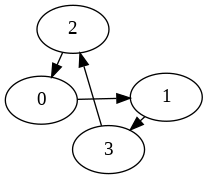

/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


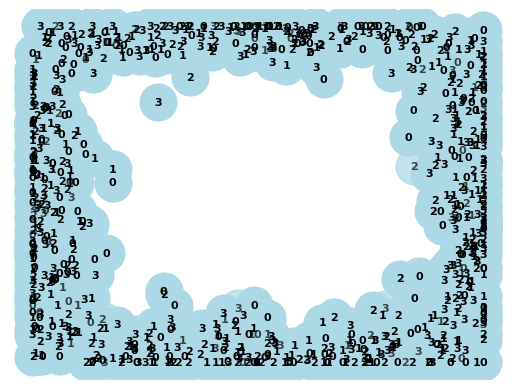

In [ ]:
import numpy as np
import pygraphviz as pgv
import networkx as nx
import matplotlib.pyplot as plt
class AntColony:
    def __init__(self, distances, n_ants, decay, alpha, beta):
        self.distances = distances
        self.pheromone = np.ones(self.distances.shape) / len(distances)
        self.all_inds = range(len(distances))
        self.n_ants = n_ants
        self.decay = decay
        self.alpha = alpha
        self.beta = beta
    def spread_pheromone(self, tours, distances):
        for tour in tours:
            for i in range(len(tour) - 1):
                city_from = int(tour[i][0])
                city_to = int(tour[i + 1][1])
                self.pheromone[city_from][city_to] += 1.0 / distances[city_from][city_to]
                self.pheromone[city_to][city_from] += 1.0 / distances[city_to][city_from]
    def gen_all_tours(self):
        all_tours = []
        for i in range(self.n_ants):
            tour = self.gen_single_tour()
            all_tours.append(tour)
        return all_tours
    def gen_single_tour(self):
        tour = []
        visited = set()
        visited.add(0)
        prev_city = 0
        for i in range(len(self.distances) - 1):
            probs = self.calculate_probs(prev_city, visited)
            next_city = np_choice(self.all_inds, p=probs)
            visited.add(next_city)
            tour.append((prev_city, next_city))
            prev_city = next_city
        tour.append((prev_city, 0))
        return tour
    def calculate_probs(self, prev_city, visited):
        pheromone = np.copy(self.pheromone[prev_city])
        pheromone[list(visited)] = 0
        row = self.distances[prev_city] ** -self.beta * pheromone ** self.alpha
        norm_row = row / row.sum()
        return norm_row
def np_choice(a, p):
    if not a:
        return None
    return np.random.choice(a, p=p / np.sum(p))
def visualize_aco(distances, n_ants, n_iterations, decay, alpha, beta):
    np.random.seed(42)
    ant_colony = AntColony(distances, n_ants=n_ants, decay=decay, alpha=alpha, beta=beta)
    graph = nx.Graph()
    for i in range(len(distances)):
        graph.add_node(i)
    fig, ax = plt.subplots()
    for iteration in range(n_iterations):
        all_tours = ant_colony.gen_all_tours()
        ant_colony.spread_pheromone(all_tours, distances)
        for tour in all_tours:
            edges = [(tour[i][0], tour[i][1]) for i in range(len(tour) - 1)]
            edge_colors = ['green' if edge in edges else 'black' for edge in graph.edges()]
            edge_widths = [2 if edge in edges else 0.5 for edge in graph.edges()]
            nx.draw(graph, with_labels=True, font_size=8, font_color='black', font_weight='bold',
                    node_size=700, node_color='lightblue', edge_color=edge_colors, width=edge_widths, ax=ax)
        pheromone_colors = [ant_colony.pheromone[edge[0]][edge[1]] for edge in graph.edges()]
        pheromone_colors = [min(1.0, color) for color in pheromone_colors]
        nx.draw(graph, with_labels=True, font_size=8, font_color='black', font_weight='bold',
                node_size=700, node_color='lightblue', edge_color=pheromone_colors, cmap=plt.cm.YlOrRd, width=2, alpha=0.7, ax=ax)
        plt.savefig(f"iteration_{iteration}.png")
    plt.show()

if __name__ == "__main__":
    distances = np.array([
        [np.inf, 2, 3, 1],
        [2, np.inf, 4, 2],
        [3, 4, np.inf, 1],
        [1, 2, 1, np.inf]
    ])
    n_ants = 10
    n_iterations = 20
    decay = 0.95
    alpha = 1
    beta = 2

    visualize_aco(distances, n_ants, n_iterations, decay, alpha, beta)

`iteration_0.png`

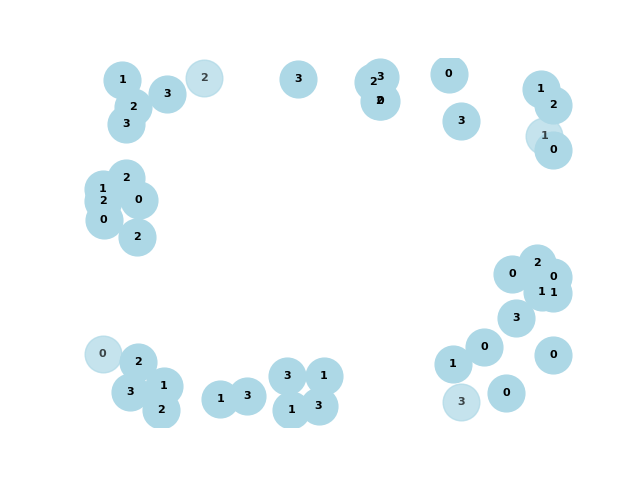

`iteration_1.png`

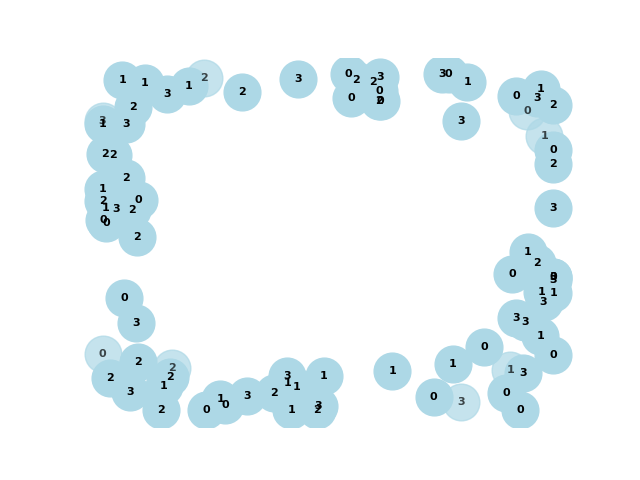

`iteration_2.png`

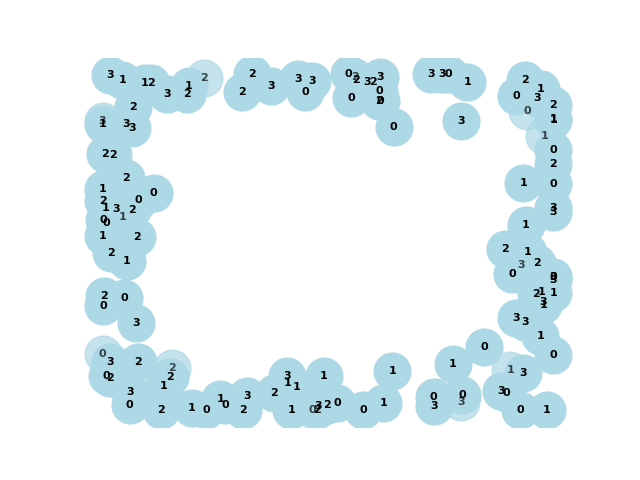

`iteration_3.png`

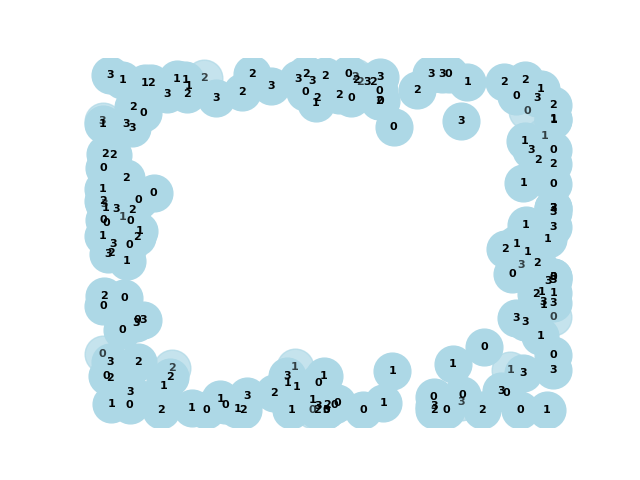

`iteration_4.png`

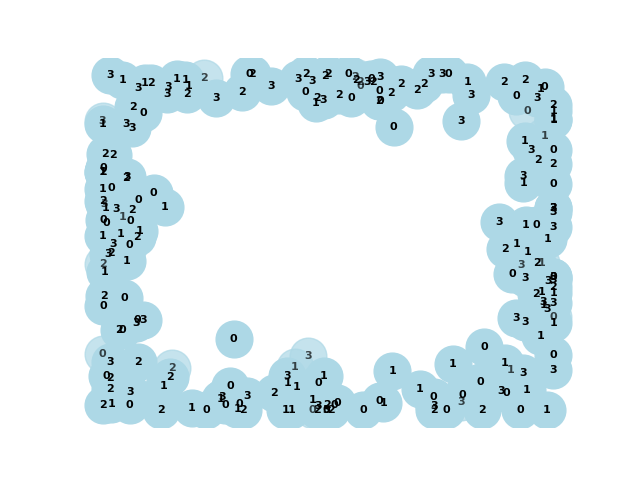

`iteration_5.png`

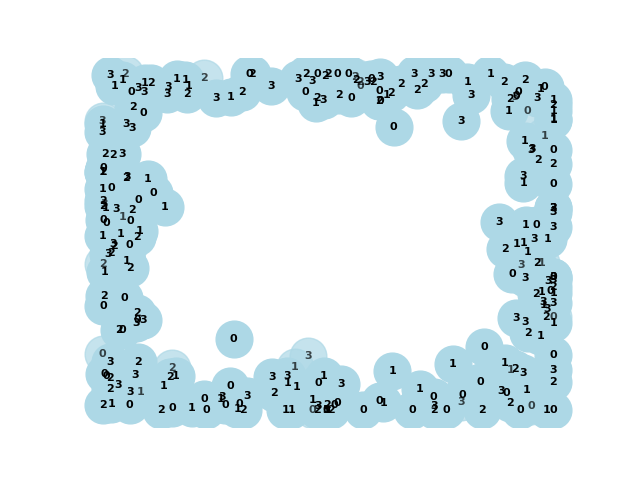

`iteration_6.png`

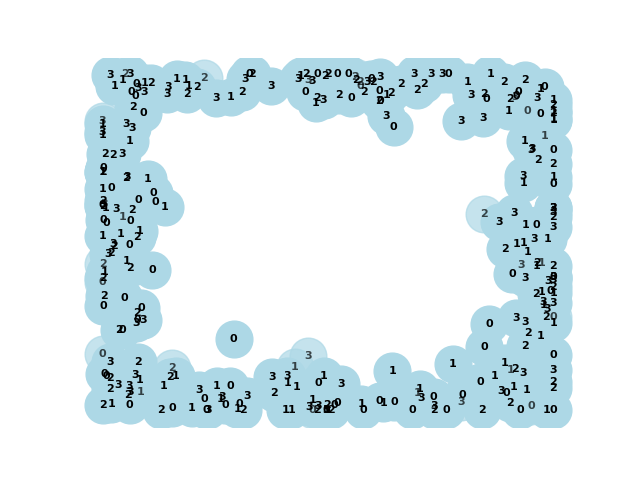

`iteration_7.png`

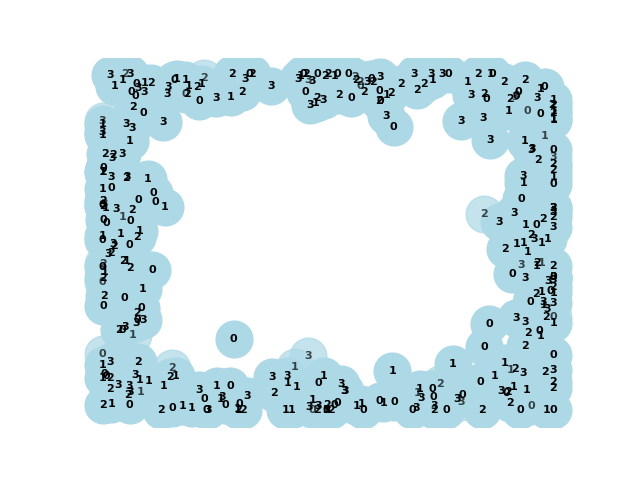

`iteration_8.png`

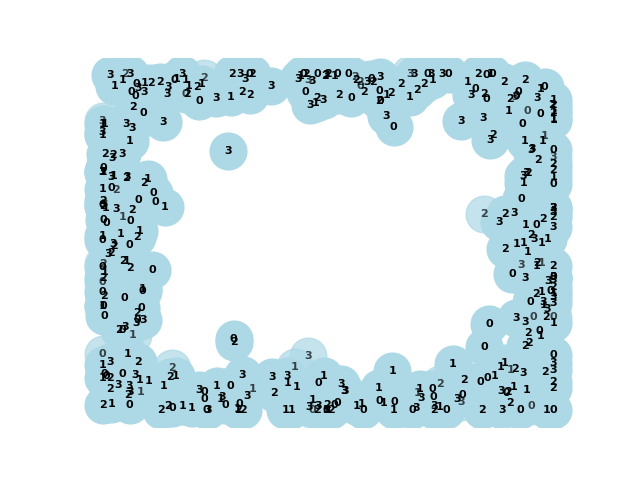

`iteration_9.png`

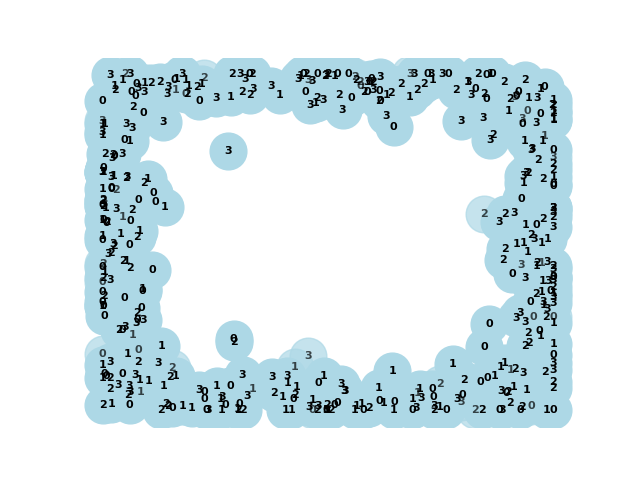

`iteration_10.png`

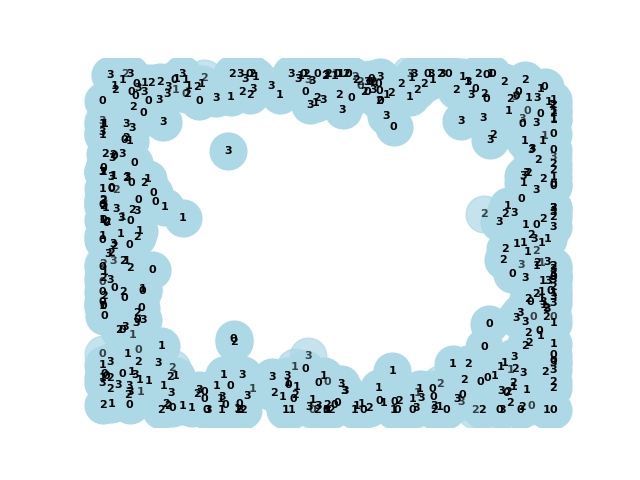

`iteration_11.png`

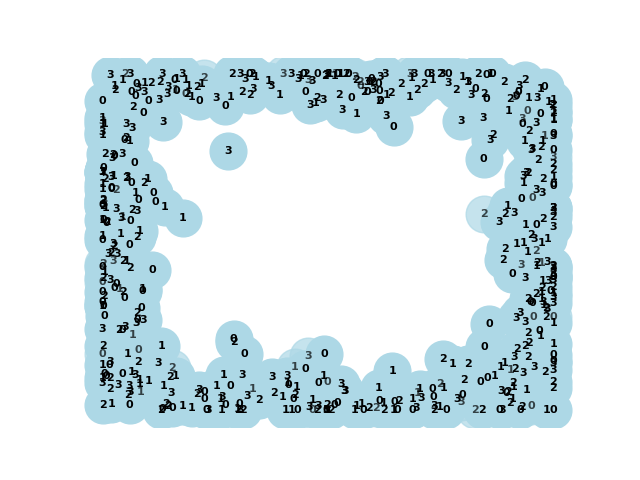

`iteration_12`

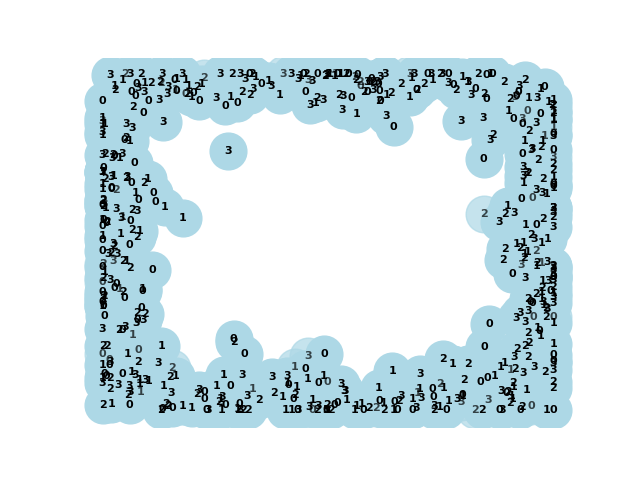

`iteration_13.png`

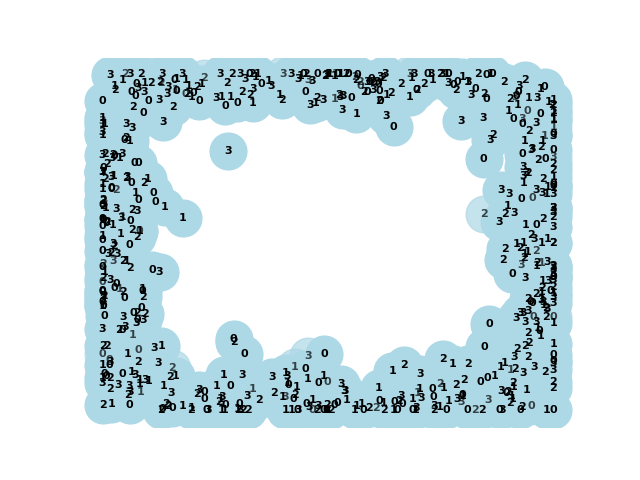

`iteration_14.png`

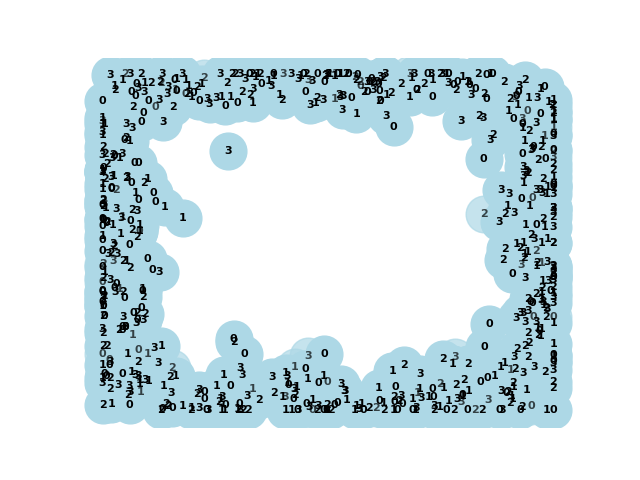

`iteration_15.png`

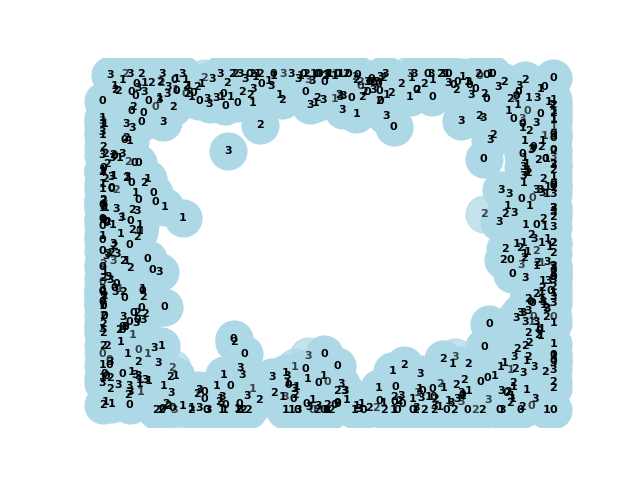

`iteration_16.png`

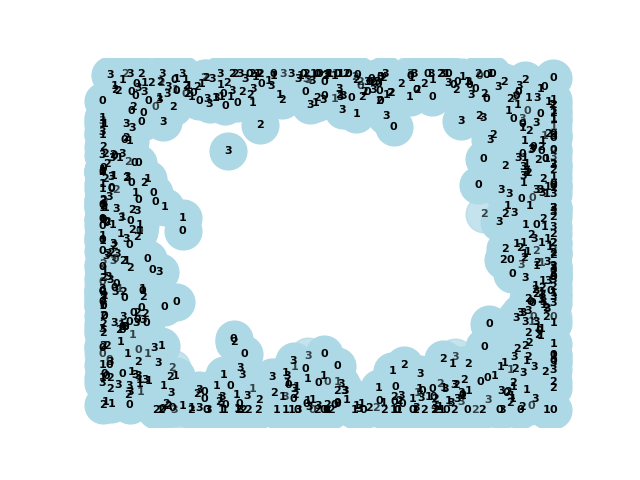

`iteration_17.png`

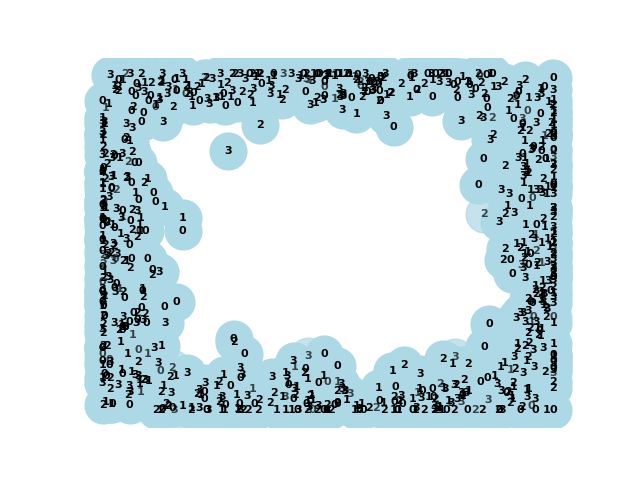

`iteration_19.png`

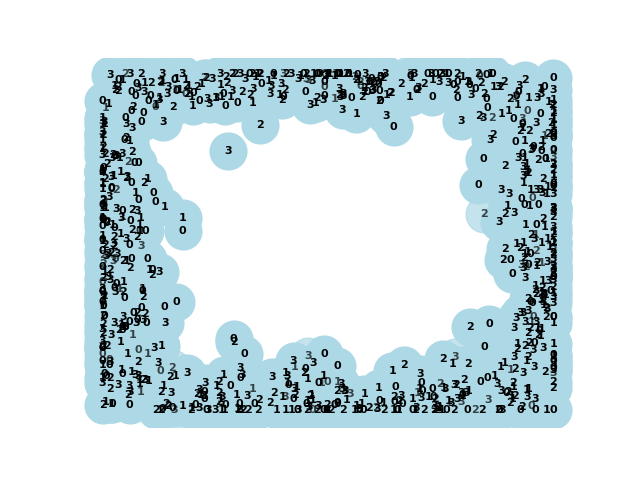

**`Job-Shop Scheduling Problem`**

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, n_ants, n_jobs, n_machines, pheromone_decay=0.1, alpha=1, beta=2):
        self.n_ants = n_ants
        self.n_jobs = n_jobs
        self.n_machines = n_machines
        self.pheromone_decay = pheromone_decay
        self.alpha = alpha
        self.beta = beta
        self.pheromone_matrix = np.ones((n_jobs, n_machines))
        self.heuristic_matrix = 1 / (1 + np.random.rand(n_jobs, n_machines))
        self.visibility_matrix = np.multiply(self.pheromone_matrix, self.heuristic_matrix)
        self.probability_matrix = self.visibility_matrix / np.sum(self.visibility_matrix, axis=1)[:, None]
    def run(self, max_iter):
        for iteration in range(max_iter):
            solutions = []
            for ant in range(self.n_ants):
                solution = self.construct_solution()
                solutions.append((self.calculate_cost(solution), solution))
            self.update_pheromone(solutions)
            best_solution = min(solutions, key=lambda x: x[0])
            print(f"\nIteration-{iteration + 1}: \nBest Cost = {best_solution[0]} \nBest Solution: \n{best_solution[1]}")
    def construct_solution(self):
        solution = np.zeros((self.n_jobs, self.n_machines), dtype=int)
        for job in range(self.n_jobs):
            selected_machine = self.choose_machine(job)
            solution[job][selected_machine] = 1
        return solution
    def choose_machine(self, job):
        probabilities = self.probability_matrix[job]
        return np.random.choice(range(self.n_machines), p=probabilities)
    def calculate_cost(self, solution):
        cost = 0
        for machine in range(self.n_machines):
            machine_times = [job for job in range(self.n_jobs) if solution[job][machine] == 1]
            if machine_times:
                cost += max(machine_times) + 1
        return cost
    def update_pheromone(self, solutions):
        pheromone_delta = np.zeros((self.n_jobs, self.n_machines))
        for cost, solution in solutions:
            for job in range(self.n_jobs):
                for machine in range(self.n_machines):
                    pheromone_delta[job][machine] += 1 / cost
        self.pheromone_matrix = (1 - self.pheromone_decay) * self.pheromone_matrix + pheromone_delta
n_ants = 5
n_jobs = 4
n_machines = 3
max_iter = 50
aco = AntColony(n_ants, n_jobs, n_machines)
aco.run(max_iter)


Iteration-1: 
Best Cost = 7 
Best Solution: 
[[0 0 1]
 [0 1 0]
 [1 0 0]
 [1 0 0]]

Iteration-2: 
Best Cost = 7 
Best Solution: 
[[1 0 0]
 [1 0 0]
 [0 0 1]
 [1 0 0]]

Iteration-3: 
Best Cost = 4 
Best Solution: 
[[0 0 1]
 [0 0 1]
 [0 0 1]
 [0 0 1]]

Iteration-4: 
Best Cost = 6 
Best Solution: 
[[0 1 0]
 [0 0 1]
 [0 1 0]
 [0 1 0]]

Iteration-5: 
Best Cost = 5 
Best Solution: 
[[1 0 0]
 [0 0 1]
 [0 0 1]
 [0 0 1]]

Iteration-6: 
Best Cost = 5 
Best Solution: 
[[0 0 1]
 [1 0 0]
 [1 0 0]
 [1 0 0]]

Iteration-7: 
Best Cost = 6 
Best Solution: 
[[0 1 0]
 [1 0 0]
 [0 1 0]
 [0 1 0]]

Iteration-8: 
Best Cost = 7 
Best Solution: 
[[1 0 0]
 [1 0 0]
 [1 0 0]
 [0 1 0]]

Iteration-9: 
Best Cost = 7 
Best Solution: 
[[0 0 1]
 [0 0 1]
 [0 0 1]
 [1 0 0]]

Iteration-10: 
Best Cost = 6 
Best Solution: 
[[0 0 1]
 [1 0 0]
 [0 0 1]
 [0 0 1]]

Iteration-11: 
Best Cost = 5 
Best Solution: 
[[1 0 0]
 [0 1 0]
 [0 1 0]
 [0 1 0]]

Iteration-12: 
Best Cost = 4 
Best Solution: 
[[1 0 0]
 [1 0 0]
 [1 0 0]
 [1 0 0]]



Iteration-1: Best Cost = 5


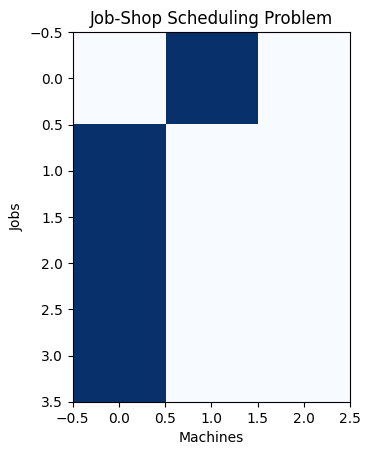

Iteration-2: Best Cost = 7


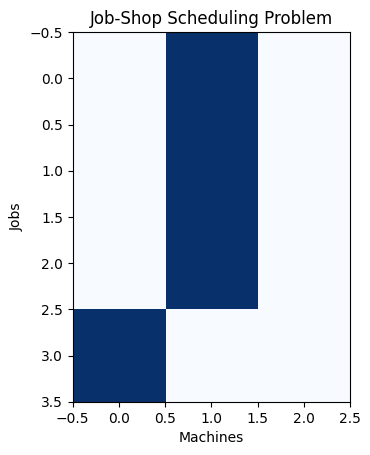

Iteration-3: Best Cost = 5


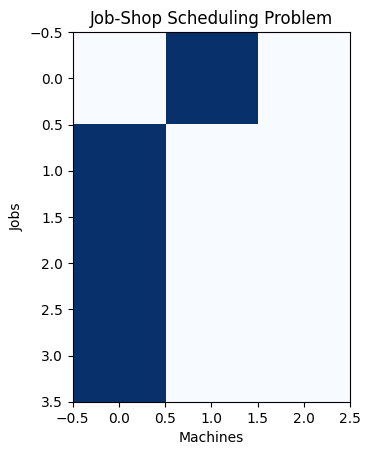

Iteration-4: Best Cost = 6


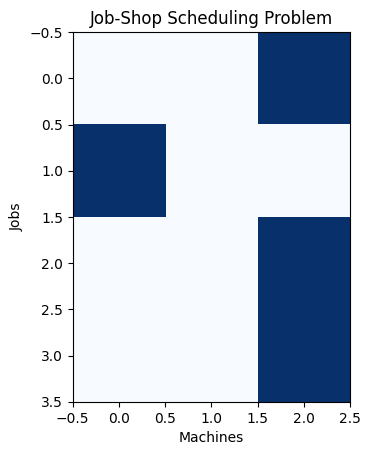

Iteration-5: Best Cost = 7


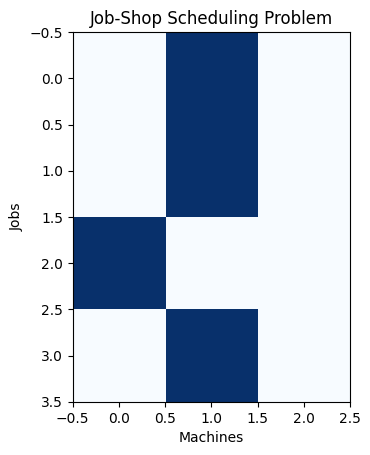

Iteration-6: Best Cost = 5


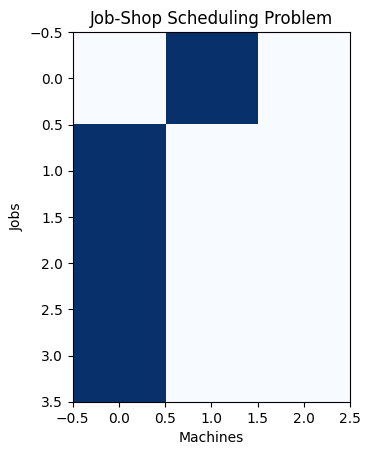

Iteration-7: Best Cost = 4


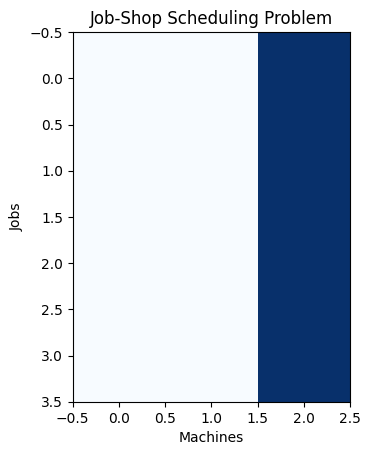

Iteration-8: Best Cost = 7


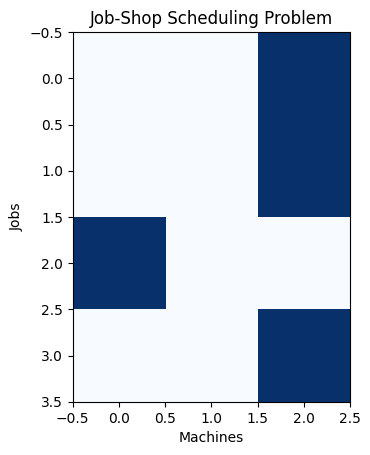

Iteration-9: Best Cost = 7


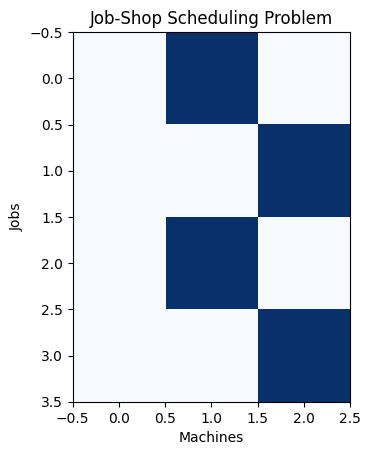

Iteration-10: Best Cost = 5


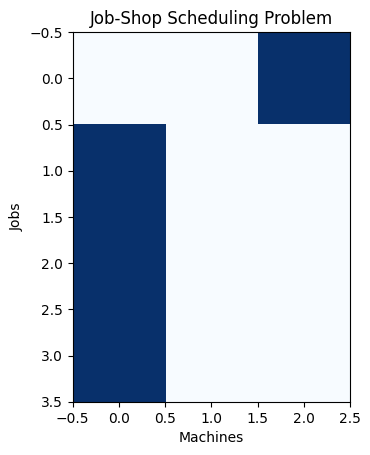

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
class AntColony:
    def __init__(self, n_ants, n_jobs, n_machines, pheromone_decay=0.1, alpha=1, beta=2):
        self.n_ants = n_ants
        self.n_jobs = n_jobs
        self.n_machines = n_machines
        self.pheromone_decay = pheromone_decay
        self.alpha = alpha
        self.beta = beta
        self.pheromone_matrix = np.ones((n_jobs, n_machines))
        self.heuristic_matrix = 1 / (1 + np.random.rand(n_jobs, n_machines))
        self.visibility_matrix = np.multiply(self.pheromone_matrix, self.heuristic_matrix)
        self.probability_matrix = self.visibility_matrix / np.sum(self.visibility_matrix, axis=1)[:, None]
    def run(self, max_iter):
        for iteration in range(max_iter):
            solutions = []
            for ant in range(self.n_ants):
                solution = self.construct_solution()
                solutions.append((self.calculate_cost(solution), solution))
            self.update_pheromone(solutions)
            best_solution = min(solutions, key=lambda x: x[0])
            print(f"Iteration-{iteration + 1}: Best Cost = {best_solution[0]}")
    def construct_solution(self):
        solution = np.zeros((self.n_jobs, self.n_machines), dtype=int)
        for job in range(self.n_jobs):
            selected_machine = self.choose_machine(job)
            solution[job][selected_machine] = 1
        return solution
    def choose_machine(self, job):
        probabilities = self.probability_matrix[job]
        return np.random.choice(range(self.n_machines), p=probabilities)
    def calculate_cost(self, solution):
        cost = 0
        for machine in range(self.n_machines):
            machine_times = [job for job in range(self.n_jobs) if solution[job][machine] == 1]
            if machine_times:
                cost += max(machine_times) + 1
        return cost
    def update_pheromone(self, solutions):
        pheromone_delta = np.zeros((self.n_jobs, self.n_machines))
        for cost, solution in solutions:
            for job in range(self.n_jobs):
                for machine in range(self.n_machines):
                    pheromone_delta[job][machine] += 1 / cost
        self.pheromone_matrix = (1 - self.pheromone_decay) * self.pheromone_matrix + pheromone_delta
    def visualize(self, solution):
        G = np.zeros((self.n_jobs, self.n_machines))
        for job in range(self.n_jobs):
            selected_machine = np.argmax(solution[job])
            G[job][selected_machine] = 1
        plt.imshow(G, cmap='Blues', interpolation='none')
        plt.title('Job-Shop Scheduling Problem')
        plt.xlabel('Machines')
        plt.ylabel('Jobs')
        plt.show()
    def run_visualization(self, max_iter):
        for iteration in range(max_iter):
            solutions = []
            for ant in range(self.n_ants):
                solution = self.construct_solution()
                solutions.append((self.calculate_cost(solution), solution))
            self.update_pheromone(solutions)
            best_solution = min(solutions, key=lambda x: x[0])
            print(f"Iteration-{iteration + 1}: Best Cost = {best_solution[0]}")
            self.visualize(best_solution[1])
n_ants = 5
n_jobs = 4
n_machines = 3
max_iter = 10
aco = AntColony(n_ants, n_jobs, n_machines)
aco.run_visualization(max_iter)

**`Open-Shop Scheduling Problem`**

In [ ]:
import numpy as np
class OpenShopACO:
    def __init__(self, num_ants, num_jobs, num_machines, alpha=1, beta=2, rho=0.5, q0=0.8, iterations=100):
        self.num_ants = num_ants
        self.num_jobs = num_jobs
        self.num_machines = num_machines
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q0 = q0
        self.iterations = iterations
        self.pheromone = np.ones((num_jobs, num_jobs, num_machines))
        self.heuristic_info = np.random.rand(num_jobs, num_machines)
    def run(self):
        for _ in range(self.iterations):
            solutions = self.generate_solutions()
            self.update_pheromone(solutions)
        best_solution = min(solutions, key=lambda x: self.calculate_total_time(x))
        return best_solution
    def generate_solutions(self):
        solutions = []
        for ant in range(self.num_ants):
            solution = self.construct_solution()
            solutions.append(solution)
        return solutions
    def construct_solution(self):
        solution = np.zeros((self.num_jobs, self.num_machines), dtype=int)
        for job in range(self.num_jobs):
            for machine in range(self.num_machines):
                if np.random.rand() < self.q0:
                    next_job = self.select_next_job_pseudo_greedy(job, solution)
                else:
                    next_job = self.select_next_job_probabilistic(job, solution)
                solution[job][machine] = next_job
        return solution
    def select_next_job_pseudo_greedy(self, current_job, solution):
        pheromone_values = self.pheromone[current_job, :, :]
        heuristic_values = self.heuristic_info[current_job, :]
        probabilities = pheromone_values ** self.alpha * heuristic_values ** self.beta
        return np.argmax(probabilities)
    def select_next_job_probabilistic(self, current_job, solution):
        pheromone_values = self.pheromone[current_job, :, :]
        heuristic_values = self.heuristic_info[current_job, :]
        probabilities = pheromone_values ** self.alpha * heuristic_values ** self.beta
        probabilities /= np.sum(probabilities)
        flattened_probabilities = probabilities.flatten()
        chosen_job = np.random.choice(range(self.num_jobs * self.num_machines), p=flattened_probabilities)
        return chosen_job % self.num_jobs
    def update_pheromone(self, solutions):
        for i in range(self.num_jobs):
            for j in range(self.num_jobs):
                for k in range(self.num_machines):
                    delta_pheromone = sum(self.calculate_delta_pheromone(solution, i, j, k) for solution in solutions)
                    self.pheromone[i][j][k] = (1 - self.rho) * self.pheromone[i][j][k] + delta_pheromone
    def calculate_delta_pheromone(self, solution, i, j, k):
        time_before = self.calculate_total_time(solution)
        solution[i][k], solution[j][k] = solution[j][k], solution[i][k]
        time_after = self.calculate_total_time(solution)
        return 1 / time_after - 1 / time_before
    def calculate_total_time(self, solution):
        total_time = 0
        for machine in range(self.num_machines):
            machine_time = sum(self.heuristic_info[job][machine] for job in range(self.num_jobs))
            total_time += machine_time
        return total_time
num_ants = 10
num_jobs = 3
num_machines = 3
aco = OpenShopACO(num_ants, num_jobs, num_machines)
best_solution = aco.run()
print("Best Solution =")
print(best_solution)
print("Total Time =", aco.calculate_total_time(best_solution))

Best Solution =
[[1 1 1]
 [0 2 0]
 [1 1 1]]
Total Time = 5.177876616590236


<ipython-input-58-9c15800610a7>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 5))


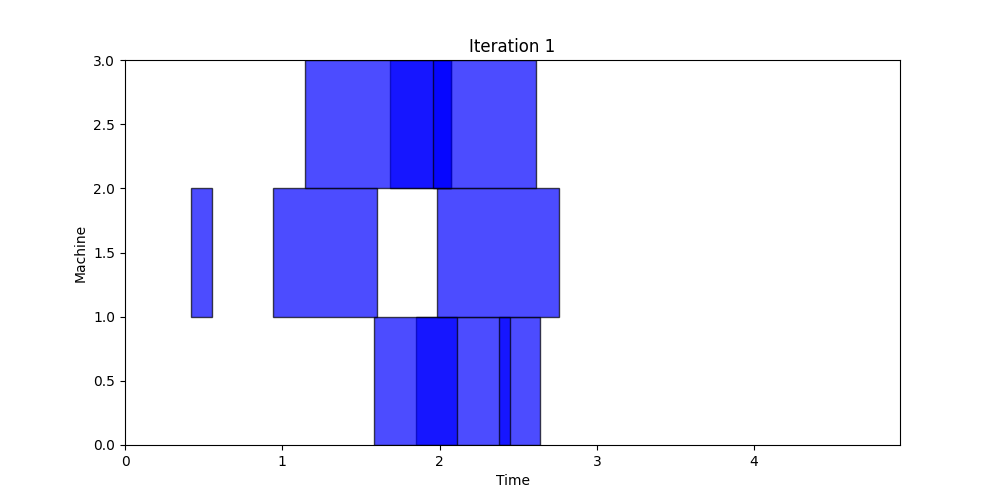

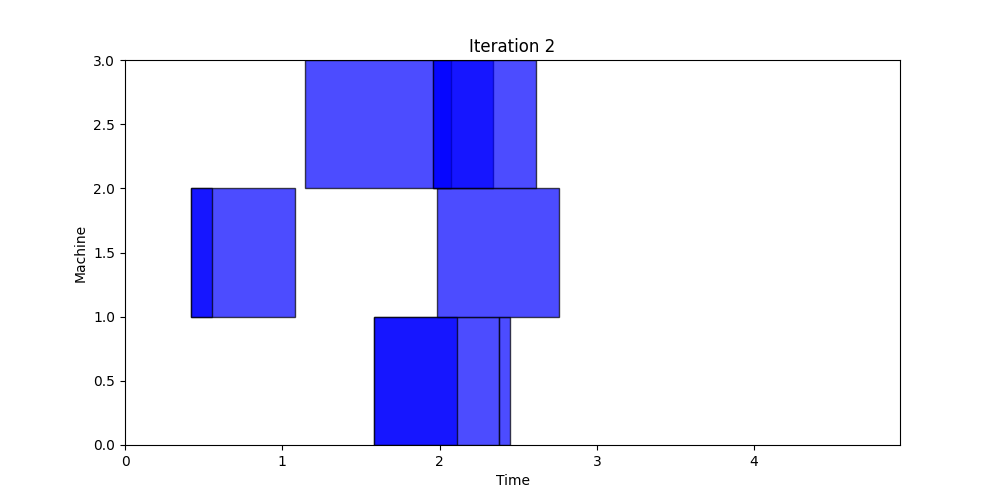

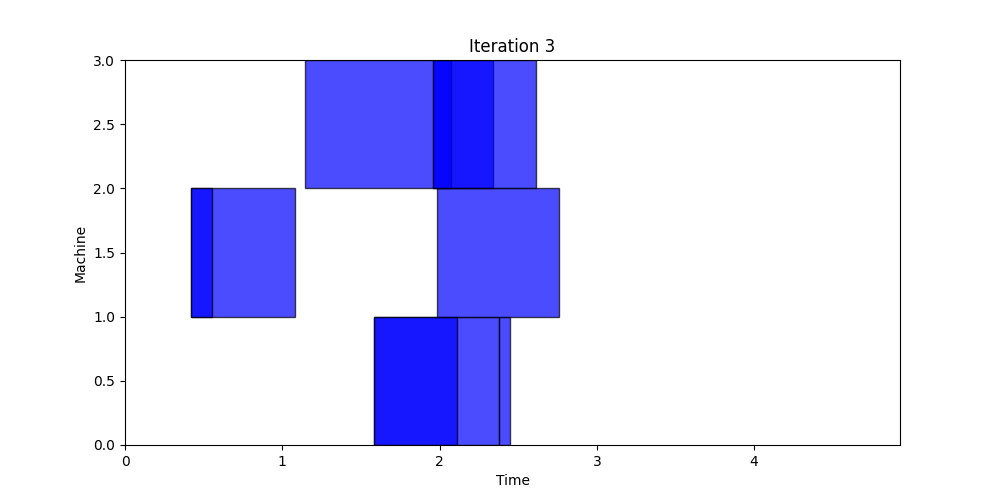

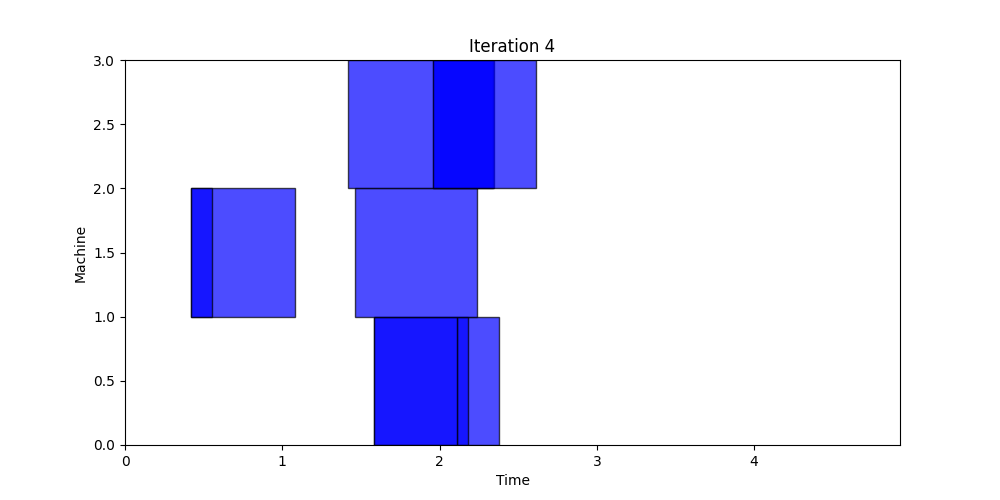

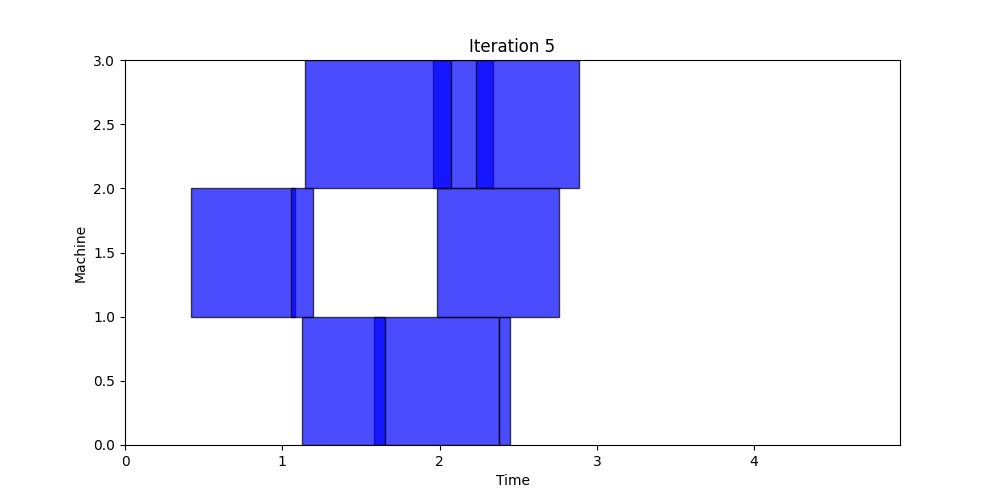

...

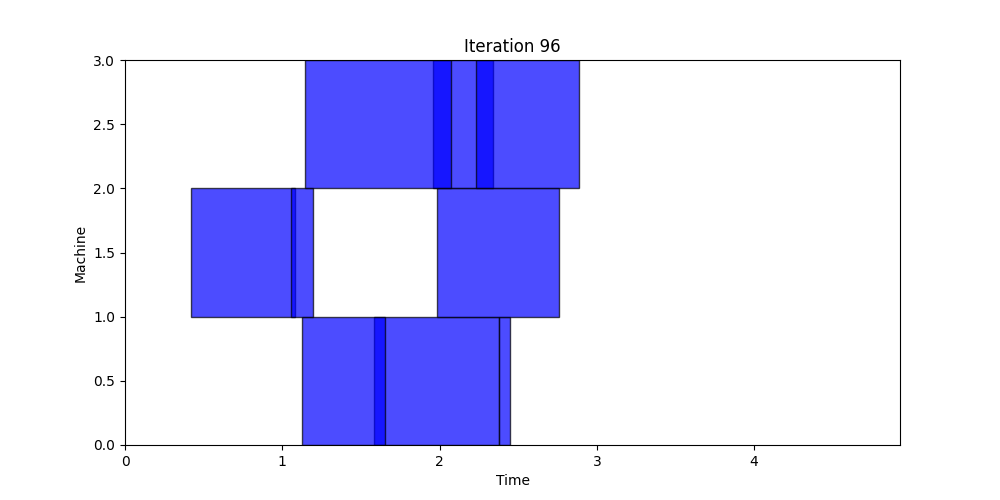

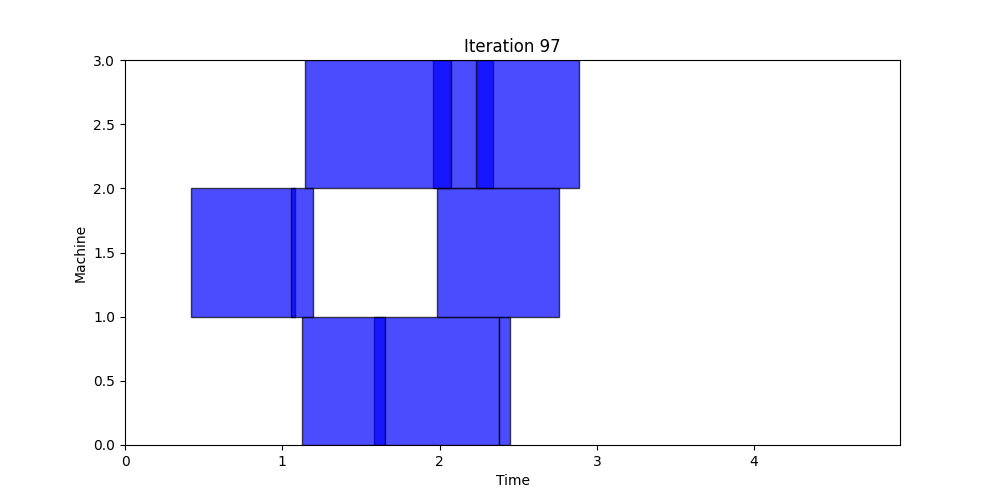

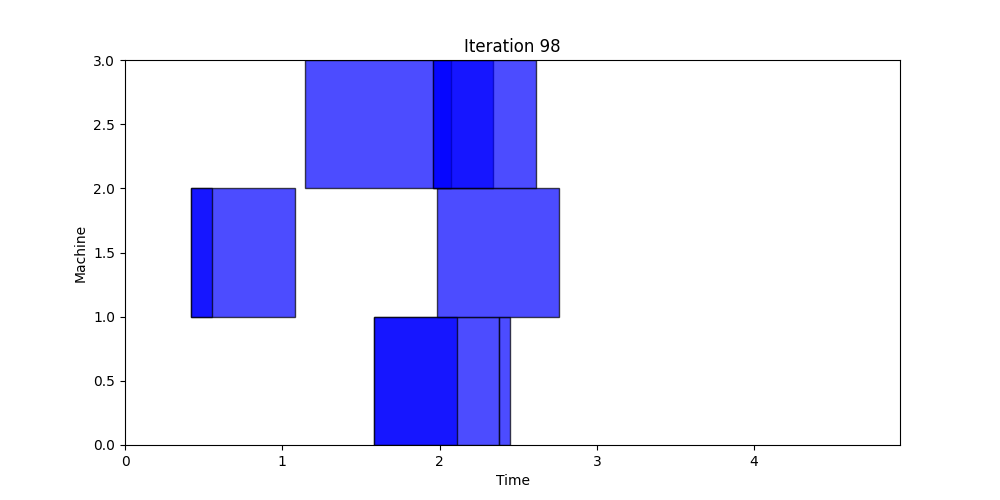

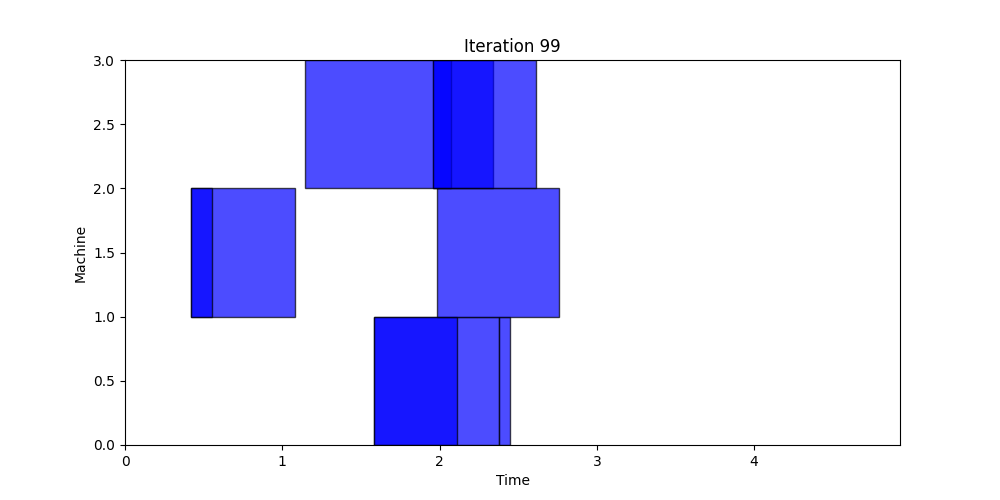

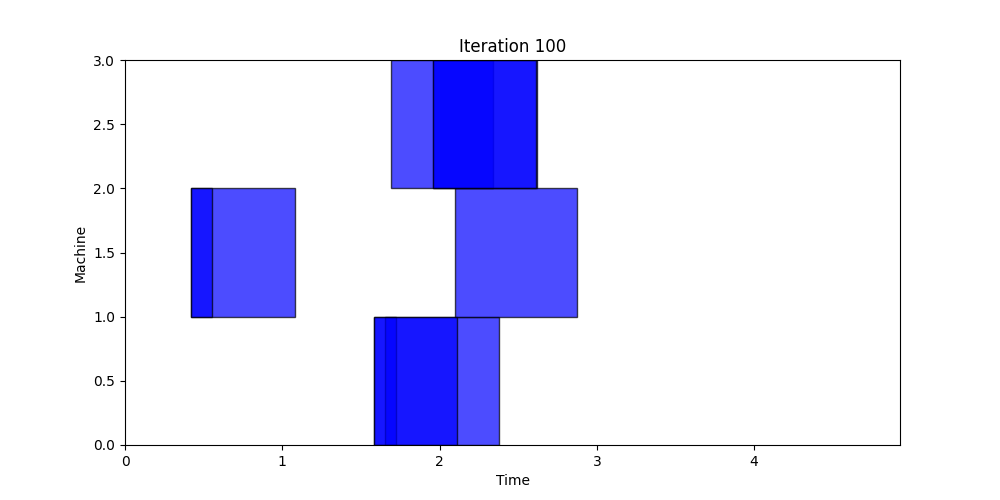

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from IPython.display import display, Image
class OpenShopACOVisualization(OpenShopACO):
    def __init__(self, num_ants, num_jobs, num_machines, alpha=1, beta=2, rho=0.5, q0=0.8, iterations=100):
        super().__init__(num_ants, num_jobs, num_machines, alpha, beta, rho, q0, iterations)
        self.iteration_gantt_charts = []
    def run_with_visualization(self):
        for iteration in range(self.iterations):
            solutions = self.generate_solutions()
            self.update_pheromone(solutions)
            best_solution = min(solutions, key=lambda x: self.calculate_total_time(x))
            self.iteration_gantt_charts.append(self.generate_gantt_chart(best_solution, iteration + 1))
        self.plot_gantt_charts()
    def generate_gantt_chart(self, solution, iteration):
        fig, ax = plt.subplots(figsize=(10, 5))
        for machine in range(self.num_machines):
            for job in range(self.num_jobs):
                start_time = sum(self.heuristic_info[solution[job][m]][machine] for m in range(self.num_machines))
                end_time = start_time + self.heuristic_info[job][machine]
                rect = Rectangle((start_time, machine), end_time - start_time, 1, linewidth=1, edgecolor='black', facecolor='blue', alpha=0.7)
                ax.add_patch(rect)
        ax.set_xlim([0, sum(self.heuristic_info[j][m] for j in range(self.num_jobs) for m in range(self.num_machines))])
        ax.set_ylim([0, self.num_machines])
        ax.set_xlabel('Time')
        ax.set_ylabel('Machine')
        ax.set_title(f'Iteration {iteration}')
        return fig
    def plot_gantt_charts(self):
        for i, gantt_chart in enumerate(self.iteration_gantt_charts):
            plt.figure(gantt_chart.number)
            plt.savefig(f'iteration_{i + 1}.png')
            plt.close()
            display(Image(filename=f'iteration_{i + 1}.png'))
num_ants = 10
num_jobs = 3
num_machines = 3
aco_visualization = OpenShopACOVisualization(num_ants, num_jobs, num_machines)
aco_visualization.run_with_visualization()

**`Permutation Flow Shop Problem`**

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, n_ants, n_jobs, n_machines, pheromone_init=0.1, alpha=1, beta=2, rho=0.1, q=1):
        self.n_ants = n_ants
        self.n_jobs = n_jobs
        self.n_machines = n_machines
        self.pheromone = np.ones((n_jobs, n_jobs)) * pheromone_init
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q = q
    def run(self, max_iter):
        best_solution = None
        best_makespan = float('inf')
        for _ in range(max_iter):
            solutions = self.generate_solutions()
            self.update_pheromone(solutions)
            current_solution = min(solutions, key=lambda x: self.calculate_makespan(x))
            current_makespan = self.calculate_makespan(current_solution)
            if current_makespan < best_makespan:
                best_solution = current_solution
                best_makespan = current_makespan
        return best_solution, best_makespan
    def generate_solutions(self):
        solutions = []
        for ant in range(self.n_ants):
            solution = self.construct_solution()
            solutions.append(solution)
        return solutions
    def construct_solution(self):
        solution = np.zeros((self.n_jobs, self.n_machines), dtype=int)
        for machine in range(self.n_machines):
            remaining_jobs = list(range(self.n_jobs))
            for ant in range(self.n_ants):
                next_job = self.select_next_job(remaining_jobs)
                if next_job is not None:
                    solution[next_job, machine] = 1
                    remaining_jobs.remove(next_job)
        return solution
    def select_next_job(self, remaining_jobs):
        if not remaining_jobs:
            return None
        pheromone_values = self.pheromone[remaining_jobs, :].sum(axis=1)
        heuristic_values = 1 / np.arange(1, len(remaining_jobs) + 1)
        probabilities = (pheromone_values ** self.alpha) * (heuristic_values ** self.beta)
        probabilities /= probabilities.sum()
        chosen_job = np.random.choice(remaining_jobs, p=probabilities)
        return chosen_job
    def update_pheromone(self, solutions):
        pheromone_delta = np.zeros((self.n_jobs, self.n_jobs))
        for solution in solutions:
            for machine in range(self.n_machines - 1):
                for job in range(self.n_jobs - 1):  # Fix here
                    job1, job2 = job, job + 1
                    pheromone_delta[job1, job2] += self.q / self.calculate_makespan(solution)
        self.pheromone = (1 - self.rho) * self.pheromone + pheromone_delta
    def calculate_makespan(self, solution):
        completion_times = np.zeros((self.n_jobs, self.n_machines))
        for machine in range(self.n_machines):
            for job in range(self.n_jobs):
                if machine == 0:
                    completion_times[job, machine] = processing_time[job, machine]
                else:
                    completion_times[job, machine] = max(
                        completion_times[job, machine - 1],
                        completion_times[job - 1, machine]
                    ) + processing_time[job, machine]

        return completion_times[-1, -1]
n_ants = 10
n_jobs = 5
n_machines = 3
processing_time = np.random.randint(1, 10, size=(n_jobs, n_machines))
aco = AntColony(n_ants, n_jobs, n_machines)
best_solution, best_makespan = aco.run(max_iter=100)
print("Best Solution =")
print(best_solution)
print("Best Makespan =", best_makespan)

Best Solution =
[[1 1 1]
 [1 1 1]
 [1 1 1]
 [1 1 1]
 [1 1 1]]
Best Makespan = 38.0


Best Solution =
[[1 1 1]
 [1 1 1]
 [1 1 1]
 [1 1 1]
 [1 1 1]]
Best Makespan = 41.0


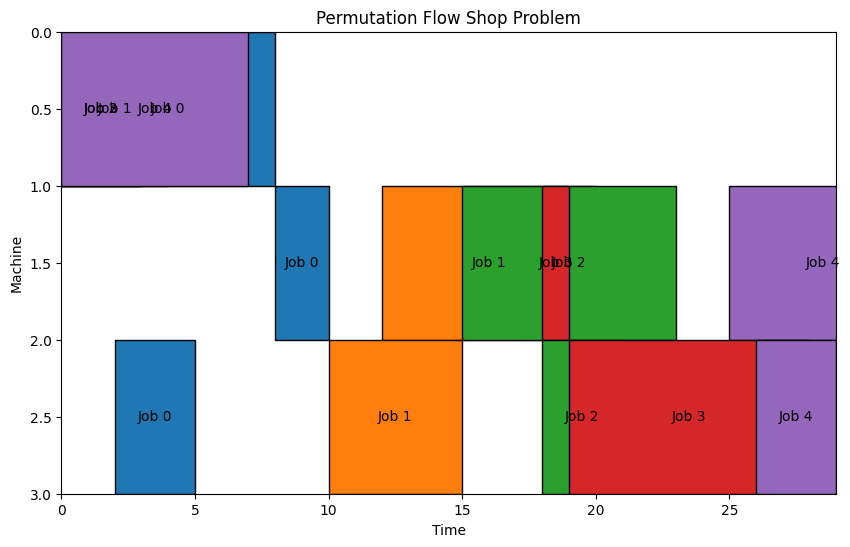

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
class AntColony:
    def __init__(self, n_ants, n_jobs, n_machines, pheromone_init=0.1, alpha=1, beta=2, rho=0.1, q=1):
        self.n_ants = n_ants
        self.n_jobs = n_jobs
        self.n_machines = n_machines
        self.pheromone = np.ones((n_jobs, n_jobs)) * pheromone_init
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q = q
    def run(self, max_iter):
        best_solution = None
        best_makespan = float('inf')
        for _ in range(max_iter):
            solutions = self.generate_solutions()
            self.update_pheromone(solutions)
            current_solution = min(solutions, key=lambda x: self.calculate_makespan(x))
            current_makespan = self.calculate_makespan(current_solution)
            if current_makespan < best_makespan:
                best_solution = current_solution
                best_makespan = current_makespan
        return best_solution, best_makespan
    def generate_solutions(self):
        solutions = []
        for ant in range(self.n_ants):
            solution = self.construct_solution()
            solutions.append(solution)
        return solutions
    def construct_solution(self):
        solution = np.zeros((self.n_jobs, self.n_machines), dtype=int)
        for machine in range(self.n_machines):
            remaining_jobs = list(range(self.n_jobs))
            for ant in range(self.n_ants):
                next_job = self.select_next_job(remaining_jobs)
                if next_job is not None:
                    solution[next_job, machine] = 1
                    remaining_jobs.remove(next_job)
        return solution
    def select_next_job(self, remaining_jobs):
        if not remaining_jobs:
            return None
        pheromone_values = self.pheromone[remaining_jobs, :].sum(axis=1)
        heuristic_values = 1 / np.arange(1, len(remaining_jobs) + 1)
        probabilities = (pheromone_values ** self.alpha) * (heuristic_values ** self.beta)
        probabilities /= probabilities.sum()
        chosen_job = np.random.choice(remaining_jobs, p=probabilities)
        return chosen_job
    def update_pheromone(self, solutions):
        pheromone_delta = np.zeros((self.n_jobs, self.n_jobs))
        for solution in solutions:
            for machine in range(self.n_machines - 1):
                for job in range(self.n_jobs - 1):
                    job1, job2 = job, job + 1
                    pheromone_delta[job1, job2] += self.q / self.calculate_makespan(solution)
        self.pheromone = (1 - self.rho) * self.pheromone + pheromone_delta
    def calculate_makespan(self, solution):
        completion_times = np.zeros((self.n_jobs, self.n_machines))
        for machine in range(self.n_machines):
            for job in range(self.n_jobs):
                if machine == 0:
                    completion_times[job, machine] = processing_time[job, machine]
                else:
                    completion_times[job, machine] = max(
                        completion_times[job, machine - 1],
                        completion_times[job - 1, machine]
                    ) + processing_time[job, machine]
        return completion_times[-1, -1]
def plot_gantt_chart(solution, processing_time):
    n_jobs, n_machines = solution.shape
    fig, ax = plt.subplots(figsize=(10, 6))
    for machine in range(n_machines):
        start_times = np.zeros(n_jobs)
        for job in range(n_jobs):
            if machine == 0:
                start_times[job] = 0
            else:
                start_times[job] = max(
                    start_times[job - 1],
                    start_times[job] if machine == 0 else start_times[job - 1]
                ) + processing_time[job, machine - 1]
        for job in range(n_jobs):
            rect = plt.Rectangle(
                (start_times[job], machine),
                processing_time[job, machine],
                1,
                edgecolor='black',
                facecolor='C' + str(job)
            )
            ax.add_patch(rect)
            plt.text(start_times[job] + processing_time[job, machine] / 2, machine + 0.5, f'Job {job}', ha='center', va='center')
    ax.set_xlim(0, np.max(start_times + processing_time[:, -1]))
    ax.set_ylim(0, n_machines)
    ax.invert_yaxis()
    plt.xlabel('Time')
    plt.ylabel('Machine')
    plt.title('Permutation Flow Shop Problem')
    plt.show()
n_ants = 10
n_jobs = 5
n_machines = 3
processing_time = np.random.randint(1, 10, size=(n_jobs, n_machines))
aco = AntColony(n_ants, n_jobs, n_machines)
best_solution, best_makespan = aco.run(max_iter=100)
print("Best Solution =")
print(best_solution)
print("Best Makespan =", best_makespan)
plot_gantt_chart(best_solution, processing_time)

**`Single Machine Total Tardiness Problem`**

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, num_ants, num_jobs, pheromone_init=0.1, alpha=1, beta=2, rho=0.1, q=2):
        self.pheromone = np.full((num_jobs, num_jobs), pheromone_init)
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q = q
        self.num_ants = num_ants
        self.num_jobs = num_jobs
    def run(self, num_iterations, jobs):
        best_solution = None
        best_score = float('inf')
        for iteration in range(num_iterations):
            solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution(jobs)
                solutions.append((solution, self.calculate_score(solution, jobs)))
            self.update_pheromone(solutions)
            current_best_solution, current_best_score = min(solutions, key=lambda x: x[1])
            if current_best_score < best_score:
                best_solution = current_best_solution
                best_score = current_best_score
            self.pheromone *= (1 - self.rho)
        return best_solution, best_score
    def construct_solution(self, jobs):
        solution = []
        remaining_jobs = list(range(self.num_jobs))
        while remaining_jobs:
            probabilities = self.calculate_probabilities(remaining_jobs, solution, jobs)
            selected_job = np.random.choice(remaining_jobs, p=probabilities)
            solution.append(selected_job)
            remaining_jobs.remove(selected_job)
        return solution
    def calculate_probabilities(self, remaining_jobs, solution, jobs):
        pheromone_values = [self.pheromone[solution[-1] if solution else 0][j] for j in remaining_jobs]
        heuristic_values = [1 / jobs[j] for j in remaining_jobs]
        total_values = np.power(pheromone_values, self.alpha) * np.power(heuristic_values, self.beta)
        probabilities = total_values / sum(total_values)
        return probabilities
    def calculate_score(self, solution, jobs):
        score = 0
        completion_time = 0
        for job in solution:
            completion_time += jobs[job]
            score += max(0, completion_time - jobs[job])
        return score
    def update_pheromone(self, solutions):
        delta_pheromone = np.zeros_like(self.pheromone)
        for solution, score in solutions:
            for i in range(self.num_jobs - 1):
                delta_pheromone[solution[i]][solution[i + 1]] += self.q / score
        self.pheromone = (1 - self.rho) * self.pheromone + delta_pheromone
num_jobs = 5
num_ants = 10
num_iterations = 100
jobs_processing_times = [2, 4, 1, 3, 5]
ant_colony = AntColony(num_ants, num_jobs)
best_solution, best_score = ant_colony.run(num_iterations, jobs_processing_times)
print("Best solution =", best_solution)
print("Best score =", best_score)

Best solution = [2, 0, 3, 1, 4]
Best score = 20


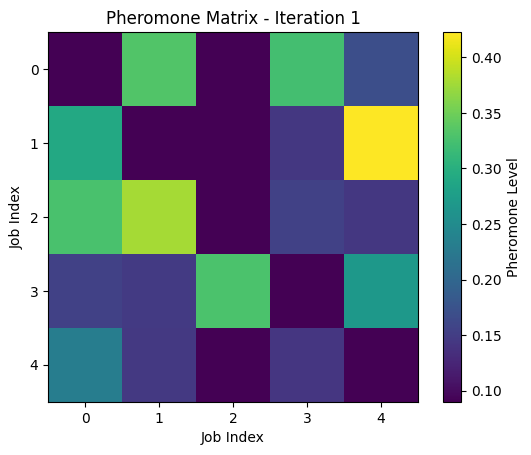

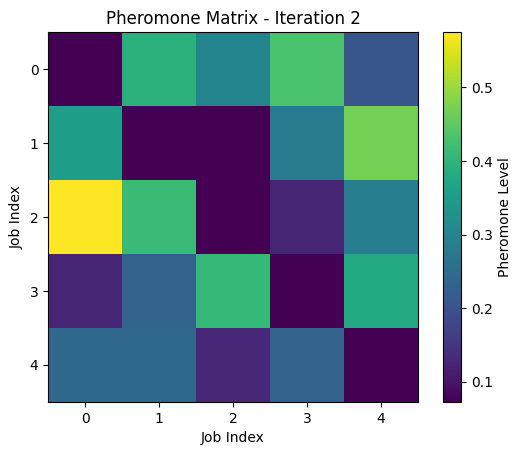

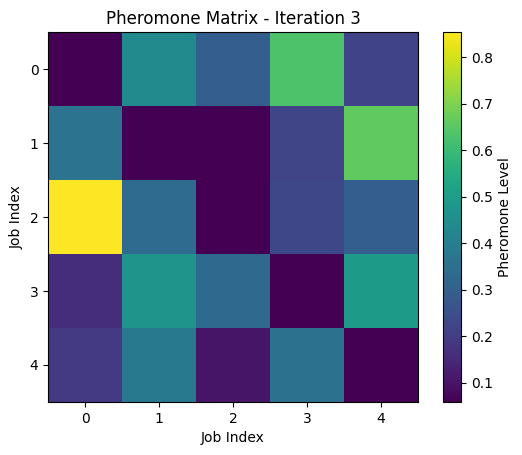

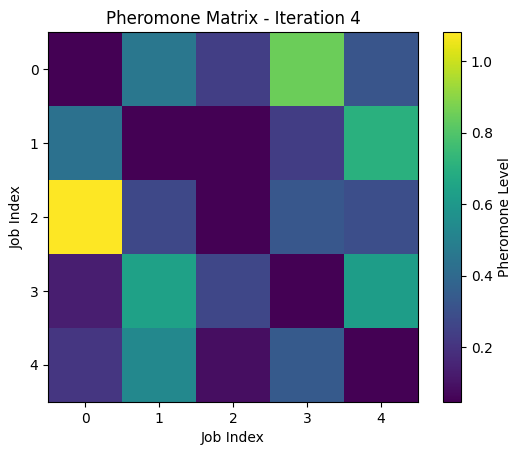

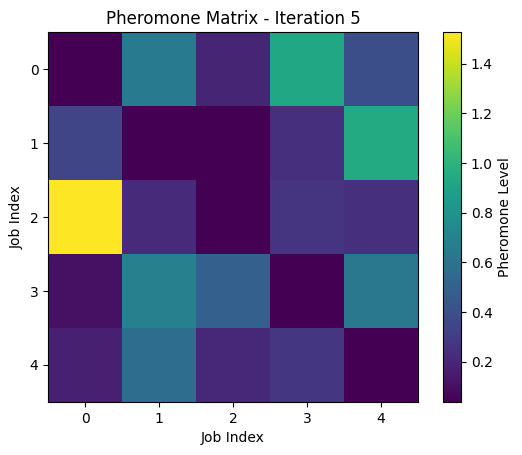

...

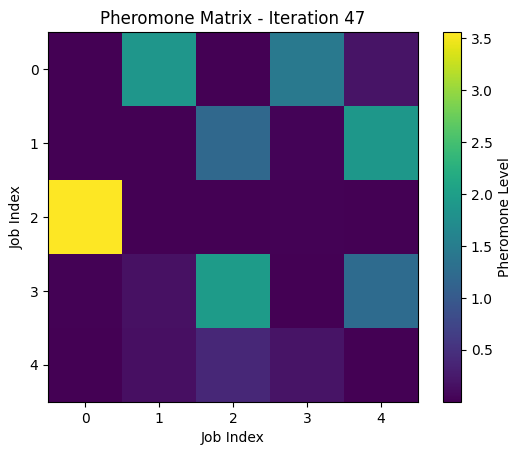

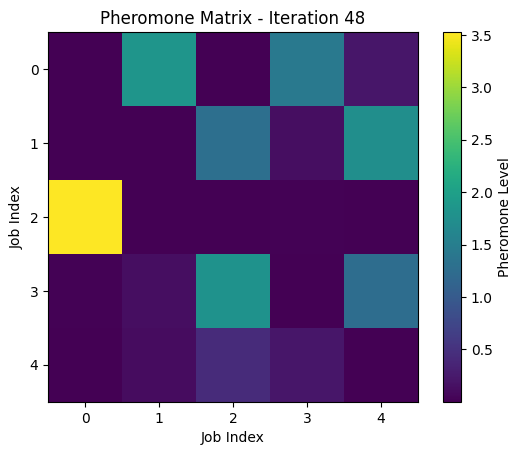

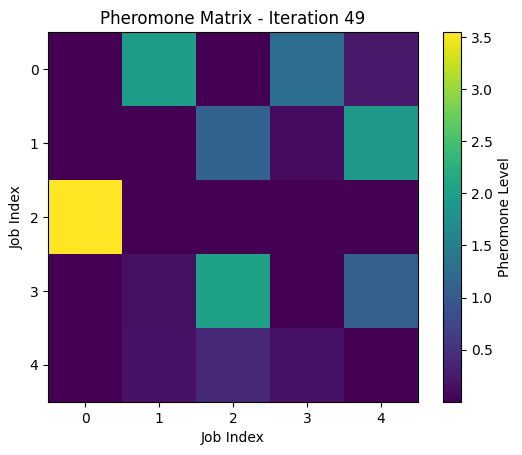

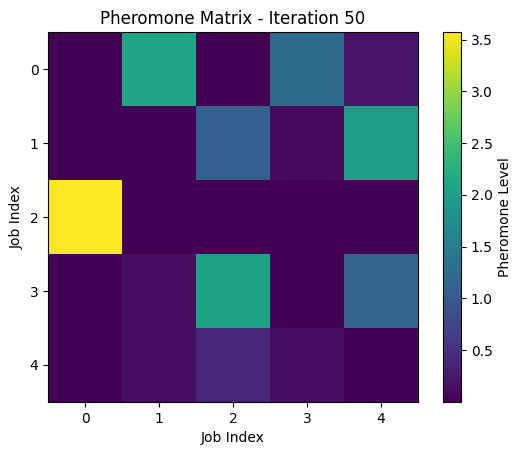

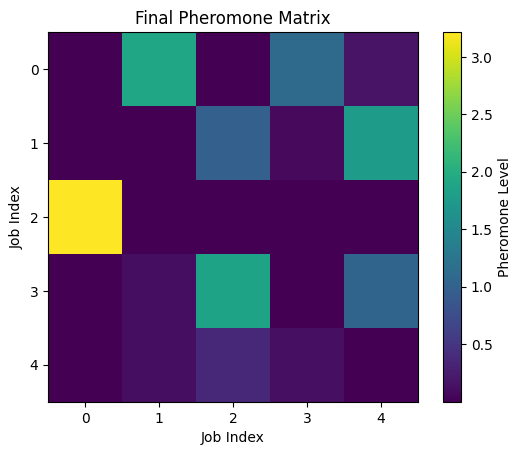

Best solution = [3, 4, 1, 2, 0]
Best score = 21


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
class AntColony:
    def __init__(self, num_ants, num_jobs, pheromone_init=0.1, alpha=1, beta=2, rho=0.1, q=2):
        self.pheromone = np.full((num_jobs, num_jobs), pheromone_init)
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q = q
        self.num_ants = num_ants
        self.num_jobs = num_jobs
    def run(self, num_iterations, jobs):
        best_solution = None
        best_score = float('inf')
        pheromone_evolution = []
        for iteration in range(num_iterations):
            solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution(jobs)
                solutions.append((solution, self.calculate_score(solution, jobs)))
            self.update_pheromone(solutions)
            pheromone_evolution.append(np.copy(self.pheromone))
            current_best_solution, current_best_score = min(solutions, key=lambda x: x[1])
            if current_best_score < best_score:
                best_solution = current_best_solution
                best_score = current_best_score
            self.pheromone *= (1 - self.rho)
        return best_solution, best_score, pheromone_evolution
    def construct_solution(self, jobs):
        solution = []
        remaining_jobs = list(range(self.num_jobs))
        while remaining_jobs:
            probabilities = self.calculate_probabilities(remaining_jobs, solution, jobs)
            selected_job = np.random.choice(remaining_jobs, p=probabilities)
            solution.append(selected_job)
            remaining_jobs.remove(selected_job)
        return solution
    def calculate_probabilities(self, remaining_jobs, solution, jobs):
        pheromone_values = [self.pheromone[solution[-1]][j] for j in remaining_jobs] if solution else [self.pheromone[0][j] for j in remaining_jobs]
        heuristic_values = [1 / jobs[j] for j in remaining_jobs]
        total_values = np.power(pheromone_values, self.alpha) * np.power(heuristic_values, self.beta)
        probabilities = total_values / sum(total_values)
        return probabilities
    def calculate_score(self, solution, jobs):
        score = 0
        completion_time = 0
        for job in solution:
            completion_time += jobs[job - 1]
            score += max(0, completion_time - jobs[job - 1])
        return score
    def update_pheromone(self, solutions):
        delta_pheromone = np.zeros_like(self.pheromone)
        for solution, score in solutions:
            for i in range(self.num_jobs - 1):
                delta_pheromone[solution[i]][solution[i + 1]] += self.q / score
        self.pheromone = (1 - self.rho) * self.pheromone + delta_pheromone
def plot_pheromone_matrix(pheromone_matrix, title):
    plt.imshow(pheromone_matrix, cmap='viridis', interpolation='nearest')
    plt.colorbar(label='Pheromone Level')
    plt.title(title)
    plt.xlabel('Job Index')
    plt.ylabel('Job Index')
    plt.show()
num_jobs = 5
num_ants = 10
num_iterations = 50
jobs_processing_times = [2, 4, 1, 3, 5]
ant_colony = AntColony(num_ants, num_jobs)
best_solution, best_score, pheromone_evolution = ant_colony.run(num_iterations, jobs_processing_times)
for i, pheromone_matrix in enumerate(pheromone_evolution):
    plot_pheromone_matrix(pheromone_matrix, f'Pheromone Matrix - Iteration {i+1}')
plot_pheromone_matrix(ant_colony.pheromone, 'Final Pheromone Matrix')
print("Best solution =", best_solution)
print("Best score =", best_score)

In [ ]:
pip install pygraphviz Pillow

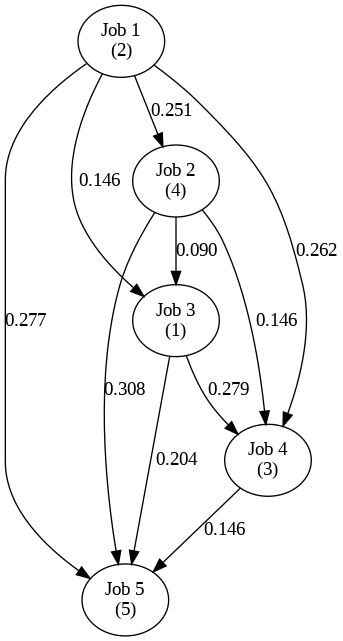

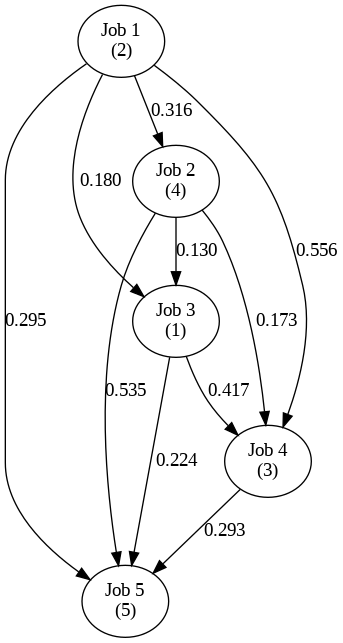

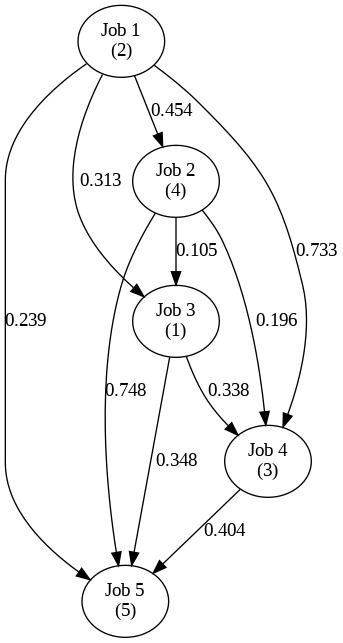

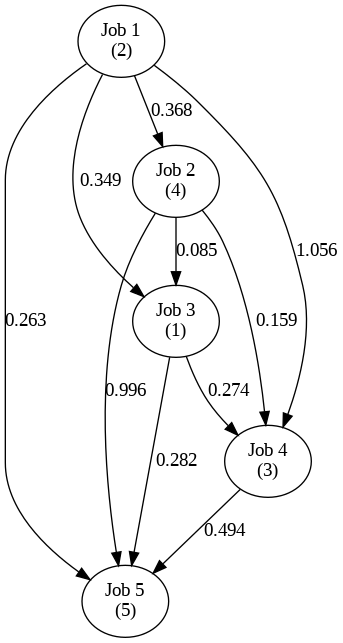

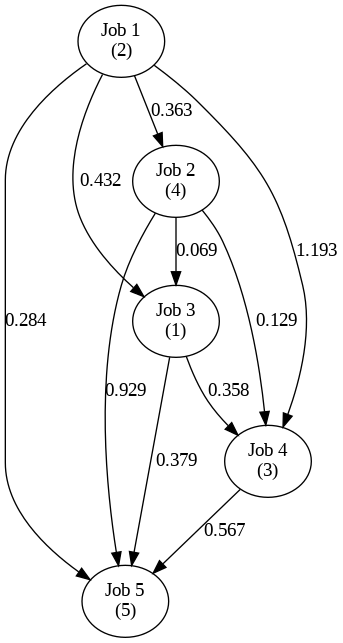

...

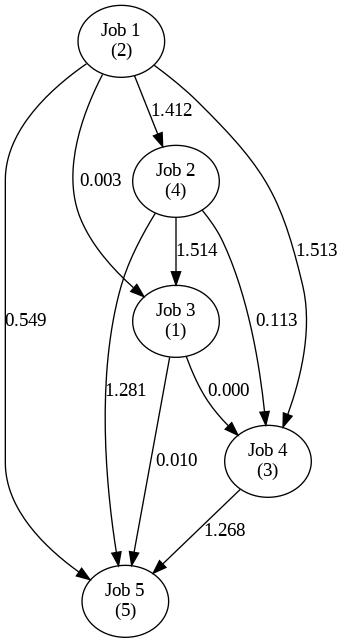

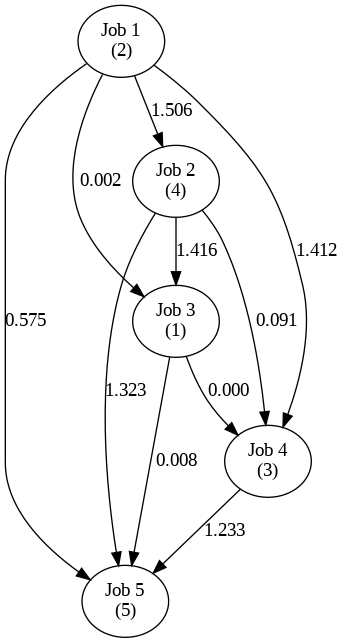

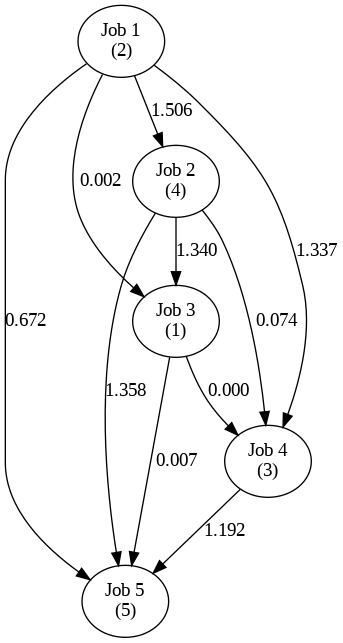

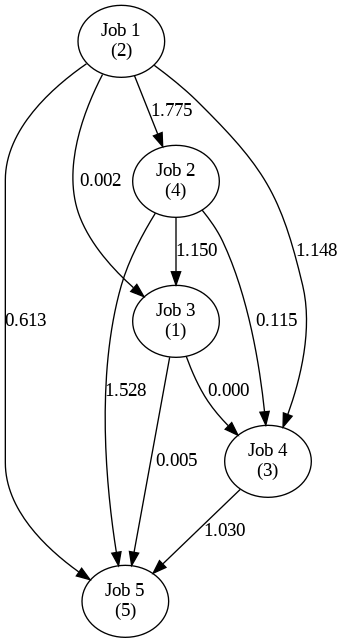

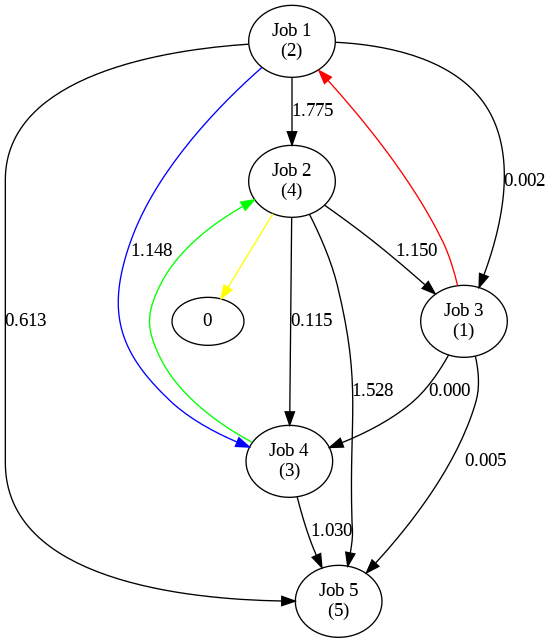

Best solution = [3, 1, 4, 2, 0]
Best score = 20


In [ ]:
import numpy as np
import pygraphviz as pgv
from IPython.display import Image, display
class AntColony:
    def __init__(self, num_ants, num_jobs, pheromone_init=0.1, alpha=1, beta=2, rho=0.1, q=2):
        self.pheromone = np.full((num_jobs, num_jobs), pheromone_init)
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q = q
        self.num_ants = num_ants
        self.num_jobs = num_jobs
    def run(self, num_iterations, jobs):
        best_solution = None
        best_score = float('inf')
        pheromone_evolution = []
        for iteration in range(num_iterations):
            solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution(jobs)
                solutions.append((solution, self.calculate_score(solution, jobs)))
            self.update_pheromone(solutions)
            pheromone_evolution.append(np.copy(self.pheromone))
            current_best_solution, current_best_score = min(solutions, key=lambda x: x[1])
            if current_best_score < best_score:
                best_solution = current_best_solution
                best_score = current_best_score
            self.pheromone *= (1 - self.rho)
        return best_solution, best_score, pheromone_evolution
    def construct_solution(self, jobs):
        solution = []
        remaining_jobs = list(range(self.num_jobs))
        while remaining_jobs:
            probabilities = self.calculate_probabilities(remaining_jobs, solution, jobs)
            selected_job = np.random.choice(remaining_jobs, p=probabilities)
            solution.append(selected_job)
            remaining_jobs.remove(selected_job)
        return solution
    def calculate_probabilities(self, remaining_jobs, solution, jobs):
        pheromone_values = [self.pheromone[solution[-1]][j] for j in remaining_jobs] if solution else [self.pheromone[0][j] for j in remaining_jobs]
        heuristic_values = [1 / jobs[j] for j in remaining_jobs]
        total_values = np.power(pheromone_values, self.alpha) * np.power(heuristic_values, self.beta)
        probabilities = total_values / sum(total_values)
        return probabilities
    def calculate_score(self, solution, jobs):
        score = 0
        completion_time = 0
        for job in solution:
            completion_time += jobs[job - 1]
            score += max(0, completion_time - jobs[job - 1])
        return score
    def update_pheromone(self, solutions):
        delta_pheromone = np.zeros_like(self.pheromone)
        for solution, score in solutions:
            for i in range(self.num_jobs - 1):
                delta_pheromone[solution[i]][solution[i + 1]] += self.q / score
        self.pheromone = (1 - self.rho) * self.pheromone + delta_pheromone
def visualize_solution(graph, solution):
    colors = ['red', 'blue', 'green', 'yellow', 'purple']
    for i in range(len(solution) - 1):
        job1, job2 = solution[i], solution[i + 1]
        if not graph.has_edge(job1, job2):
            graph.add_edge(job1, job2, label="")
        edge = graph.get_edge(job1, job2)
        edge.attr['color'] = colors[i % len(colors)]
def plot_graph(graph, output_file):
    graph.layout(prog='dot')
    graph.draw(output_file)
def display_image(file_path):
    img = Image(filename=file_path)
    display(img)
num_jobs = 5
num_ants = 10
num_iterations = 50
jobs_processing_times = [2, 4, 1, 3, 5]
ant_colony = AntColony(num_ants, num_jobs)
best_solution, best_score, pheromone_evolution = ant_colony.run(num_iterations, jobs_processing_times)
graph = pgv.AGraph(directed=True)
for i in range(1, num_jobs + 1):
    graph.add_node(i, label=f"Job {i}\n({jobs_processing_times[i-1]})")
for i in range(num_jobs):
    for j in range(i + 1, num_jobs):
        graph.add_edge(i + 1, j + 1, label=f"{ant_colony.pheromone[i][j]:.3f}")
for i, pheromone_matrix in enumerate(pheromone_evolution):
    for j in range(num_jobs):
        for k in range(j + 1, num_jobs):
            edge = graph.get_edge(j + 1, k + 1)
            edge.attr['label'] = f"{pheromone_matrix[j][k]:.3f}"
    output_file = f'pheromone_iteration_{i+1}.png'
    plot_graph(graph, output_file)
    display_image(output_file)
visualize_solution(graph, best_solution)
output_file = 'SMTTP_ACO_Solution.png'
plot_graph(graph, output_file)
display_image(output_file)
print("Best solution =", best_solution)
print("Best score =", best_score)

**`Single Machine Total Weighted Tardiness Problem`**

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, num_ants, num_jobs, pheromone_decay, alpha=1, beta=2):
        self.num_ants = num_ants
        self.num_jobs = num_jobs
        self.pheromone_decay = pheromone_decay
        self.alpha = alpha
        self.beta = beta
        self.pheromone_matrix = np.ones((num_jobs, num_jobs))
    def run(self, num_iterations):
        for iteration in range(num_iterations):
            solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution()
                solutions.append((solution, self.calculate_total_weighted_tardiness(solution)))
            self.update_pheromones(solutions)
            self.pheromone_matrix *= (1 - self.pheromone_decay)
        best_solution = min(solutions, key=lambda x: x[1])
        return best_solution
    def construct_solution(self):
        solution = []
        remaining_jobs = list(range(self.num_jobs))
        while remaining_jobs:
            probabilities = self.calculate_probabilities(remaining_jobs)
            if len(probabilities) != len(remaining_jobs):
                probabilities = np.ones(len(remaining_jobs)) / len(remaining_jobs)
            if np.isnan(probabilities).any() or np.all(probabilities == 0):
                probabilities = np.ones(len(remaining_jobs)) / len(remaining_jobs)
            with np.errstate(divide='ignore', invalid='ignore'):
                selected_job_index = np.random.choice(np.arange(len(remaining_jobs)), p=probabilities)
            selected_job = remaining_jobs[selected_job_index]
            solution.append(selected_job)
            remaining_jobs.remove(selected_job)
        return solution
    def calculate_probabilities(self, remaining_jobs):
        total_pheromone = np.sum(self.pheromone_matrix[:, remaining_jobs] ** self.alpha)
        if total_pheromone == 0:
            return np.ones(len(remaining_jobs)) / len(remaining_jobs)
        heuristic_information = 1 / np.array(remaining_jobs, dtype=float)  # Simple heuristic
        probabilities = ((self.pheromone_matrix[:, remaining_jobs] ** self.alpha) / total_pheromone) * heuristic_information ** self.beta

        probabilities[np.isnan(probabilities) | (probabilities == 0)] = 1 / len(remaining_jobs)
        probabilities /= np.sum(probabilities)
        return probabilities
    def calculate_total_weighted_tardiness(self, solution):
        total_tardiness = 0
        current_time = 0
        for job in solution:
            current_time += processing_times[job]
            tardiness = max(current_time - due_dates[job], 0)
            total_tardiness += weights[job] * tardiness
        return total_tardiness
    def update_pheromones(self, solutions):
        evaporation = 0.1
        for solution, total_tardiness in solutions:
            pheromone_deposit = 1 / total_tardiness
            for i in range(self.num_jobs - 1):
                self.pheromone_matrix[solution[i], solution[i + 1]] += pheromone_deposit
num_ants = 10
num_jobs = 5
pheromone_decay = 0.1
num_iterations = 100
processing_times = [3, 5, 2, 7, 1]
due_dates = [10, 8, 6, 3, 5]
weights = [1, 2, 3, 1, 2]
ant_colony = AntColony(num_ants, num_jobs, pheromone_decay)
best_solution = ant_colony.run(num_iterations)
print("Best Solution =", best_solution)

<ipython-input-102-91b137da1166>:39: RuntimeWarning: divide by zero encountered in divide
  heuristic_information = 1 / np.array(remaining_jobs, dtype=float)  # Simple heuristic
<ipython-input-102-91b137da1166>:43: RuntimeWarning: invalid value encountered in divide
  probabilities /= np.sum(probabilities)


Best Solution = ([1, 2, 4, 3, 0], 29)


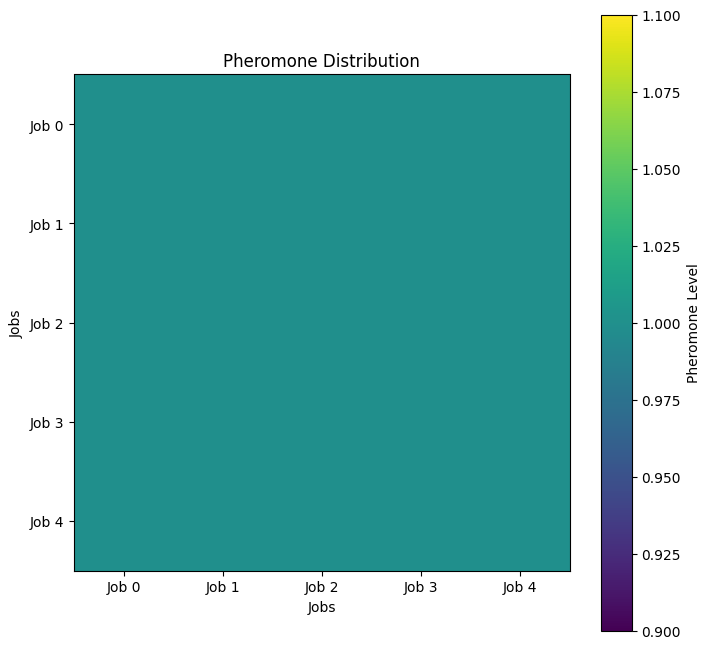

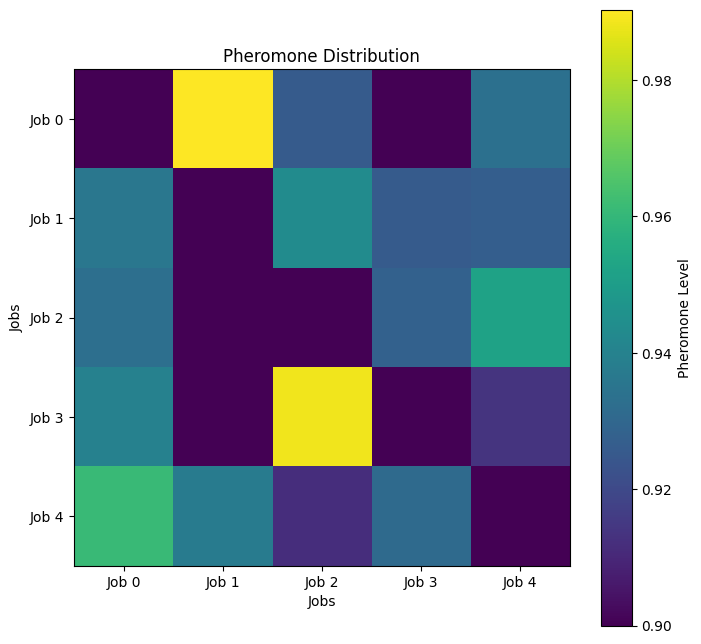

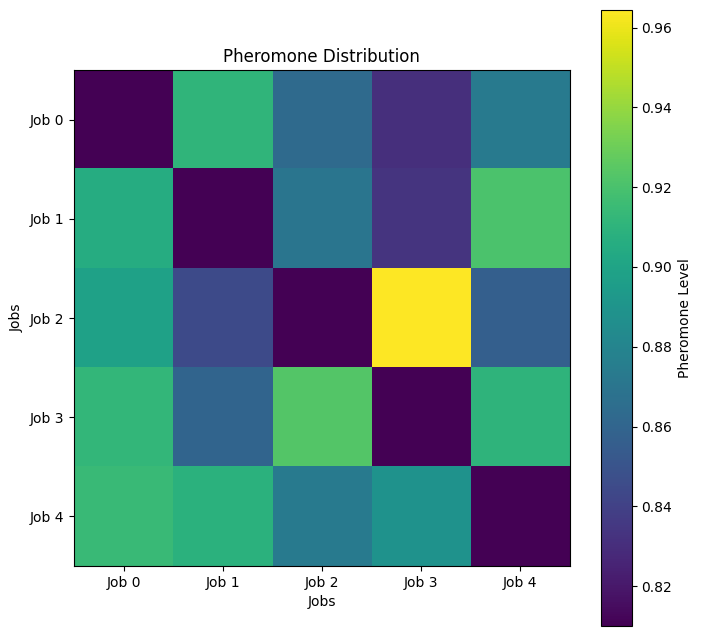

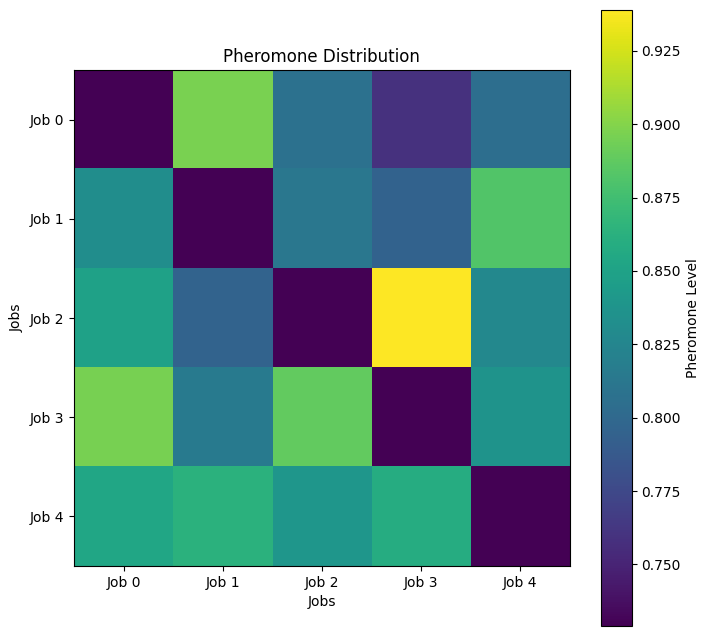

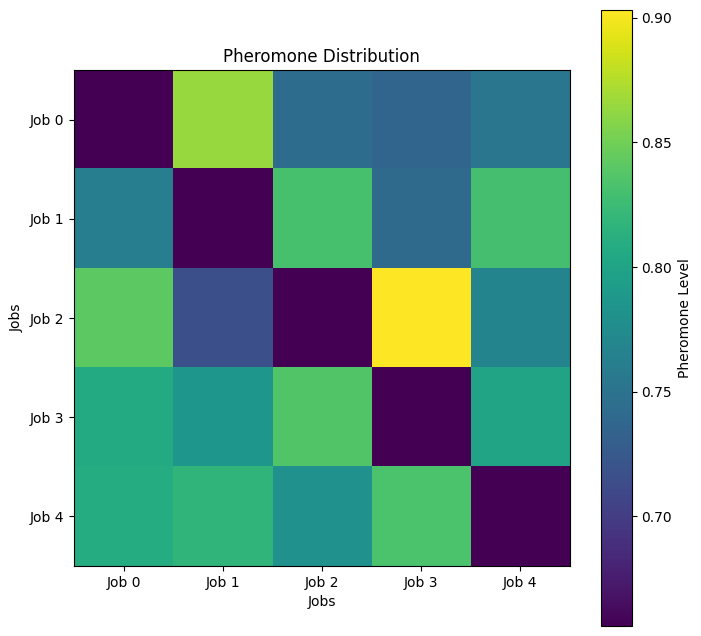

...

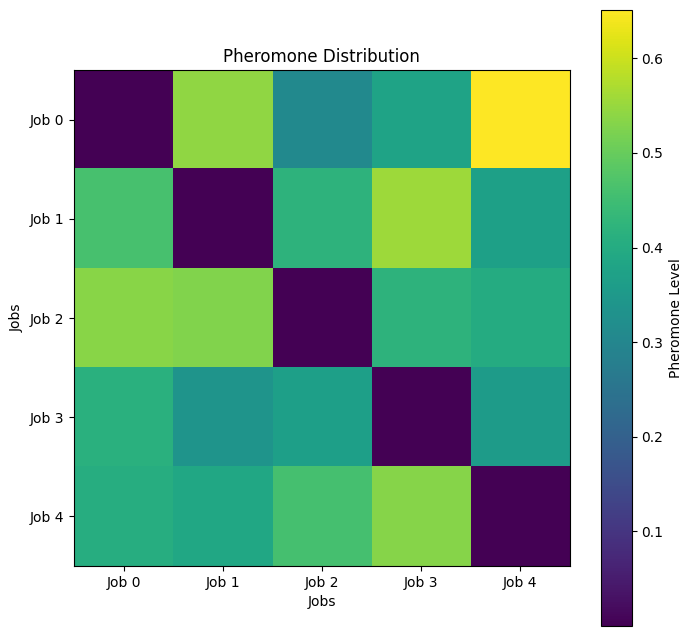

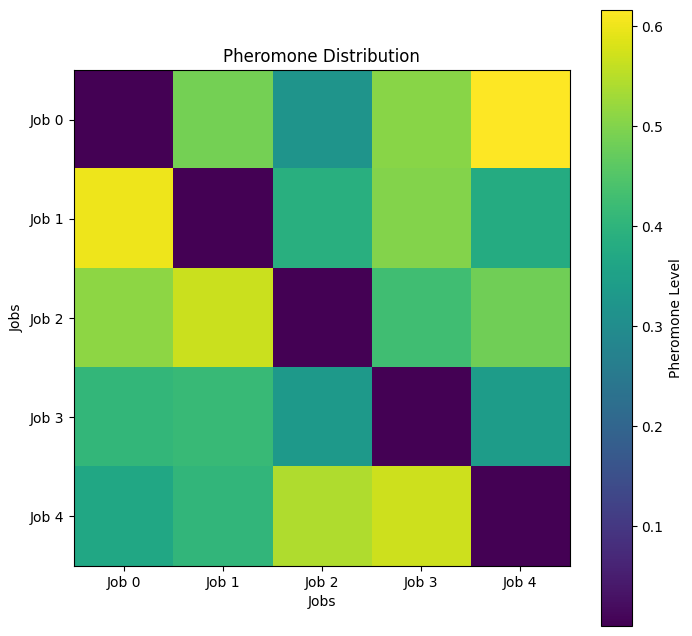

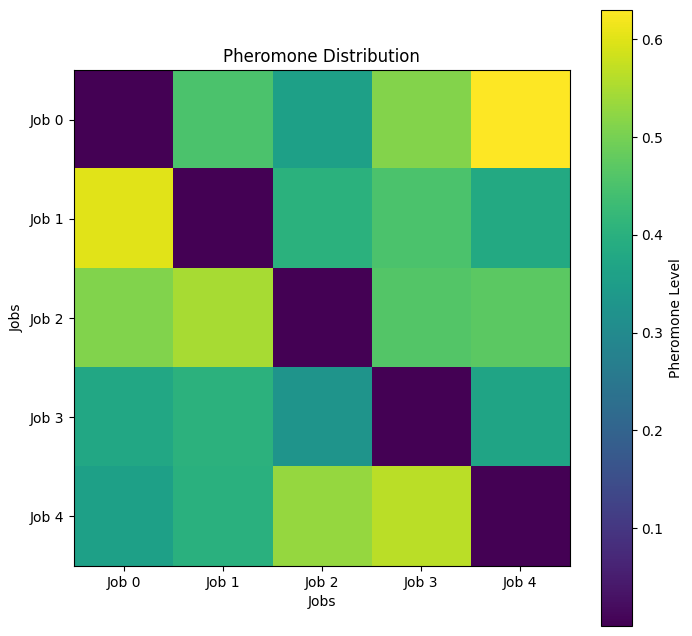

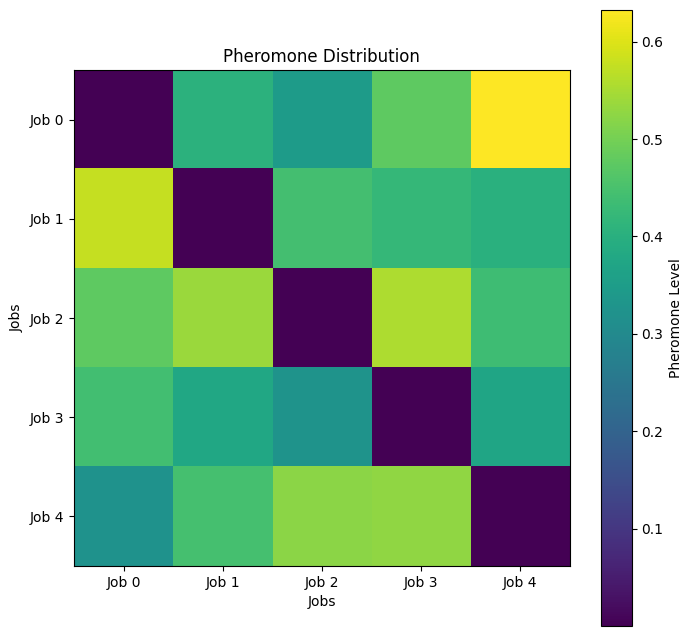

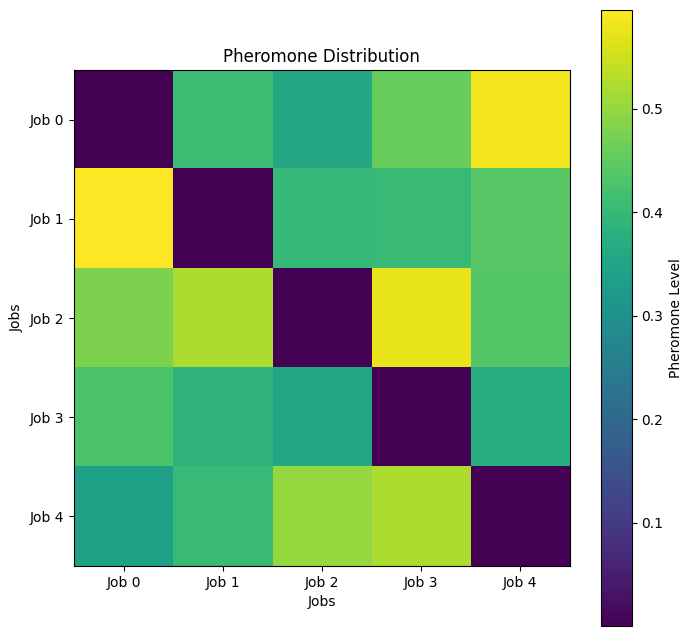

Best Solution: ([4, 2, 3, 1, 0], 29)


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
class AntColony:
    def __init__(self, num_ants, num_jobs, pheromone_decay, alpha=1, beta=2):
        self.num_ants = num_ants
        self.num_jobs = num_jobs
        self.pheromone_decay = pheromone_decay
        self.alpha = alpha
        self.beta = beta
        self.pheromone_matrix = np.ones((num_jobs, num_jobs))
    def run(self, num_iterations):
        for iteration in range(num_iterations):
            solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution()
                solutions.append((solution, self.calculate_total_weighted_tardiness(solution)))
            self.update_pheromones(solutions)
            self.pheromone_matrix *= (1 - self.pheromone_decay)
            self.visualize_pheromones(iteration)
        best_solution = min(solutions, key=lambda x: x[1])
        return best_solution
    def construct_solution(self):
        solution = []
        remaining_jobs = list(range(self.num_jobs))
        while remaining_jobs:
            probabilities = self.calculate_probabilities(remaining_jobs)
            if len(probabilities.shape) > 1:
                probabilities = np.ones(len(remaining_jobs)) / len(remaining_jobs)
            if np.any(np.isnan(probabilities)) or np.any(probabilities == 0):
                probabilities = np.ones(len(remaining_jobs)) / len(remaining_jobs)
            selected_job_index = np.random.choice(len(remaining_jobs), p=probabilities)
            selected_job = remaining_jobs[selected_job_index]
            solution.append(selected_job)
            remaining_jobs.remove(selected_job)
        return solution
    def calculate_probabilities(self, remaining_jobs):
        total_pheromone = np.sum(self.pheromone_matrix[:, remaining_jobs] ** self.alpha)
        if total_pheromone == 0:
            return np.ones(len(remaining_jobs)) / len(remaining_jobs)
        heuristic_information = 1 / (np.array(remaining_jobs, dtype=float) + 1e-10)
        probabilities = ((self.pheromone_matrix[:, remaining_jobs] ** self.alpha) / total_pheromone) * heuristic_information ** self.beta
        probabilities[np.isnan(probabilities) | (probabilities == 0)] = 1 / len(remaining_jobs)
        probabilities /= np.sum(probabilities)
        return probabilities
    def calculate_total_weighted_tardiness(self, solution):
        total_tardiness = 0
        current_time = 0
        for job in solution:
            current_time += processing_times[job]
            tardiness = max(current_time - due_dates[job], 0)
            total_tardiness += weights[job] * tardiness
        return total_tardiness
    def update_pheromones(self, solutions):
        evaporation = 0.1
        for solution, total_tardiness in solutions:
            pheromone_deposit = 1 / total_tardiness
            for i in range(self.num_jobs - 1):
                self.pheromone_matrix[solution[i], solution[i + 1]] += pheromone_deposit
    def visualize_pheromones(self, iteration):
        plt.figure(figsize=(8, 8))
        plt.title(f'Pheromone Distribution')
        plt.imshow(self.pheromone_matrix, cmap='viridis', origin='upper', interpolation='none')
        plt.colorbar(label='Pheromone Level')
        plt.xlabel('Jobs')
        plt.ylabel('Jobs')
        plt.xticks(range(self.num_jobs), labels=[f'Job {i}' for i in range(self.num_jobs)])
        plt.yticks(range(self.num_jobs), labels=[f'Job {i}' for i in range(self.num_jobs)])
        plt.show()
num_ants = 10
num_jobs = 5
pheromone_decay = 0.1
num_iterations = 100
processing_times = [3, 5, 2, 7, 1]
due_dates = [10, 8, 6, 3, 5]
weights = [1, 2, 3, 1, 2]
ant_colony = AntColony(num_ants, num_jobs, pheromone_decay)
ant_colony.visualize_pheromones(0)
for iteration in range(1, num_iterations + 1):
    best_solution = ant_colony.run(1)
print("Best Solution:", best_solution)

In [ ]:
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
def create_graph(processing_times, due_dates, weights):
    num_jobs = len(processing_times)
    graph = nx.DiGraph()
    for i in range(num_jobs):
        for j in range(i + 1, num_jobs):
            graph.add_edge(i, j, weight=weights[i] * max(0, due_dates[j] - processing_times[j]))
    return graph
def initialize_pheromones(graph, initial_pheromone):
    num_nodes = graph.number_of_nodes()
    pheromone_matrix = np.full((num_nodes, num_nodes), initial_pheromone)
    np.fill_diagonal(pheromone_matrix, 0)
    return pheromone_matrix
def calculate_probabilities(graph, pheromone_matrix, current_node, visited_nodes, alpha, beta):
    unvisited_nodes = set(graph.nodes) - visited_nodes
    probabilities = []
    for node in unvisited_nodes:
        pheromone = pheromone_matrix[int(current_node)][int(node)]
        edge_data = graph.get_edge_data(int(current_node), int(node))
        if edge_data is not None:
            distance = edge_data['weight']
            probability = (pheromone ** alpha) * ((1 / distance) ** beta)
            probabilities.append((node, probability))
    total_probability = sum(prob for _, prob in probabilities)
    probabilities = [(node, prob / total_probability) for node, prob in probabilities]
    return probabilities
def choose_next_node(probabilities):
    if not probabilities:
        return None
    nodes, probs = zip(*probabilities)
    selected_node = np.random.choice(nodes, p=probs)
    return selected_node
def construct_solution(graph, pheromone_matrix, alpha, beta):
    num_nodes = graph.number_of_nodes()
    visited_nodes = set()
    start_node = np.random.choice(num_nodes)
    current_node = start_node
    path = [current_node]
    while len(visited_nodes) < num_nodes:
        probabilities = calculate_probabilities(graph, pheromone_matrix, current_node, visited_nodes, alpha, beta)
        next_node = choose_next_node(probabilities)
        if next_node is not None:
            visited_nodes.add(next_node)
            path.append(next_node)
            current_node = next_node
    return path
def calculate_total_weighted_tardiness(path, graph):
    total_tardiness = 0
    current_time = 0
    for i in range(len(path) - 1):
        current_node = path[i]
        next_node = path[i + 1]
        edge_data = graph.get_edge_data(current_node, next_node)
        current_time += graph.nodes[current_node]['processing_time']
        total_tardiness += max(0, current_time - graph.nodes[next_node]['due_date']) * edge_data['weight']
    return total_tardiness
def ant_colony_optimization(graph, num_ants, evaporation_rate, alpha, beta, max_iterations):
    num_nodes = graph.number_of_nodes()
    initial_pheromone = 1.0 / num_nodes
    pheromone_matrix = initialize_pheromones(graph, initial_pheromone)
    best_solution = None
    best_cost = float('inf')
    for iteration in range(max_iterations):
        solutions = []
        for ant in range(num_ants):
            path = construct_solution(graph, pheromone_matrix, alpha, beta)
            cost = calculate_total_weighted_tardiness(path, graph)
            solutions.append((path, cost))
        current_best_path, current_best_cost = min(solutions, key=lambda x: x[1])
        if current_best_cost < best_cost:
            best_solution = current_best_path
            best_cost = current_best_cost
        update_pheromones(pheromone_matrix, solutions, evaporation_rate)
    return best_solution, best_cost
def update_pheromones(pheromone_matrix, solutions, evaporation_rate):
    pheromone_matrix *= (1 - evaporation_rate)
    for path, cost in solutions:
        if cost != 0:
            for i in range(len(path) - 1):
                pheromone_matrix[path[i]][path[i+1]] += 1 / cost
def visualize_graph(graph):
    pos = nx.spring_layout(graph)
    nx.draw(graph, pos, with_labels=True)
    labels = nx.get_edge_attributes(graph, 'weight')
    nx.draw_networkx_edge_labels(graph, pos, edge_labels=labels)
    plt.show()
def main():
    processing_times = [2, 3, 5, 1]
    due_dates = [8, 6, 10, 3]
    weights = [1, 2, 3, 4]
    num_ants = 10
    evaporation_rate = 0.1
    alpha = 1
    beta = 2
    max_iterations = 100
    graph = create_graph(processing_times, due_dates, weights)
    visualize_graph(graph)
    best_solution, best_cost = ant_colony_optimization(graph, num_ants, evaporation_rate, alpha, beta, max_iterations)
    print(f"Best solution = {best_solution}")
    print(f"Best cost = {best_cost}")
if __name__ == "__main__":
    main()

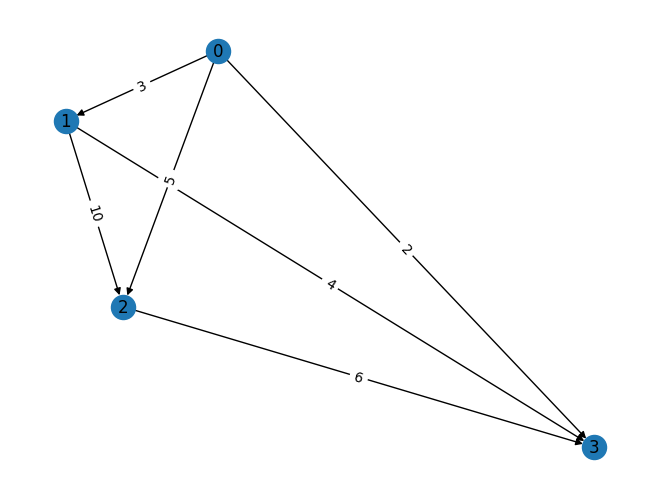

**`Resource-Constrained Project Scheduling Problem `**

In [ ]:
import numpy as np
import random
class AntColony:
    def __init__(self, tasks, num_ants, pheromone_evaporation_rate=0.5, alpha=1, beta=2):
        self.tasks = tasks
        self.num_ants = num_ants
        self.pheromone_evaporation_rate = pheromone_evaporation_rate
        self.alpha = alpha
        self.beta = beta
        self.pheromones = np.ones(len(tasks))
        self.best_schedule = None
        self.best_schedule_cost = float('inf')
    def run(self, max_iterations):
        for iteration in range(max_iterations):
            solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution()
                solutions.append((solution, self.calculate_cost(solution)))
            self.update_pheromones(solutions)
            self.update_best_schedule(solutions)
        return self.best_schedule, self.best_schedule_cost
    def construct_solution(self):
        solution = []
        remaining_tasks = set(self.tasks)
        while remaining_tasks:
            task = self.select_task(remaining_tasks)
            solution.append(task)
            remaining_tasks.remove(task)
        return solution
    def select_task(self, remaining_tasks):
        probabilities = [
            (task, self.pheromones[task] ** self.alpha / (self.tasks[task]['duration'] + 1) ** self.beta)
            for task in remaining_tasks
        ]
        total_prob = sum(prob for _, prob in probabilities)
        chosen_prob = random.uniform(0, total_prob)
        cumulative_prob = 0
        for task, prob in probabilities:
            cumulative_prob += prob
            if cumulative_prob >= chosen_prob:
                return task
    def calculate_cost(self, solution):
        total_cost = 0
        task_start_times = {}
        for task in solution:
            earliest_start_time = max(task_start_times.get(task, 0), self.tasks[task]['release_time'])
            task_start_times[task] = earliest_start_time + self.tasks[task]['duration']
            tardiness = max(0, task_start_times[task] - self.tasks[task]['deadline'])
            total_cost += self.tasks[task]['penalty_rate'] * tardiness
        return total_cost
    def update_pheromones(self, solutions):
        for i in range(len(self.pheromones)):
            self.pheromones[i] *= (1 - self.pheromone_evaporation_rate)
            for solution, cost in solutions:
                if i in solution:
                    self.pheromones[i] += 1 / (cost + 1)
    def update_best_schedule(self, solutions):
        for solution, cost in solutions:
            if cost < self.best_schedule_cost:
                self.best_schedule = solution
                self.best_schedule_cost = cost
tasks = {
    0: {'duration': 3, 'release_time': 0, 'deadline': 10, 'penalty_rate': 2},
    1: {'duration': 2, 'release_time': 0, 'deadline': 8, 'penalty_rate': 1},
    2: {'duration': 4, 'release_time': 0, 'deadline': 15, 'penalty_rate': 3},
    3: {'duration': 5, 'release_time': 0, 'deadline': 12, 'penalty_rate': 4}
}
num_ants = 5
max_iterations = 100
ant_colony = AntColony(tasks, num_ants)
best_schedule, best_schedule_cost = ant_colony.run(max_iterations)
print("Best Schedule =", best_schedule)
print("Best Schedule Cost =", best_schedule_cost)

Best Schedule = [0, 1, 2, 3]
Best Schedule Cost = 0


In [ ]:
import random
class Task:
    def __init__(self, name, duration):
        self.name = name
        self.duration = duration
class Ant:
    def __init__(self, tasks):
        self.tasks = tasks
        self.schedule = []
def calculate_fitness(schedule):
    total_duration = sum(task.duration for task in schedule)
    return total_duration
def ant_colony_optimization(tasks, num_ants, iterations):
    best_schedule = None
    best_fitness = float('inf')
    for _ in range(iterations):
        ants = [Ant(tasks) for _ in range(num_ants)]
        for ant in ants:
            ant.schedule = random.sample(ant.tasks, len(ant.tasks))
        for ant in ants:
            fitness = calculate_fitness(ant.schedule)
            if fitness < best_fitness:
                best_fitness = fitness
                best_schedule = ant.schedule
    return best_schedule, best_fitness
tasks = [Task("Excavation", 5), Task("Framing", 10), Task("Plumbing", 7), Task("Electrical", 8), Task("Finishing", 6)]
best_schedule, best_fitness = ant_colony_optimization(tasks, num_ants=5, iterations=100)
print("Best Schedule =", [task.name for task in best_schedule])
print("Best Fitness (Total Project Duration) =", best_fitness)

Best Schedule = ['Electrical', 'Excavation', 'Framing', 'Finishing', 'Plumbing']
Best Fitness (Total Project Duration) = 36


In [ ]:
import networkx as nx
import numpy as np
import random
class AntColony:
    def __init__(self, graph, n_ants, n_best, n_iterations, decay, alpha=1, beta=2):
        self.graph = graph
        self.pheromone_matrix = np.ones(graph.shape) / len(graph)
        self.all_paths = self.get_all_paths()
        self.pheromone_delta = np.zeros(graph.shape)
        self.eta = 1 / (graph + 1e-10)
        self.alpha = alpha
        self.beta = beta
        self.prob_matrix = self.calculate_prob_matrix()
        self.global_best_path = None
        self.global_best_path_length = float('inf')
        self.n_ants = n_ants
        self.n_best = n_best
        self.n_iterations = n_iterations
        self.decay = decay
    def get_all_paths(self):
        all_paths = []
        for i in range(len(self.graph)):
            for j in range(len(self.graph)):
                if self.graph[i][j] > 0:
                    all_paths.append([(i, j)])
        return all_paths
    def calculate_prob_matrix(self):
        return (self.pheromone_matrix ** self.alpha) * ((1 / self.eta) ** self.beta)
    def ant_run(self):
        ants_paths = []
        for ant in range(self.n_ants):
            path = self.select_path()
            ants_paths.append((path, self.calculate_path_length(path)))
            self.update_pheromone_delta(path)
        return ants_paths
    def select_path(self):
        start = random.randint(0, len(self.graph) - 1)
        path = []
        visited = set()
        visited.add(start)
        for _ in range(len(self.graph) - 1):
            row = self.prob_matrix[start]
            for j in range(len(row)):
                if j not in visited:
                    path.append((start, j))
                    start = j
                    visited.add(start)
                    break
        return path
    def calculate_path_length(self, path):
        length = 0
        for edge in path:
            length += self.graph[edge[0]][edge[1]]
        return length
    def update_pheromone_delta(self, path):
        for edge in path:
            self.pheromone_delta[edge[0]][edge[1]] += 1 / self.calculate_path_length(path)
    def update_pheromone_matrix(self):
        self.pheromone_matrix = (1 - self.decay) * self.pheromone_matrix + self.pheromone_delta
        self.pheromone_delta = np.zeros(self.graph.shape)
    def solve(self):
        for iteration in range(self.n_iterations):
            ants_paths = self.ant_run()
            if ants_paths:
                self.global_best_path, self.global_best_path_length = min(ants_paths, key=lambda x: x[1])
            self.update_pheromone_matrix()
            if iteration % 10 == 0:
                print(f"Iteration-{iteration}: Global Best Path Length = {self.global_best_path_length}")
if __name__ == "__main__":
    graph = np.array([
        [0, 3, 0, 2, 0],
        [0, 0, 2, 0, 0],
        [0, 0, 0, 5, 1],
        [0, 0, 0, 0, 4],
        [0, 0, 0, 0, 0]
    ])
    n_ants = 5
    n_best = 2
    n_iterations = 50
    decay = 0.1
    alpha = 1
    beta = 2
    ant_colony = AntColony(graph, n_ants, n_best, n_iterations, decay, alpha, beta)
    ant_colony.solve()
    print(f"Optimal Schedule = {ant_colony.global_best_path}")
    print(f"Optimal Schedule Length = {ant_colony.global_best_path_length}")

Iteration-0: Global Best Path Length = 7
Iteration-10: Global Best Path Length = 6
Iteration-20: Global Best Path Length = 7
Iteration-30: Global Best Path Length = 6
Iteration-40: Global Best Path Length = 6
Optimal Schedule = [(2, 0), (0, 1), (1, 3), (3, 4)]
Optimal Schedule Length = 7


Iteration-0: Global Best Path Length = 6


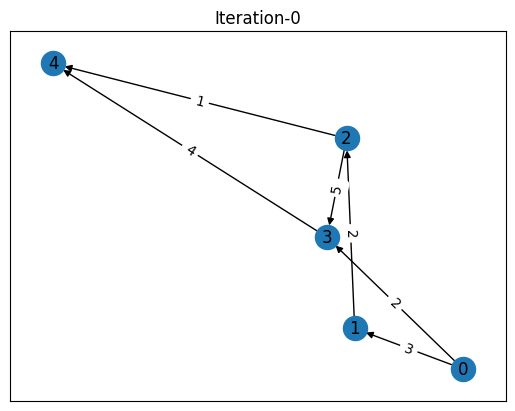

Iteration-10: Global Best Path Length = 6


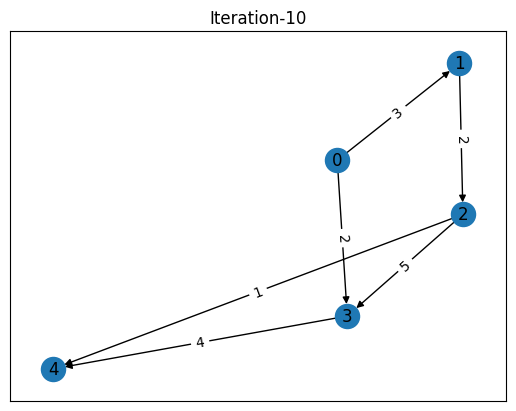

Iteration-20: Global Best Path Length = 9


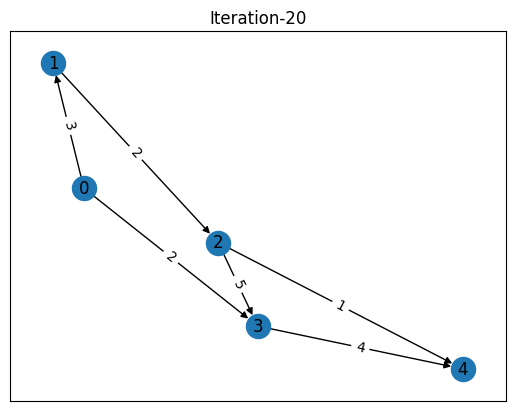

Iteration-30: Global Best Path Length = 7


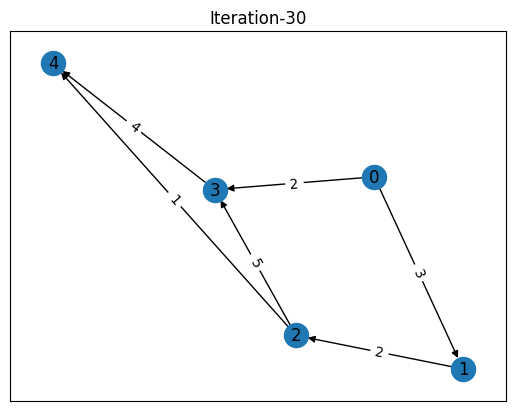

Iteration-40: Global Best Path Length = 6


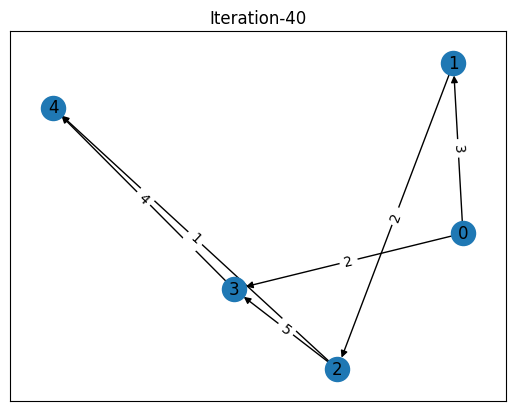

Optimal Schedule = [(3, 0), (0, 1), (1, 2), (2, 4)]
Optimal Schedule Length = 6


In [ ]:
import networkx as nx
import numpy as np
import random
import matplotlib.pyplot as plt
class AntColony:
    def __init__(self, graph, n_ants, n_best, n_iterations, decay, alpha=1, beta=2):
        self.graph = graph
        self.pheromone_matrix = np.ones(graph.shape) / len(graph)
        self.all_paths = self.get_all_paths()
        self.pheromone_delta = np.zeros(graph.shape)
        self.eta = 1 / (graph + 1e-10)
        self.alpha = alpha
        self.beta = beta
        self.prob_matrix = self.calculate_prob_matrix()
        self.global_best_path = None
        self.global_best_path_length = float('inf')
        self.n_ants = n_ants
        self.n_best = n_best
        self.n_iterations = n_iterations
        self.decay = decay
    def get_all_paths(self):
        all_paths = []
        for i in range(len(self.graph)):
            for j in range(len(self.graph)):
                if self.graph[i][j] > 0:
                    all_paths.append([(i, j)])
        return all_paths
    def calculate_prob_matrix(self):
        return (self.pheromone_matrix ** self.alpha) * ((1 / self.eta) ** self.beta)
    def ant_run(self):
        ants_paths = []
        for ant in range(self.n_ants):
            path = self.select_path()
            ants_paths.append((path, self.calculate_path_length(path)))
            self.update_pheromone_delta(path)
        return ants_paths
    def select_path(self):
        start = random.randint(0, len(self.graph) - 1)
        path = []
        visited = set()
        visited.add(start)
        for _ in range(len(self.graph) - 1):
            row = self.prob_matrix[start]
            for j in range(len(row)):
                if j not in visited:
                    path.append((start, j))
                    start = j
                    visited.add(start)
                    break
        return path
    def calculate_path_length(self, path):
        length = 0
        for edge in path:
            length += self.graph[edge[0]][edge[1]]
        return length
    def update_pheromone_delta(self, path):
        for edge in path:
            self.pheromone_delta[edge[0]][edge[1]] += 1 / self.calculate_path_length(path)
    def update_pheromone_matrix(self):
        self.pheromone_matrix = (1 - self.decay) * self.pheromone_matrix + self.pheromone_delta
        self.pheromone_delta = np.zeros(self.graph.shape)
    def visualize_graph(self, iteration):
        G = nx.DiGraph()
        for i in range(len(self.graph)):
            for j in range(len(self.graph[i])):
                if self.graph[i][j] > 0:
                    G.add_edge(i, j, weight=self.graph[i][j])
        pos = nx.spring_layout(G)
        labels = nx.get_edge_attributes(G, 'weight')
        nx.draw_networkx_nodes(G, pos)
        nx.draw_networkx_edges(G, pos)
        nx.draw_networkx_edge_labels(G, pos, edge_labels=labels)
        nx.draw_networkx_labels(G, pos)
        plt.title(f'Iteration-{iteration}')
        plt.show()
    def solve(self):
        for iteration in range(self.n_iterations):
            ants_paths = self.ant_run()
            if ants_paths:
                self.global_best_path, self.global_best_path_length = min(ants_paths, key=lambda x: x[1])
            self.update_pheromone_matrix()
            if iteration % 10 == 0:
                print(f"Iteration-{iteration}: Global Best Path Length = {self.global_best_path_length}")
                self.visualize_graph(iteration)
if __name__ == "__main__":
    graph = np.array([
        [0, 3, 0, 2, 0],
        [0, 0, 2, 0, 0],
        [0, 0, 0, 5, 1],
        [0, 0, 0, 0, 4],
        [0, 0, 0, 0, 0]
    ])
    n_ants = 5
    n_best = 2
    n_iterations = 50
    decay = 0.1
    alpha = 1
    beta = 2
    ant_colony = AntColony(graph, n_ants, n_best, n_iterations, decay, alpha, beta)
    ant_colony.solve()
    print(f"Optimal Schedule = {ant_colony.global_best_path}")
    print(f"Optimal Schedule Length = {ant_colony.global_best_path_length}")

**`Group-Shop Scheduling Problem`**

In [ ]:
import numpy as np
class GroupShopScheduling:
    def __init__(self, num_ants, num_iterations, pheromone_decay, alpha, beta, Q):
        self.num_ants = num_ants
        self.num_iterations = num_iterations
        self.pheromone_decay = pheromone_decay
        self.alpha = alpha
        self.beta = beta
        self.Q = Q
    def solve(self, num_jobs, num_machines, processing_times):
        self.num_jobs = num_jobs
        self.num_machines = num_machines
        self.processing_times = processing_times
        self.pheromones = np.ones((num_jobs, num_machines))
        for iteration in range(self.num_iterations):
            solutions = self.construct_solutions()
            self.update_pheromones(solutions)
        best_solution = min(solutions, key=lambda x: x[1])
        print("Best Solution =", best_solution)
    def construct_solutions(self):
        solutions = []
        for ant in range(self.num_ants):
            solution = self.build_solution()
            total_time = self.calculate_total_time(solution)
            solutions.append((solution, total_time))
        return solutions
    def build_solution(self):
        solution = []
        for job in range(self.num_jobs):
            machine_probabilities = self.calculate_machine_probabilities(job)
            selected_machine = np.random.choice(self.num_machines, p=machine_probabilities)
            solution.append(selected_machine)
        return solution
    def calculate_machine_probabilities(self, job):
        pheromone_values = self.pheromones[job, :]
        visibility_values = 1 / self.processing_times[job, :]
        probabilities = (pheromone_values ** self.alpha) * (visibility_values ** self.beta)
        probabilities /= np.sum(probabilities)
        return probabilities
    def calculate_total_time(self, solution):
        total_time = 0
        for job, machine in enumerate(solution):
            total_time += self.processing_times[job, machine]
        return total_time
    def update_pheromones(self, solutions):
        self.pheromones *= (1 - self.pheromone_decay)
        for solution, total_time in solutions:
            for job, machine in enumerate(solution):
                self.pheromones[job, machine] += self.Q / total_time
num_ants = 5
num_iterations = 10
pheromone_decay = 0.1
alpha = 1.0
beta = 2.0
Q = 1.0
num_jobs = 3
num_machines = 2
processing_times = np.array([[2, 3], [1, 4], [3, 2]])
aco = GroupShopScheduling(num_ants, num_iterations, pheromone_decay, alpha, beta, Q)
aco.solve(num_jobs, num_machines, processing_times)

Best Solution = ([0, 0, 1], 5)


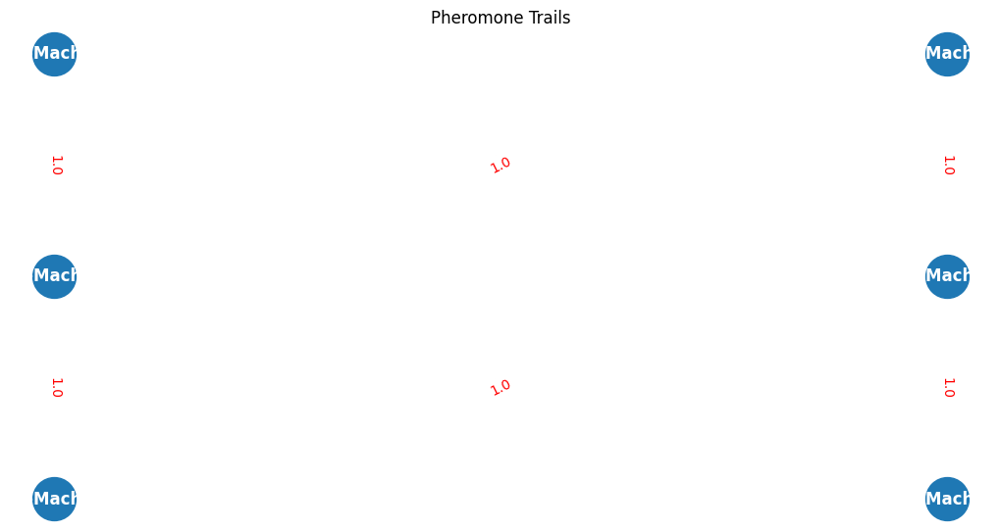

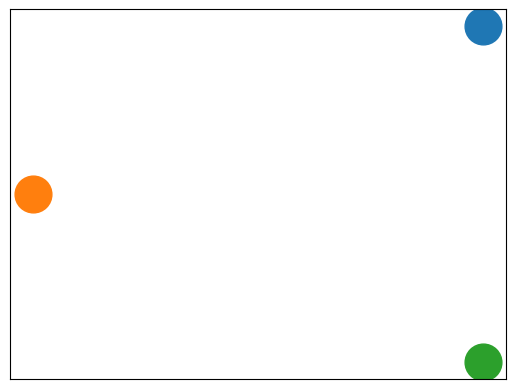

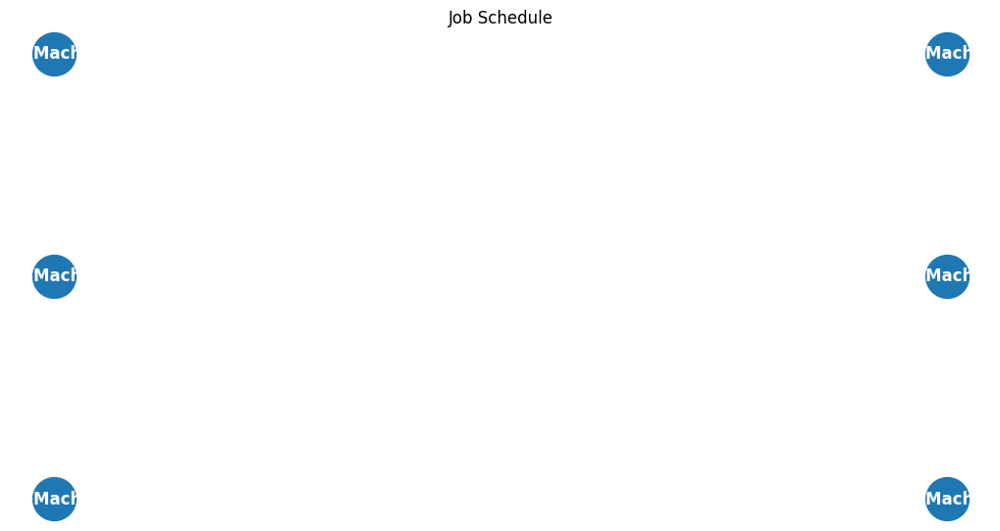

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
class GroupShopSchedulingVisualizer:
    def __init__(self, num_jobs, num_machines):
        self.num_jobs = num_jobs
        self.num_machines = num_machines
        self.G = nx.Graph()
        self.pos = {}
    def initialize_graph(self):
        for job in range(self.num_jobs):
            for machine in range(self.num_machines):
                node_id = self.get_node_id(job, machine)
                self.G.add_node(node_id)
                self.pos[node_id] = (machine, -job)
    def visualize_pheromones(self, pheromones):
        edge_weights = {(self.get_node_id(i, j), self.get_node_id(i+1, k)): pheromones[i, k] for i in range(self.num_jobs-1) for j in range(self.num_machines) for k in range(self.num_machines)}
        edges, weights = zip(*edge_weights.items())
        plt.figure(figsize=(10, 5))
        nx.draw(self.G, pos=self.pos, with_labels=True, node_size=1000, font_size=12, font_color='white', font_weight='bold')
        nx.draw_networkx_edge_labels(self.G, pos=self.pos, edge_labels=dict(zip(edges, weights)), font_color='red')
        plt.title("Pheromone Trails")
        plt.show()
    def visualize_schedule(self, solution):
        colors = ['C'+str(i%10) for i in range(self.num_jobs)]
        for job, machine in enumerate(solution):
            node_id = self.get_node_id(job, machine)
            nx.draw_networkx_nodes(self.G, pos=self.pos, nodelist=[node_id], node_color=colors[job], node_size=700)
        plt.figure(figsize=(10, 5))
        nx.draw(self.G, pos=self.pos, with_labels=True, node_size=1000, font_size=12, font_color='white', font_weight='bold')
        plt.title("Job Schedule")
        plt.show()
    def get_node_id(self, job, machine):
        return f"Job{job + 1}-Machine{machine + 1}"
num_jobs = 3
num_machines = 2
processing_times = np.array([[2, 3], [1, 4], [3, 2]])
visualizer = GroupShopSchedulingVisualizer(num_jobs, num_machines)
visualizer.initialize_graph()
pheromones = np.ones((num_jobs - 1, num_machines))
visualizer.visualize_pheromones(pheromones)
solution = [1, 0, 1]
visualizer.visualize_schedule(solution)

In [ ]:
!apt install libgraphviz-dev

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common libgvc6-plugins-gtk
  librsvg2-common libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk librsvg2-common libxdot4
0 upgraded, 9 newly installed, 0 to remove and 33 not upgraded.
Need to get 2,433 kB of archives.
After this operation, 7,694 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-common all 2.24.33-2ubuntu2 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-0 amd64 2.24.33-2ubuntu2 [2,037 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgail18 amd64 2.24.33-2ubuntu2 [15.9 kB]
Get:4 http://archive.ubuntu.com/ubuntu jammy/main amd64

In [ ]:
!pip install pygraphviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.9/104.9 kB 3.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pygraphviz: filename=pygraphviz-1.12-cp310-cp310-linux_x86_64.whl size=168126 sha256=3e05324d68f6a3f27faccc5fa7d99d83f38da3a7f7f8c40b8dd7fdc3a02babfc
  Stored in directory: /root/.cache/pip/wheels/1d/ee/b5/a2f54f9e9b3951599c05dcce270ca85e472f8e6cec470e397a
Successfully built pygraphviz


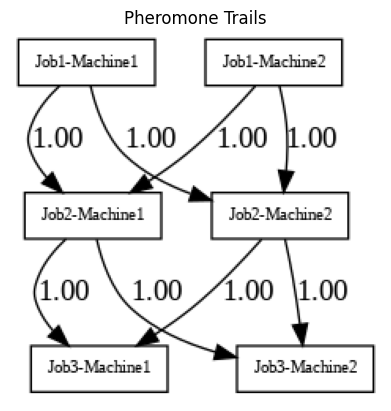

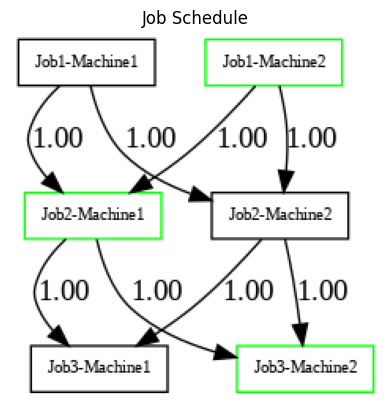

In [ ]:
import numpy as np
import pygraphviz as pgv
import matplotlib.pyplot as plt
class GroupShopSchedulingVisualizer:
    def __init__(self, num_jobs, num_machines):
        self.num_jobs = num_jobs
        self.num_machines = num_machines
        self.G = pgv.AGraph(directed=True)
        self.G.graph_attr['rankdir'] = 'TB'
        self.G.node_attr['shape'] = 'box'
        self.G.node_attr['height'] = '0.3'
        self.G.node_attr['width'] = '0.5'
        self.G.node_attr['fontsize'] = '8'
    def initialize_graph(self):
        for job in range(self.num_jobs):
            for machine in range(self.num_machines):
                node_id = self.get_node_id(job, machine)
                self.G.add_node(node_id)
    def visualize_pheromones(self, pheromones):
        for i in range(self.num_jobs - 1):
            for j in range(self.num_machines):
                for k in range(self.num_machines):
                    edge_label = f"{pheromones[i, k]:.2f}"
                    self.G.add_edge(self.get_node_id(i, j), self.get_node_id(i + 1, k), label=edge_label)
        self.G.layout(prog='dot')
        self.G.draw('pheromones.png')
        plt.imshow(plt.imread('pheromones.png'))
        plt.title("Pheromone Trails")
        plt.axis('off')
        plt.show()
    def visualize_schedule(self, solution):
        for job, machine in enumerate(solution):
            self.G.get_node(self.get_node_id(job, machine)).attr['color'] = 'green'
        self.G.layout(prog='dot')
        self.G.draw('schedule.png')
        plt.imshow(plt.imread('schedule.png'))
        plt.title("Job Schedule")
        plt.axis('off')
        plt.show()
    def get_node_id(self, job, machine):
        return f"Job{job + 1}-Machine{machine + 1}"
num_jobs = 3
num_machines = 2
processing_times = np.array([[2, 3], [1, 4], [3, 2]])
visualizer = GroupShopSchedulingVisualizer(num_jobs, num_machines)
visualizer.initialize_graph()
pheromones = np.ones((num_jobs - 1, num_machines))
visualizer.visualize_pheromones(pheromones)
solution = [1, 0, 1]
visualizer.visualize_schedule(solution)

**`Single-Machine Total Tardiness Problem with Sequence Dependent Setup Times`**

In [ ]:
import numpy as np
class AntColony:
    def __init__(self, num_ants, num_jobs, setup_times, processing_times, due_dates, alpha=1.0, beta=2.0, evaporation_rate=0.5):
        self.num_ants = num_ants
        self.num_jobs = num_jobs
        self.setup_times = setup_times
        self.processing_times = processing_times
        self.due_dates = due_dates
        self.alpha = alpha
        self.beta = beta
        self.evaporation_rate = evaporation_rate
        self.pheromone_matrix = np.ones((num_jobs, num_jobs))
    def run(self, num_iterations):
        for iteration in range(num_iterations):
            solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution()
                solutions.append((solution, self.calculate_tardiness(solution)))
            best_solution = min(solutions, key=lambda x: x[1])[0]
            self.update_pheromones(best_solution)
            print(f"Iteration {iteration + 1}/{num_iterations}: Best Tardiness = {self.calculate_tardiness(best_solution)}")
        print("\nBest Solution:")
        print("Job Sequence =", best_solution)
        print("Total Tardiness =", self.calculate_tardiness(best_solution))
    def construct_solution(self):
        solution = []
        remaining_jobs = set(range(self.num_jobs))
        current_job = np.random.choice(list(remaining_jobs))
        remaining_jobs.remove(current_job)
        solution.append(current_job)
        while remaining_jobs:
            next_job = self.select_next_job(current_job, remaining_jobs)
            solution.append(next_job)
            remaining_jobs.remove(next_job)
            current_job = next_job
        return solution
    def select_next_job(self, current_job, remaining_jobs):
        probabilities = []
        for job in remaining_jobs:
            transition_prob = self.calculate_transition_probability(current_job, job)
            probabilities.append(transition_prob)
        probabilities = np.array(probabilities)
        normalized_probs = probabilities / probabilities.sum()
        next_job = np.random.choice(list(remaining_jobs), p=normalized_probs)
        return next_job
    def calculate_transition_probability(self, current_job, next_job):
        pheromone = self.pheromone_matrix[current_job, next_job]
        visibility = 1.0 / (self.setup_times[current_job, next_job] + self.processing_times[next_job])
        return pheromone ** self.alpha * visibility ** self.beta
    def calculate_tardiness(self, solution):
        completion_times = np.zeros(self.num_jobs)
        tardiness = 0
        for job in solution:
            completion_times[job] = max(completion_times[job - 1], due_dates[job]) + self.processing_times[job]
        for job in solution:
            tardiness += max(0, completion_times[job] - due_dates[job])
        return tardiness
    def update_pheromones(self, best_solution):
        evaporation_rate = self.evaporation_rate
        for i in range(self.num_jobs - 1):
            for j in range(i + 1, self.num_jobs):
                self.pheromone_matrix[i, j] *= (1 - evaporation_rate)
                self.pheromone_matrix[j, i] = self.pheromone_matrix[i, j]
        for i in range(self.num_jobs - 1):
            self.pheromone_matrix[best_solution[i], best_solution[i + 1]] += 1.0 / self.calculate_tardiness(best_solution)
num_ants = 10
num_jobs = 5
setup_times = np.array([[0, 2, 3, 1, 4],
                        [2, 0, 1, 4, 3],
                        [3, 1, 0, 5, 2],
                        [1, 4, 5, 0, 1],
                        [4, 3, 2, 1, 0]])
processing_times = np.array([5, 4, 3, 2, 1])
due_dates = np.array([10, 8, 6, 4, 2])
aco = AntColony(num_ants, num_jobs, setup_times, processing_times, due_dates)
aco.run(num_iterations=100)

Iteration 1/100: Best Tardiness = 20.0
Iteration 2/100: Best Tardiness = 19.0
Iteration 3/100: Best Tardiness = 20.0
Iteration 4/100: Best Tardiness = 20.0
Iteration 5/100: Best Tardiness = 19.0
Iteration 6/100: Best Tardiness = 19.0
Iteration 7/100: Best Tardiness = 19.0
Iteration 8/100: Best Tardiness = 15.0
Iteration 9/100: Best Tardiness = 15.0
Iteration 10/100: Best Tardiness = 15.0
Iteration 11/100: Best Tardiness = 15.0
Iteration 12/100: Best Tardiness = 15.0
Iteration 13/100: Best Tardiness = 15.0
Iteration 14/100: Best Tardiness = 15.0
Iteration 15/100: Best Tardiness = 15.0
Iteration 16/100: Best Tardiness = 15.0
Iteration 17/100: Best Tardiness = 15.0
Iteration 18/100: Best Tardiness = 15.0
Iteration 19/100: Best Tardiness = 15.0
Iteration 20/100: Best Tardiness = 19.0
Iteration 21/100: Best Tardiness = 19.0
Iteration 22/100: Best Tardiness = 19.0
Iteration 23/100: Best Tardiness = 19.0
Iteration 24/100: Best Tardiness = 19.0
Iteration 25/100: Best Tardiness = 19.0
Iteration

Iteration 1/100: Best Tardiness = 20.0
Iteration 2/100: Best Tardiness = 19.0
Iteration 3/100: Best Tardiness = 20.0
Iteration 4/100: Best Tardiness = 19.0
Iteration 5/100: Best Tardiness = 20.0
Iteration 6/100: Best Tardiness = 21.0
Iteration 7/100: Best Tardiness = 20.0
Iteration 8/100: Best Tardiness = 21.0
Iteration 9/100: Best Tardiness = 21.0
Iteration 10/100: Best Tardiness = 20.0
Iteration 11/100: Best Tardiness = 20.0
Iteration 12/100: Best Tardiness = 20.0
Iteration 13/100: Best Tardiness = 20.0
Iteration 14/100: Best Tardiness = 20.0
Iteration 15/100: Best Tardiness = 20.0
Iteration 16/100: Best Tardiness = 21.0
Iteration 17/100: Best Tardiness = 20.0
Iteration 18/100: Best Tardiness = 20.0
Iteration 19/100: Best Tardiness = 20.0
Iteration 20/100: Best Tardiness = 20.0
Iteration 21/100: Best Tardiness = 20.0
Iteration 22/100: Best Tardiness = 20.0
Iteration 23/100: Best Tardiness = 20.0
Iteration 24/100: Best Tardiness = 21.0
Iteration 25/100: Best Tardiness = 20.0
Iteration

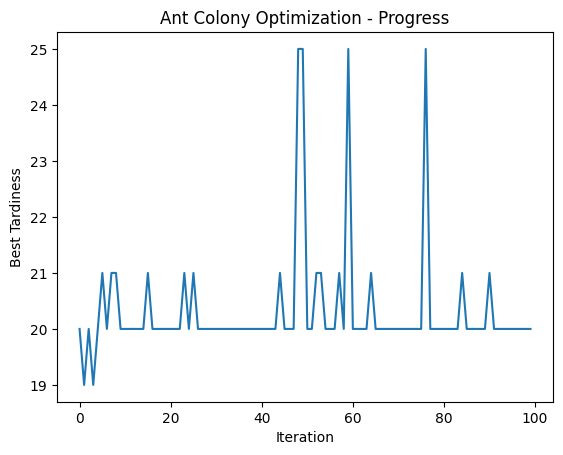

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
class AntColony:
    def __init__(self, num_ants, num_jobs, setup_times, processing_times, due_dates, alpha=1.0, beta=2.0, evaporation_rate=0.5):
        self.num_ants = num_ants
        self.num_jobs = num_jobs
        self.setup_times = setup_times
        self.processing_times = processing_times
        self.due_dates = due_dates
        self.alpha = alpha
        self.beta = beta
        self.evaporation_rate = evaporation_rate
        self.pheromone_matrix = np.ones((num_jobs, num_jobs))
    def run(self, num_iterations):
        best_tardiness_list = []
        for iteration in range(num_iterations):
            solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution()
                solutions.append((solution, self.calculate_tardiness(solution)))
            best_solution = min(solutions, key=lambda x: x[1])[0]
            self.update_pheromones(best_solution)
            best_tardiness = self.calculate_tardiness(best_solution)
            best_tardiness_list.append(best_tardiness)
            print(f"Iteration {iteration + 1}/{num_iterations}: Best Tardiness = {best_tardiness}")
        self.plot_progress(best_tardiness_list)
    def construct_solution(self):
        solution = []
        remaining_jobs = set(range(self.num_jobs))
        current_job = np.random.choice(list(remaining_jobs))
        remaining_jobs.remove(current_job)
        solution.append(current_job)
        while remaining_jobs:
            next_job = self.select_next_job(current_job, remaining_jobs)
            solution.append(next_job)
            remaining_jobs.remove(next_job)
            current_job = next_job
        return solution
    def select_next_job(self, current_job, remaining_jobs):
        probabilities = []
        for job in remaining_jobs:
            transition_prob = self.calculate_transition_probability(current_job, job)
            probabilities.append(transition_prob)
        probabilities = np.array(probabilities)
        normalized_probs = probabilities / probabilities.sum()
        next_job = np.random.choice(list(remaining_jobs), p=normalized_probs)
        return next_job
    def calculate_transition_probability(self, current_job, next_job):
        pheromone = self.pheromone_matrix[current_job, next_job]
        visibility = 1.0 / (self.setup_times[current_job, next_job] + self.processing_times[next_job])
        return pheromone ** self.alpha * visibility ** self.beta
    def calculate_tardiness(self, solution):
        completion_times = np.zeros(self.num_jobs)
        tardiness = 0
        for job in solution:
            completion_times[job] = max(completion_times[job - 1], self.due_dates[job]) + self.processing_times[job]
        for job in solution:
            tardiness += max(0, completion_times[job] - self.due_dates[job])
        return tardiness
    def update_pheromones(self, best_solution):
        evaporation_rate = self.evaporation_rate
        for i in range(self.num_jobs - 1):
            for j in range(i + 1, self.num_jobs):
                self.pheromone_matrix[i, j] *= (1 - evaporation_rate)
                self.pheromone_matrix[j, i] = self.pheromone_matrix[i, j]
        for i in range(self.num_jobs - 1):
            self.pheromone_matrix[best_solution[i], best_solution[i + 1]] += 1.0 / self.calculate_tardiness(best_solution)
    def plot_progress(self, best_tardiness_list):
        plt.plot(best_tardiness_list)
        plt.title('Ant Colony Optimization - Progress')
        plt.xlabel('Iteration')
        plt.ylabel('Best Tardiness')
        plt.show()
num_ants = 10
num_jobs = 5
setup_times = np.array([[0, 2, 3, 1, 4],
                        [2, 0, 1, 4, 3],
                        [3, 1, 0, 5, 2],
                        [1, 4, 5, 0, 1],
                        [4, 3, 2, 1, 0]])
processing_times = np.array([5, 4, 3, 2, 1])
due_dates = np.array([10, 8, 6, 4, 2])
aco = AntColony(num_ants, num_jobs, setup_times, processing_times, due_dates)
aco.run(num_iterations=100)

Iteration 1/100: Best Tardiness = 21.0


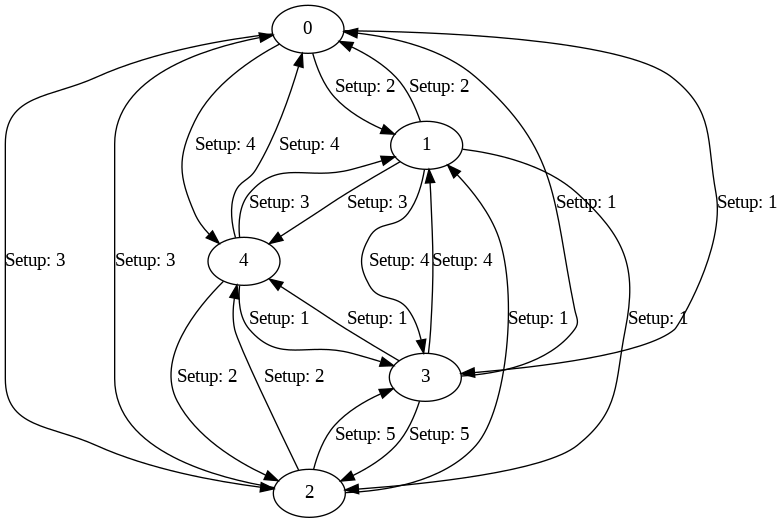

Graph for Iteration 0 displayed.
Iteration 2/100: Best Tardiness = 21.0


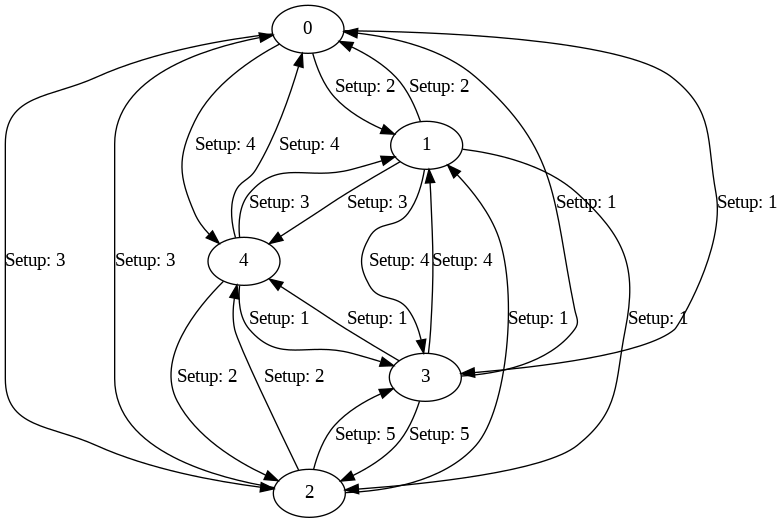

Graph for Iteration 1 displayed.
Iteration 3/100: Best Tardiness = 22.0


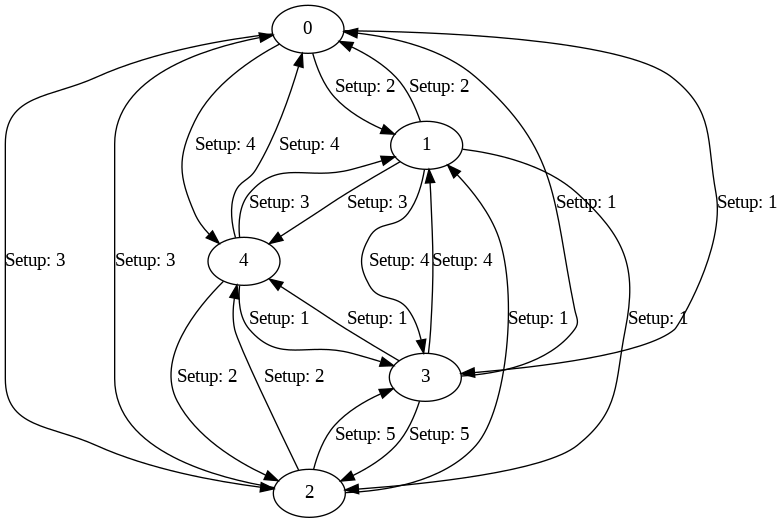

Graph for Iteration 2 displayed.
Iteration 4/100: Best Tardiness = 22.0


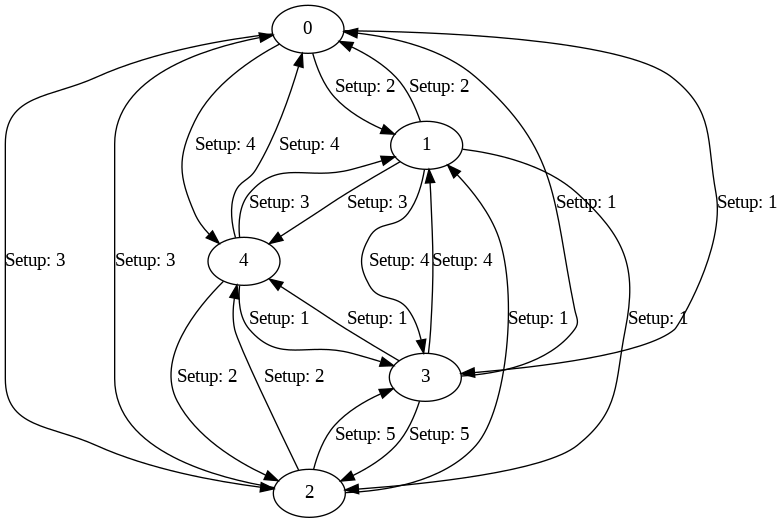

Graph for Iteration 3 displayed.
Iteration 5/100: Best Tardiness = 20.0


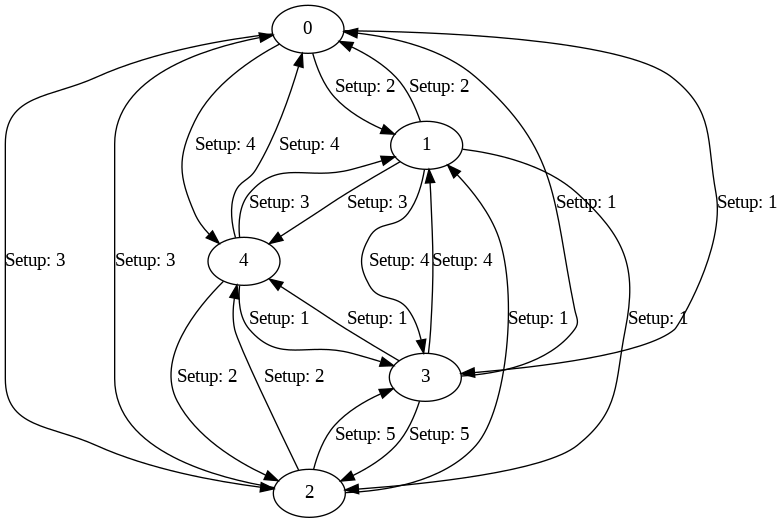

Graph for Iteration 4 displayed.
Iteration 6/100: Best Tardiness = 20.0


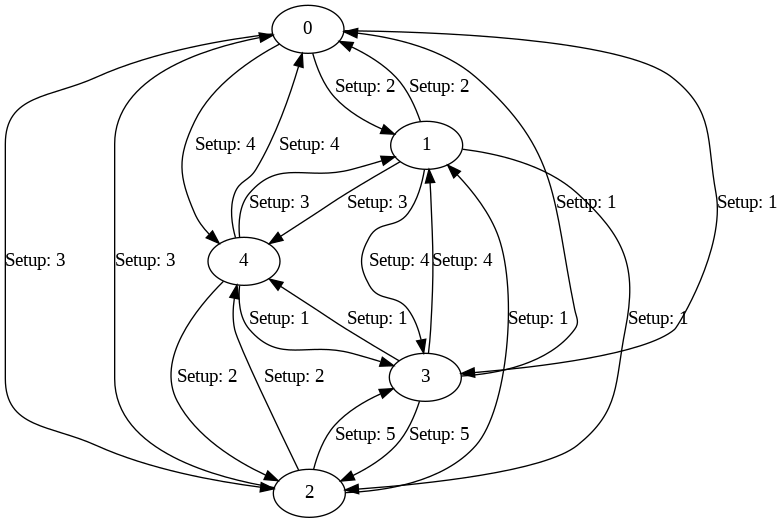

Graph for Iteration 5 displayed.
Iteration 7/100: Best Tardiness = 20.0


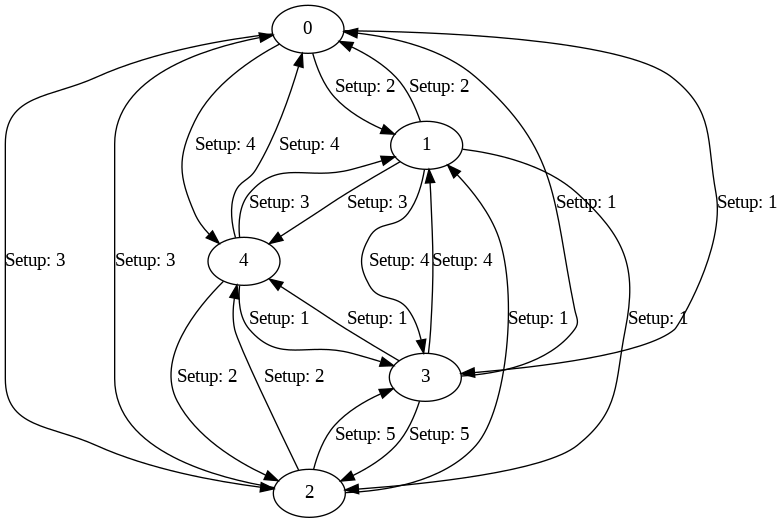

Graph for Iteration 6 displayed.
Iteration 8/100: Best Tardiness = 20.0


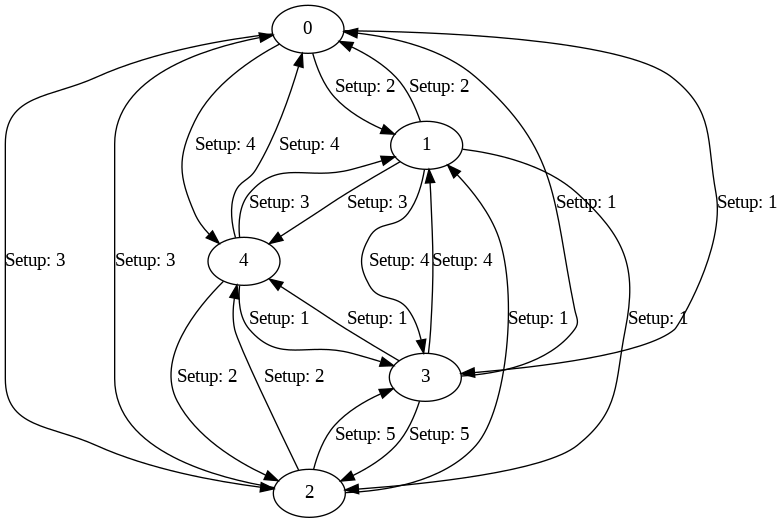

Graph for Iteration 7 displayed.
Iteration 9/100: Best Tardiness = 19.0


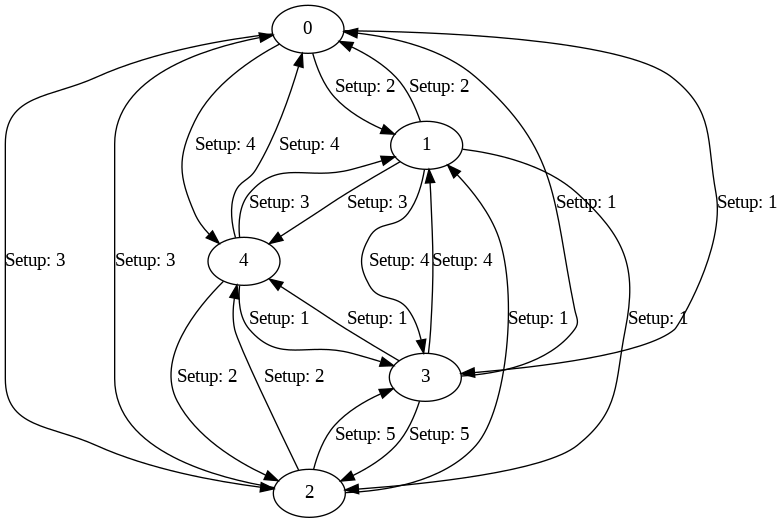

Graph for Iteration 8 displayed.
Iteration 10/100: Best Tardiness = 19.0


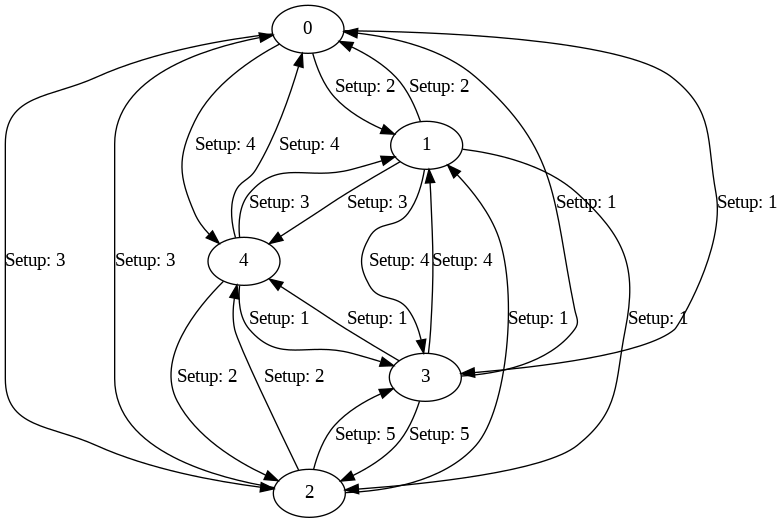

Graph for Iteration 9 displayed.
Iteration 11/100: Best Tardiness = 19.0


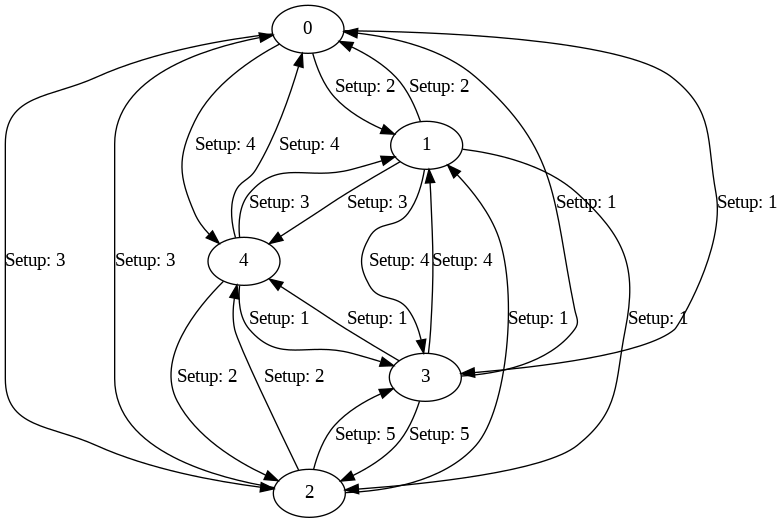

Graph for Iteration 10 displayed.
Iteration 12/100: Best Tardiness = 19.0


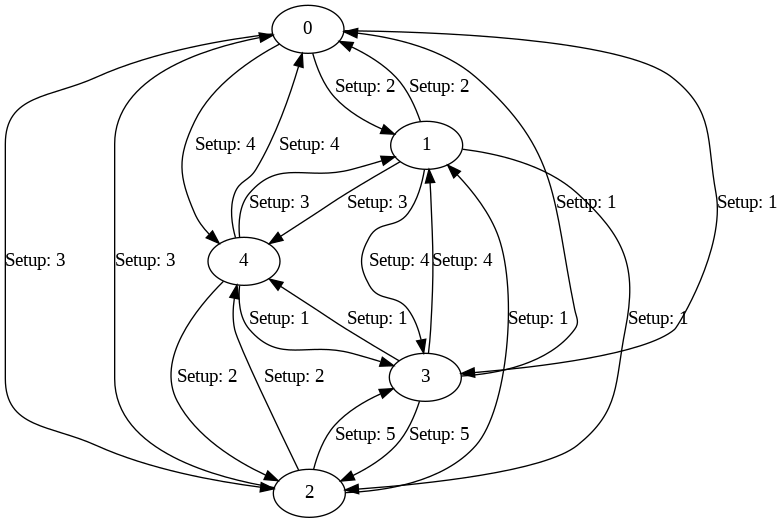

Graph for Iteration 11 displayed.
Iteration 13/100: Best Tardiness = 15.0


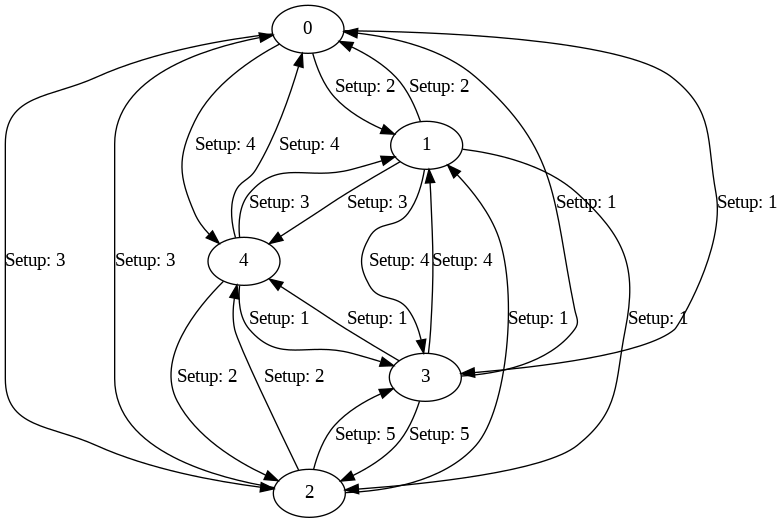

Graph for Iteration 12 displayed.
Iteration 14/100: Best Tardiness = 15.0


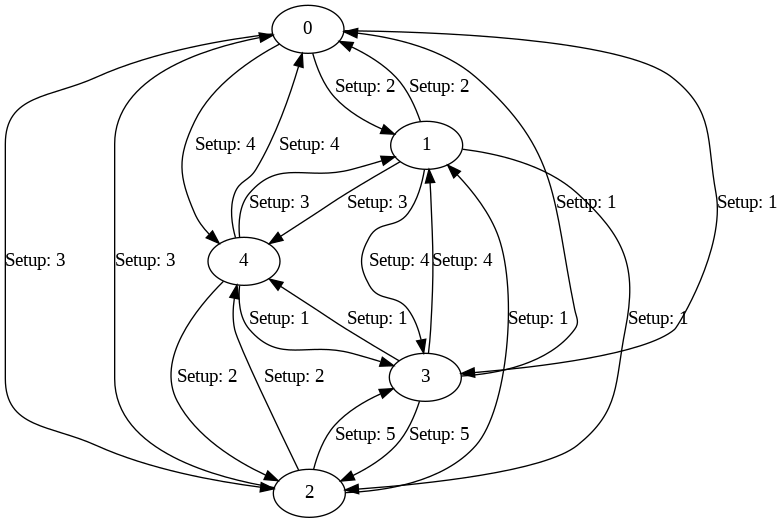

Graph for Iteration 13 displayed.
Iteration 15/100: Best Tardiness = 15.0


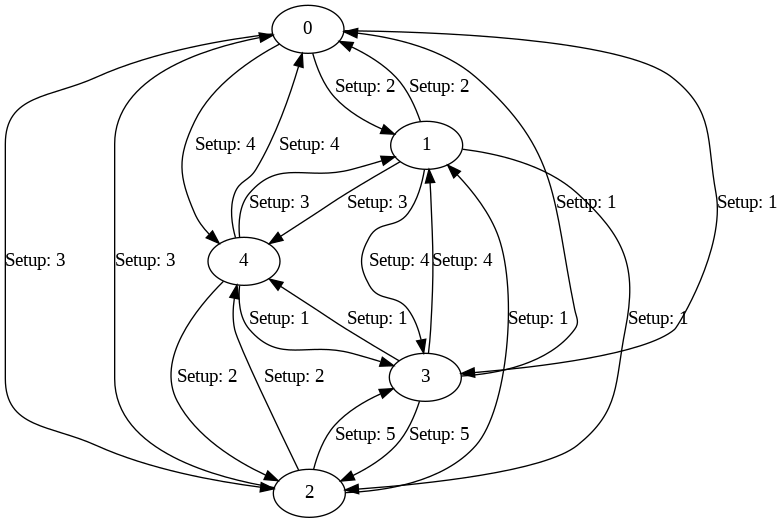

Graph for Iteration 14 displayed.
Iteration 16/100: Best Tardiness = 19.0


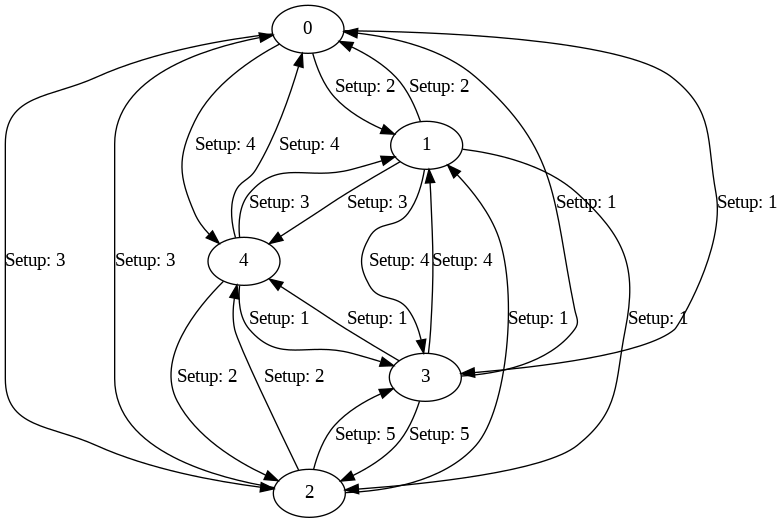

Graph for Iteration 15 displayed.
Iteration 17/100: Best Tardiness = 15.0


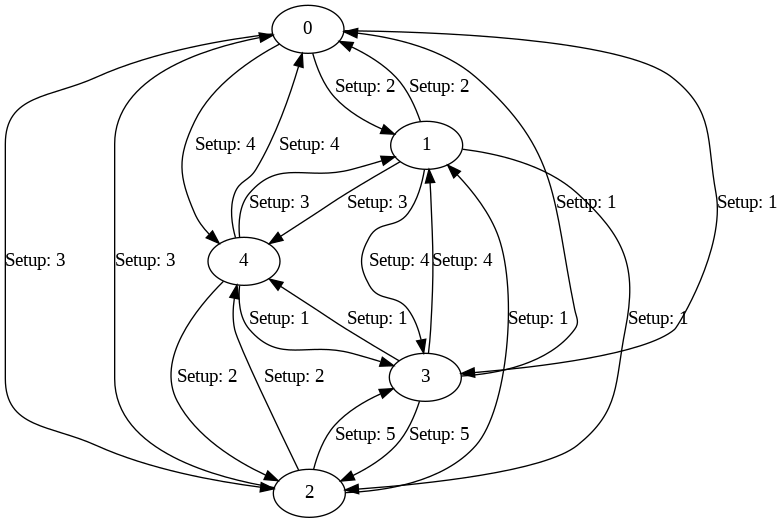

Graph for Iteration 16 displayed.
Iteration 18/100: Best Tardiness = 15.0


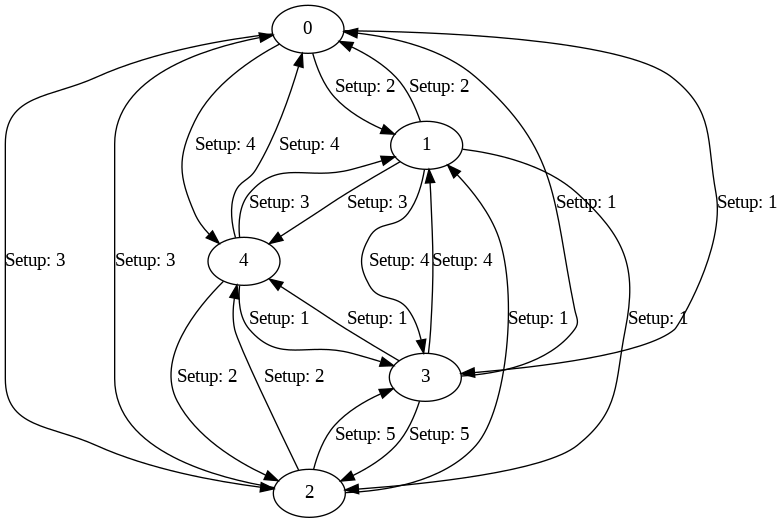

Graph for Iteration 17 displayed.
Iteration 19/100: Best Tardiness = 15.0


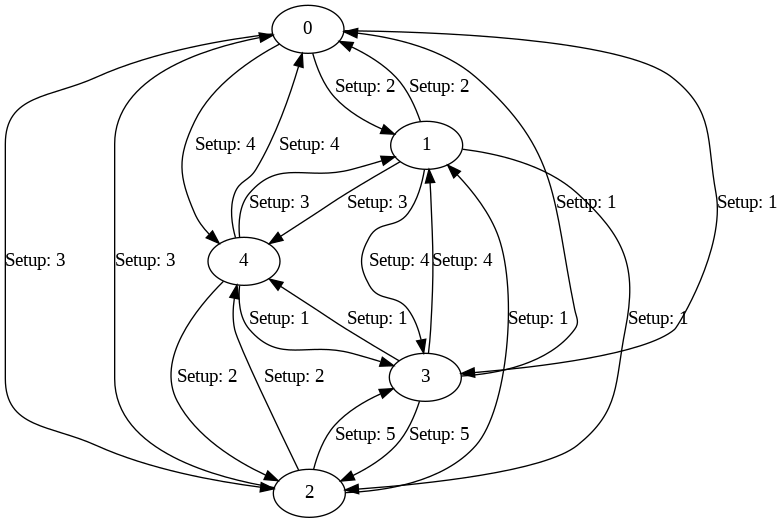

Graph for Iteration 18 displayed.
Iteration 20/100: Best Tardiness = 15.0


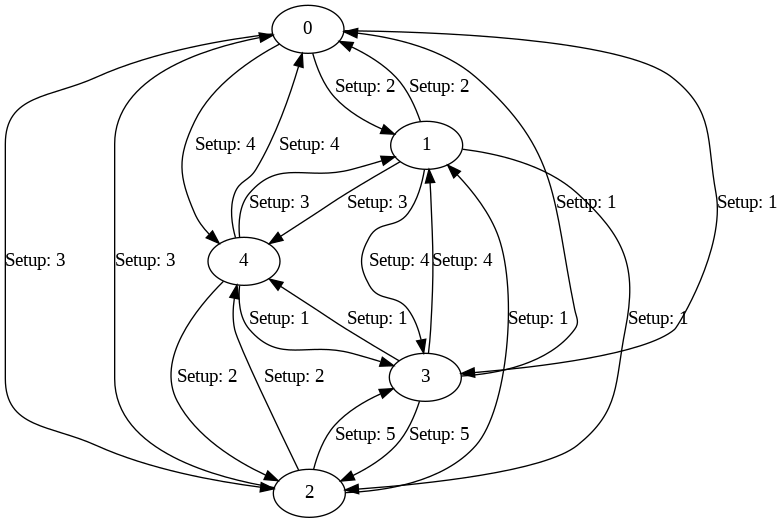

Graph for Iteration 19 displayed.
Iteration 21/100: Best Tardiness = 15.0


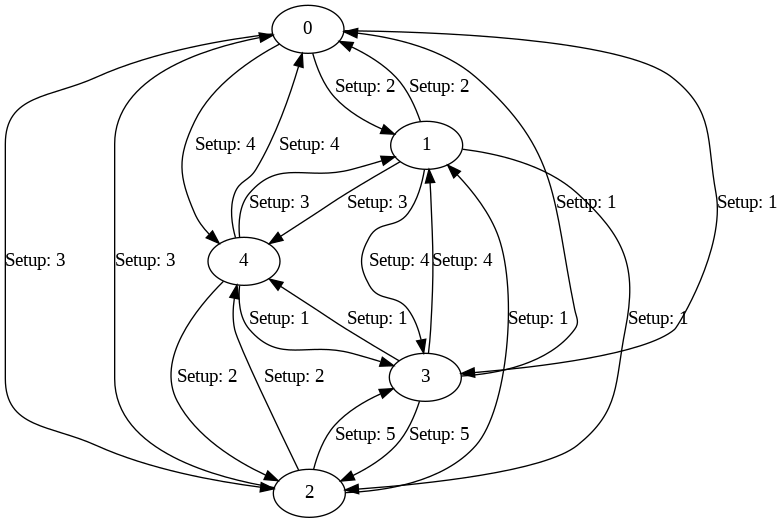

Graph for Iteration 20 displayed.
Iteration 22/100: Best Tardiness = 19.0


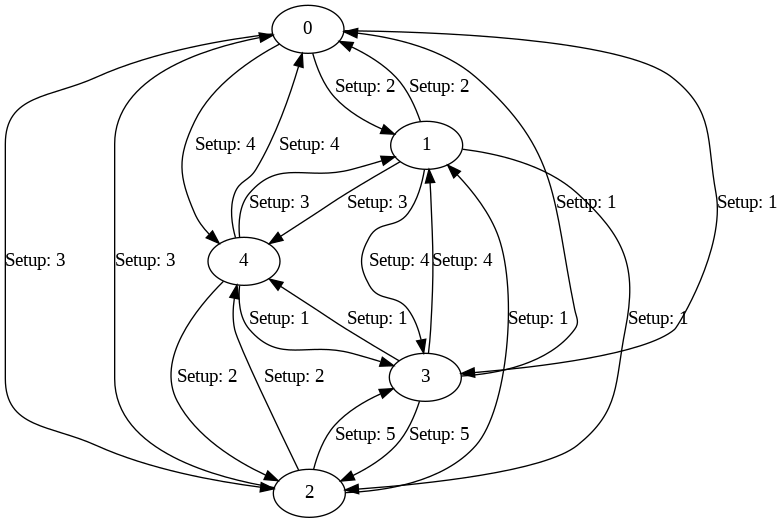

Graph for Iteration 21 displayed.
Iteration 23/100: Best Tardiness = 15.0


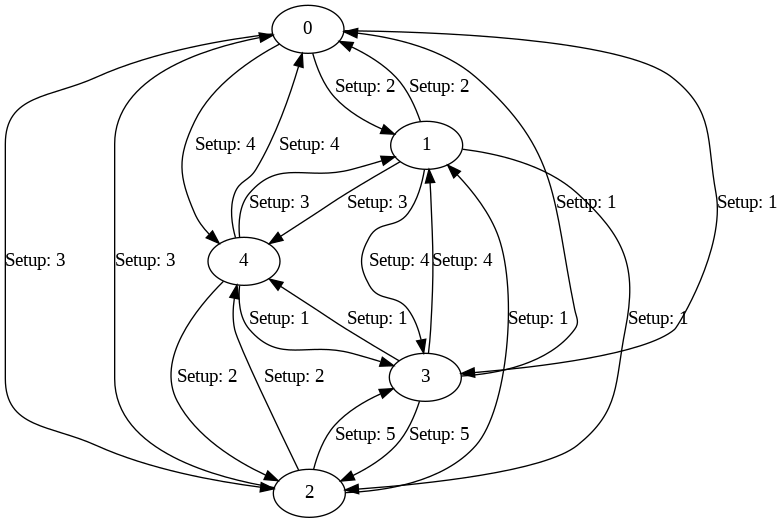

Graph for Iteration 22 displayed.
Iteration 24/100: Best Tardiness = 15.0


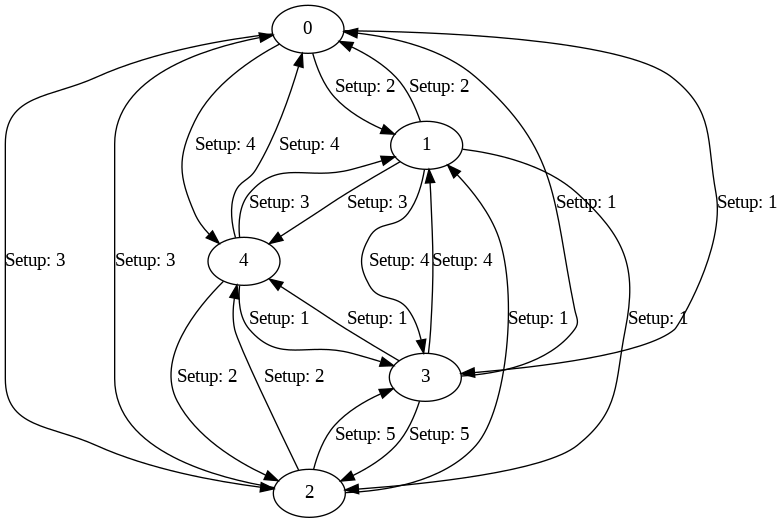

Graph for Iteration 23 displayed.
Iteration 25/100: Best Tardiness = 15.0


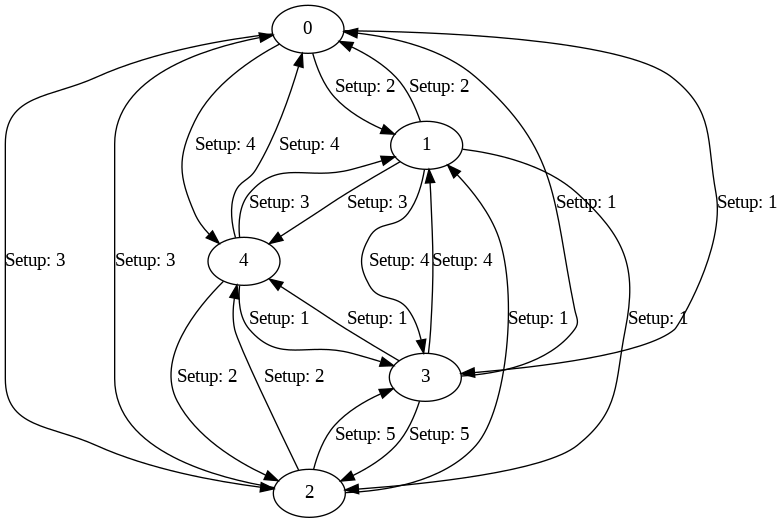

Graph for Iteration 24 displayed.
Iteration 26/100: Best Tardiness = 19.0


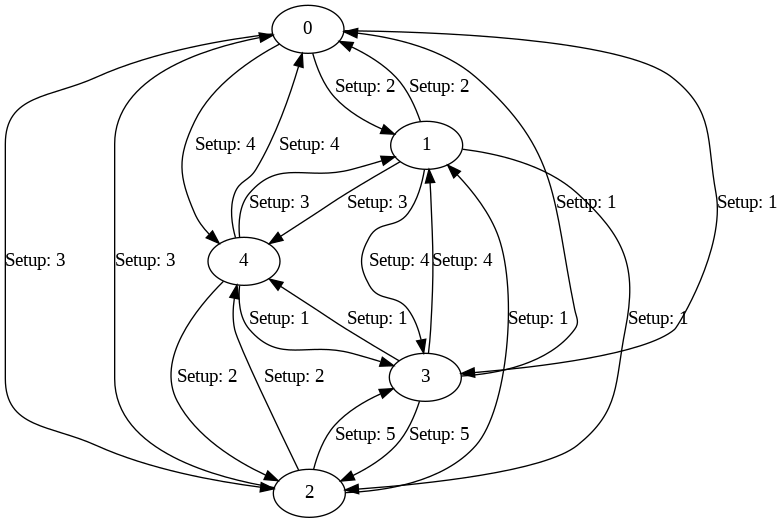

Graph for Iteration 25 displayed.
Iteration 27/100: Best Tardiness = 19.0


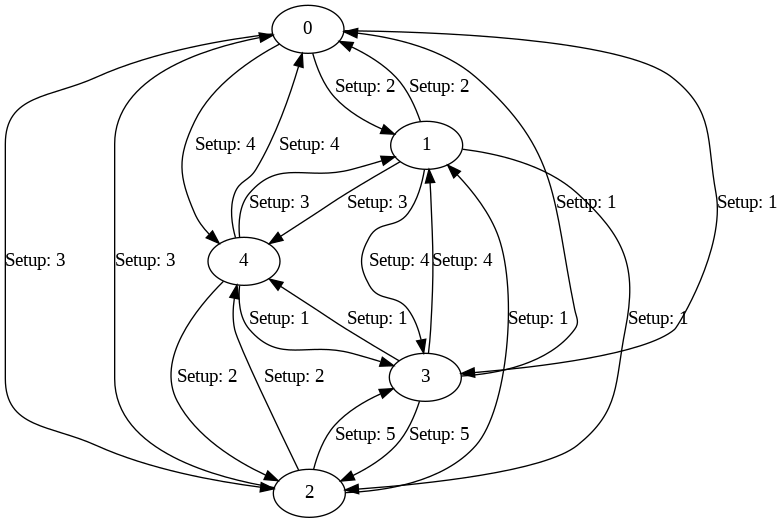

Graph for Iteration 26 displayed.
Iteration 28/100: Best Tardiness = 19.0


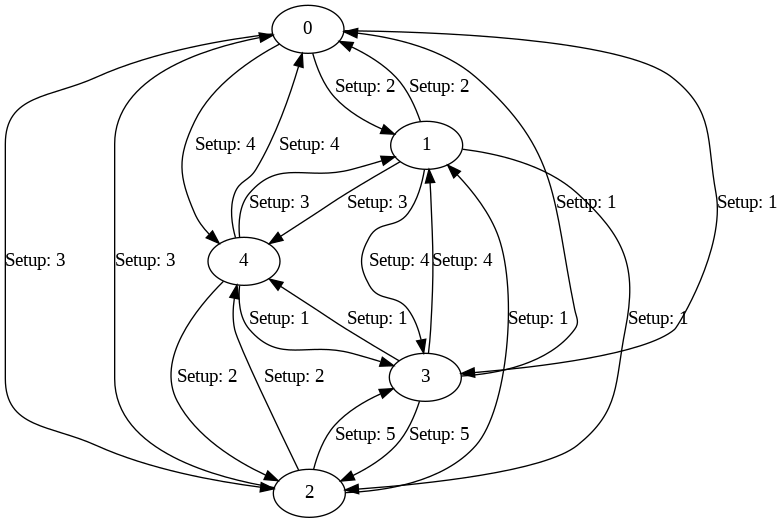

Graph for Iteration 27 displayed.
Iteration 29/100: Best Tardiness = 19.0


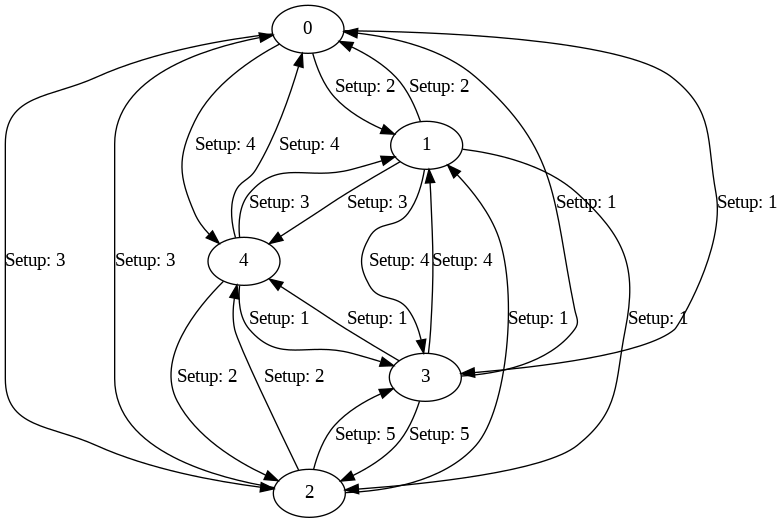

Graph for Iteration 28 displayed.
Iteration 30/100: Best Tardiness = 19.0


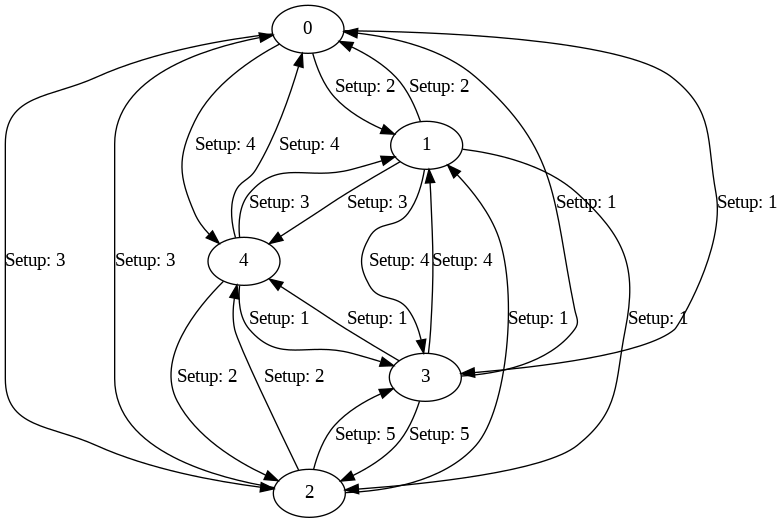

Graph for Iteration 29 displayed.
Iteration 31/100: Best Tardiness = 19.0


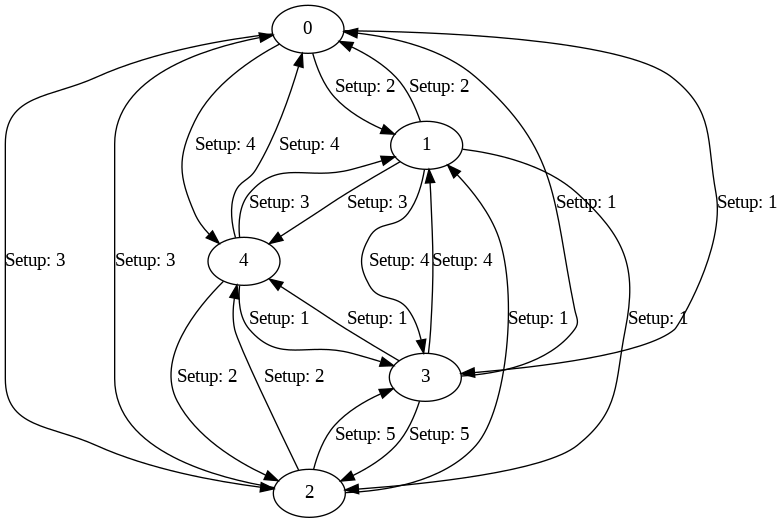

Graph for Iteration 30 displayed.
Iteration 32/100: Best Tardiness = 20.0


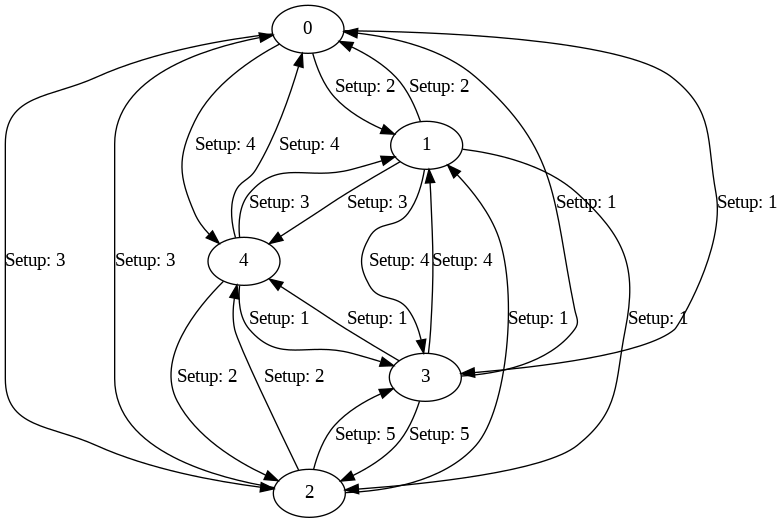

Graph for Iteration 31 displayed.
Iteration 33/100: Best Tardiness = 20.0


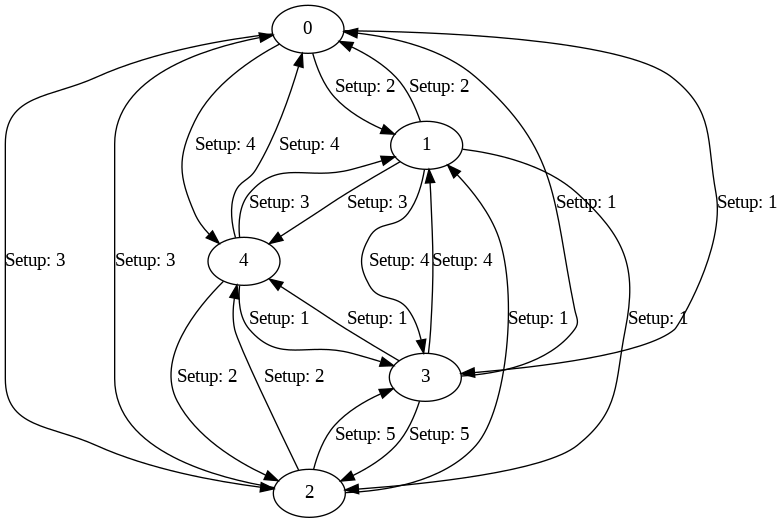

Graph for Iteration 32 displayed.
Iteration 34/100: Best Tardiness = 20.0


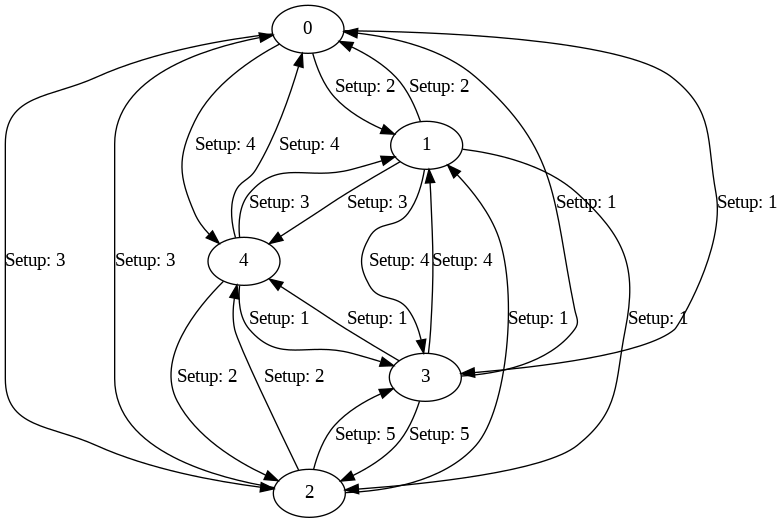

Graph for Iteration 33 displayed.
Iteration 35/100: Best Tardiness = 20.0


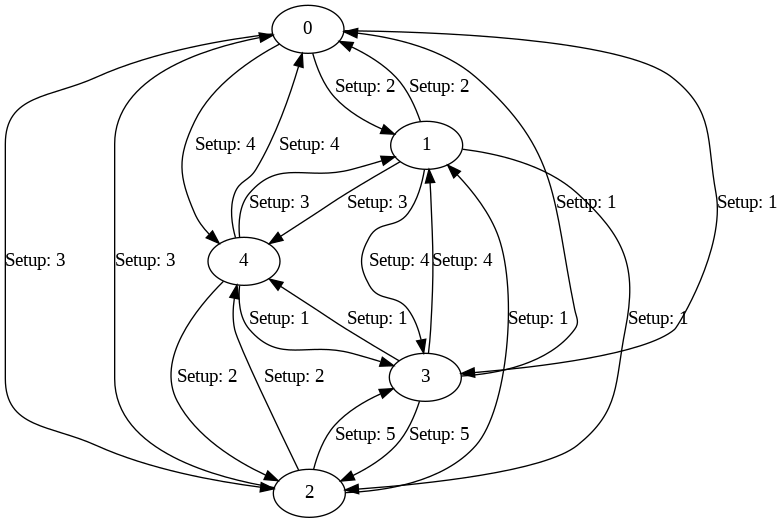

Graph for Iteration 34 displayed.
Iteration 36/100: Best Tardiness = 20.0


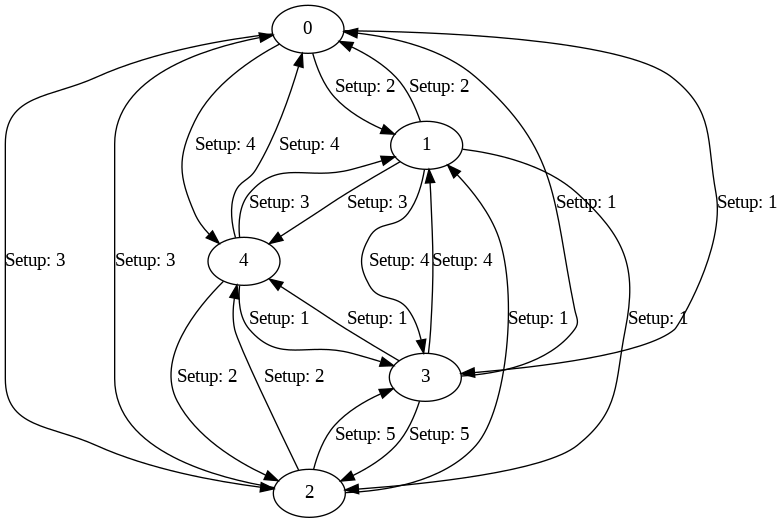

Graph for Iteration 35 displayed.
Iteration 37/100: Best Tardiness = 20.0


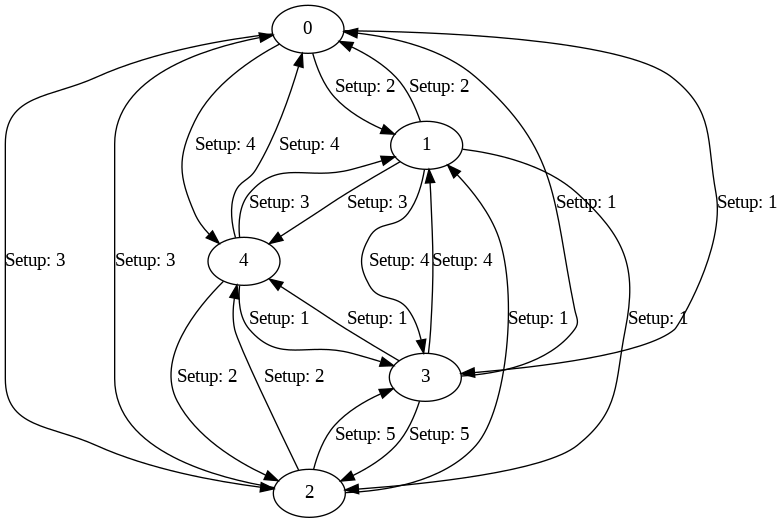

Graph for Iteration 36 displayed.
Iteration 38/100: Best Tardiness = 20.0


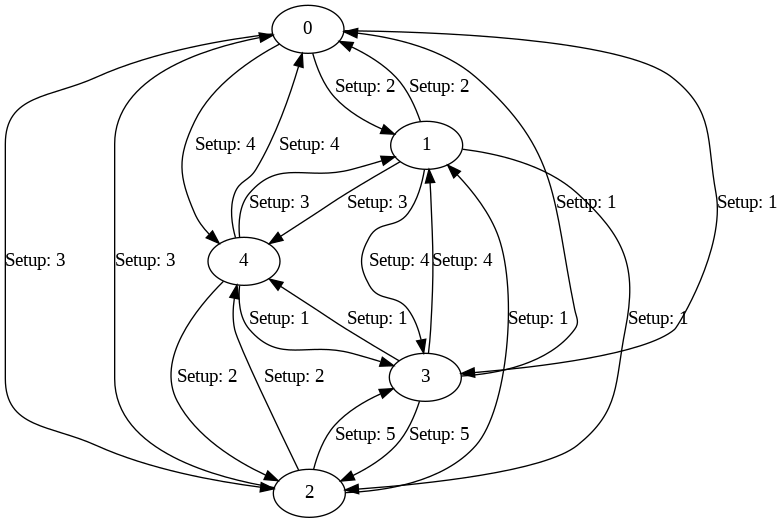

Graph for Iteration 37 displayed.
Iteration 39/100: Best Tardiness = 15.0


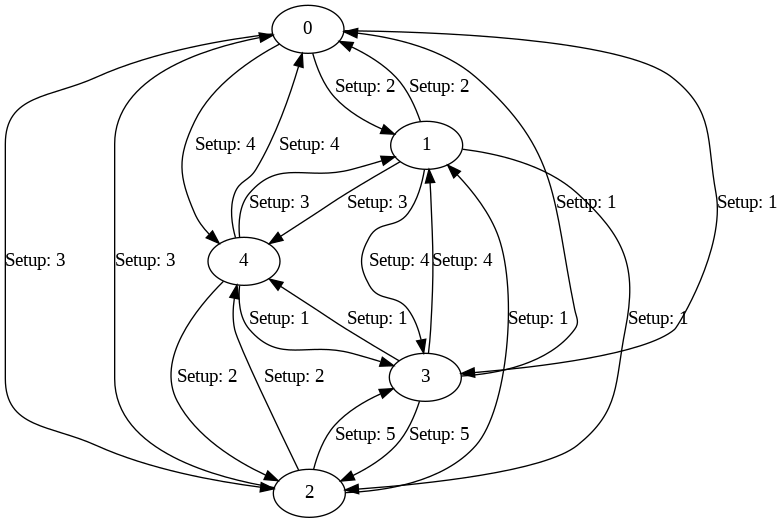

Graph for Iteration 38 displayed.
Iteration 40/100: Best Tardiness = 15.0


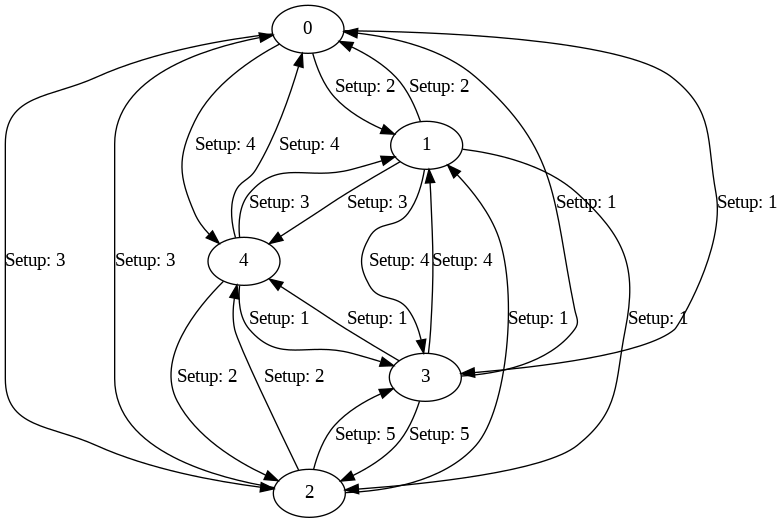

Graph for Iteration 39 displayed.
Iteration 41/100: Best Tardiness = 19.0


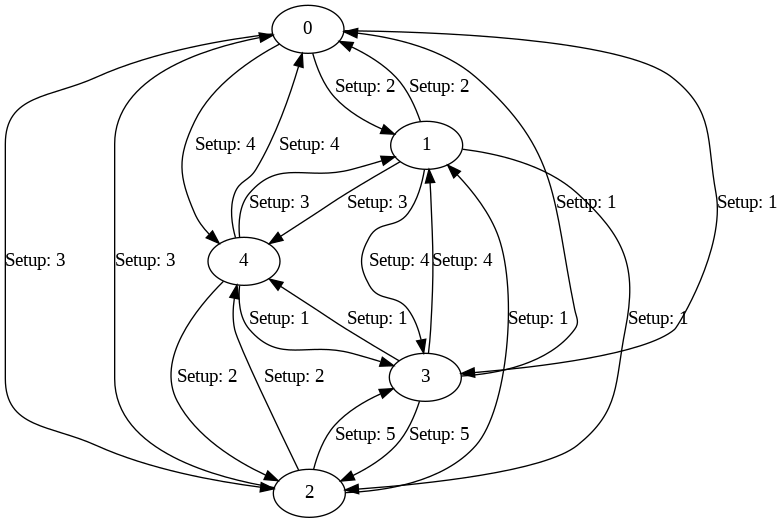

Graph for Iteration 40 displayed.
Iteration 42/100: Best Tardiness = 19.0


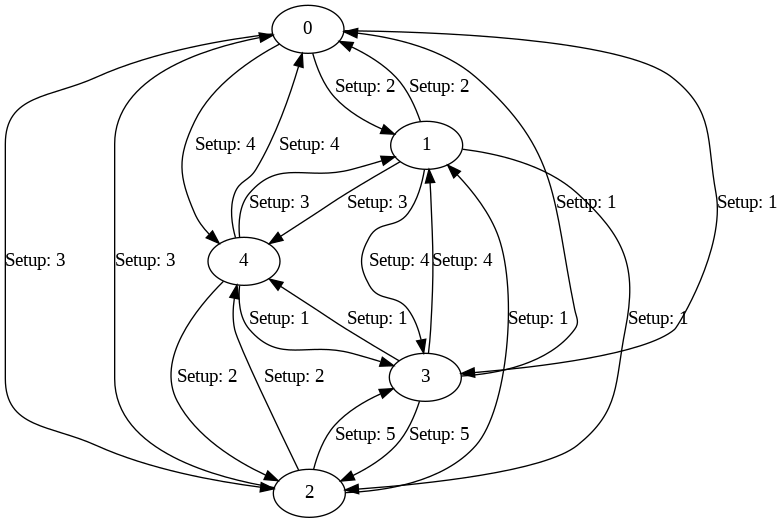

Graph for Iteration 41 displayed.
Iteration 43/100: Best Tardiness = 19.0


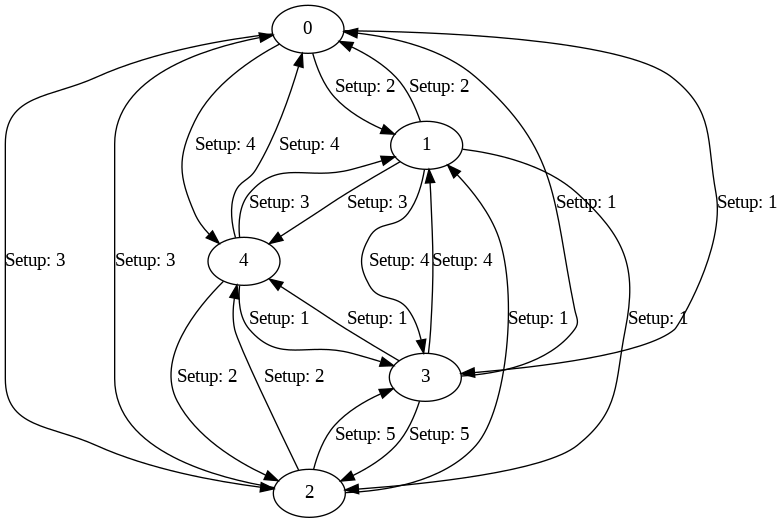

Graph for Iteration 42 displayed.
Iteration 44/100: Best Tardiness = 19.0


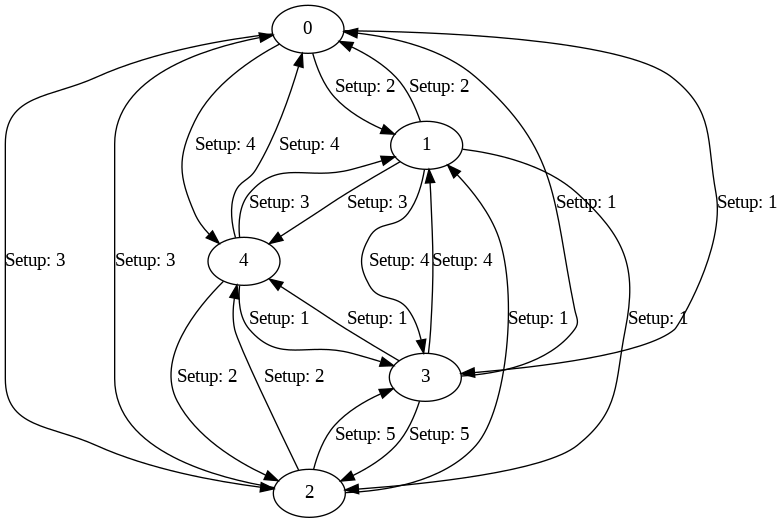

Graph for Iteration 43 displayed.
Iteration 45/100: Best Tardiness = 20.0


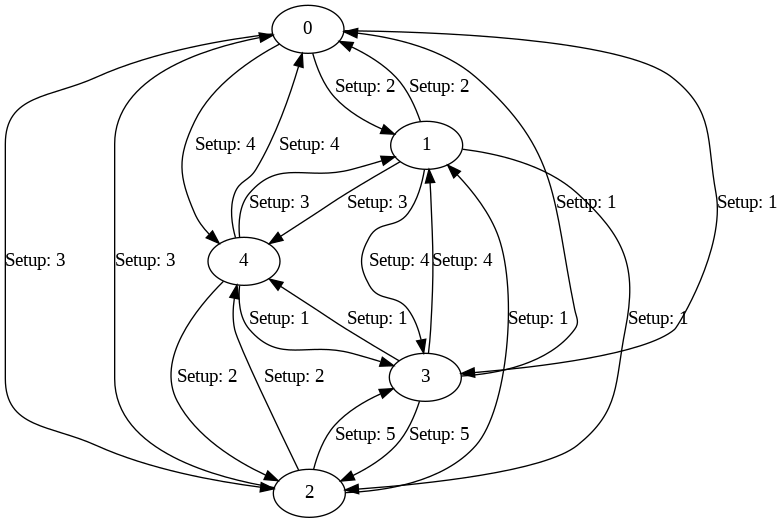

Graph for Iteration 44 displayed.
Iteration 46/100: Best Tardiness = 20.0


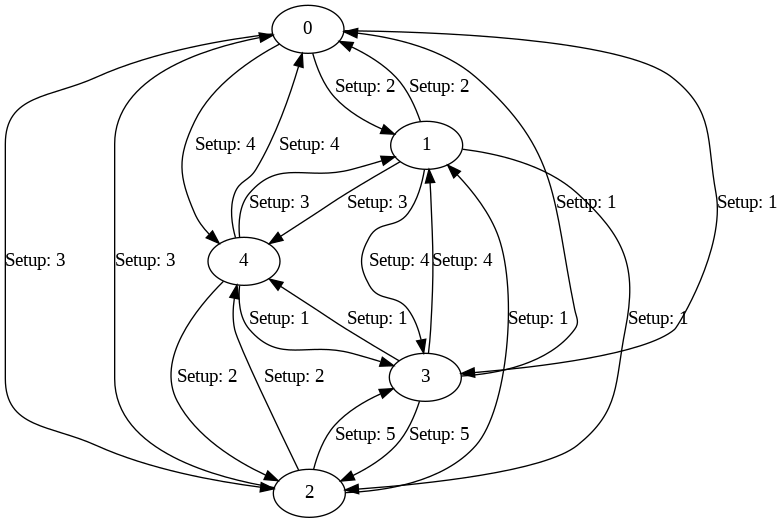

Graph for Iteration 45 displayed.
Iteration 47/100: Best Tardiness = 20.0


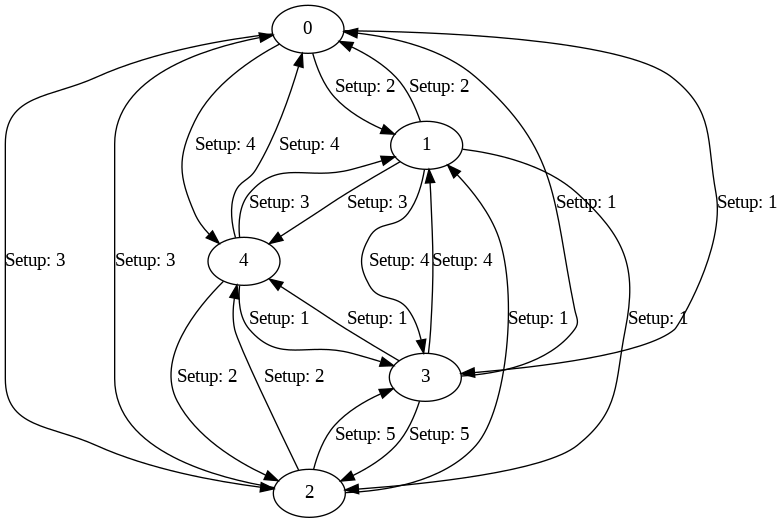

Graph for Iteration 46 displayed.
Iteration 48/100: Best Tardiness = 20.0


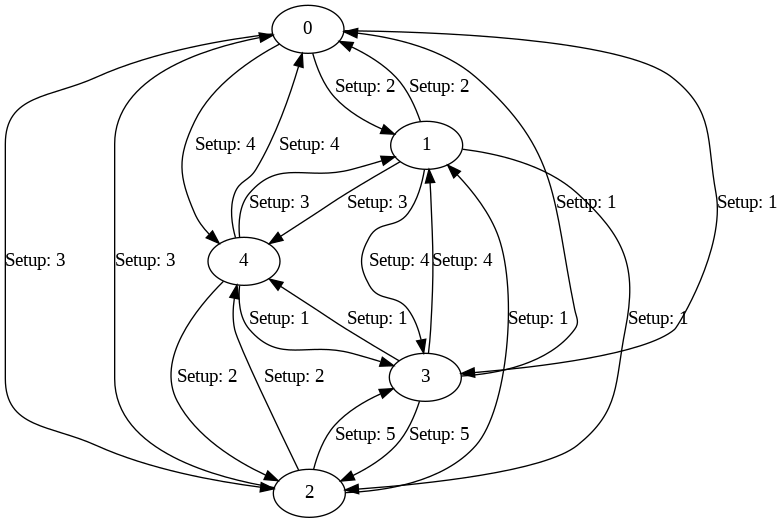

Graph for Iteration 47 displayed.
Iteration 49/100: Best Tardiness = 20.0


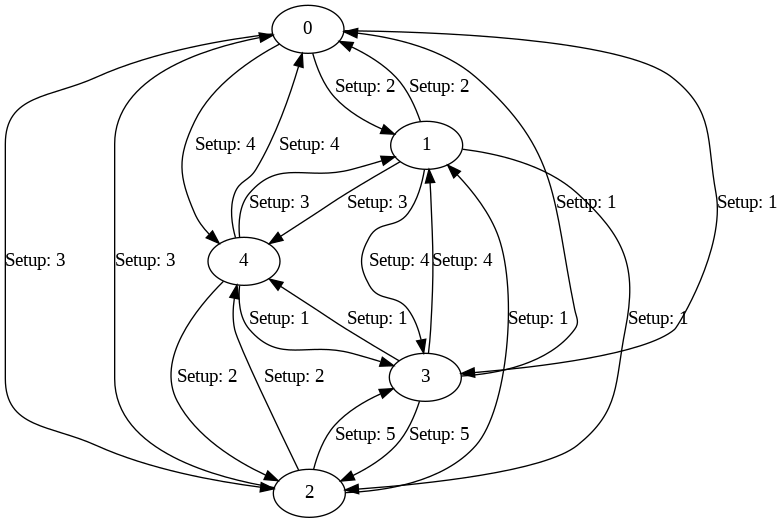

Graph for Iteration 48 displayed.
Iteration 50/100: Best Tardiness = 20.0


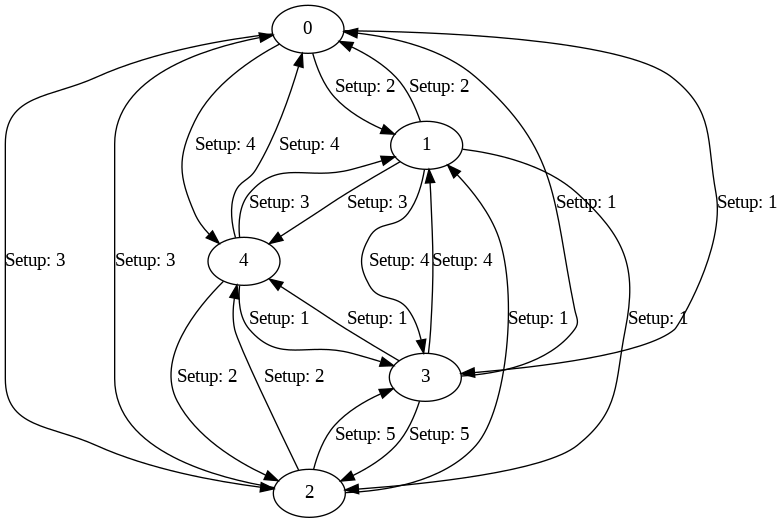

Graph for Iteration 49 displayed.
Iteration 51/100: Best Tardiness = 20.0


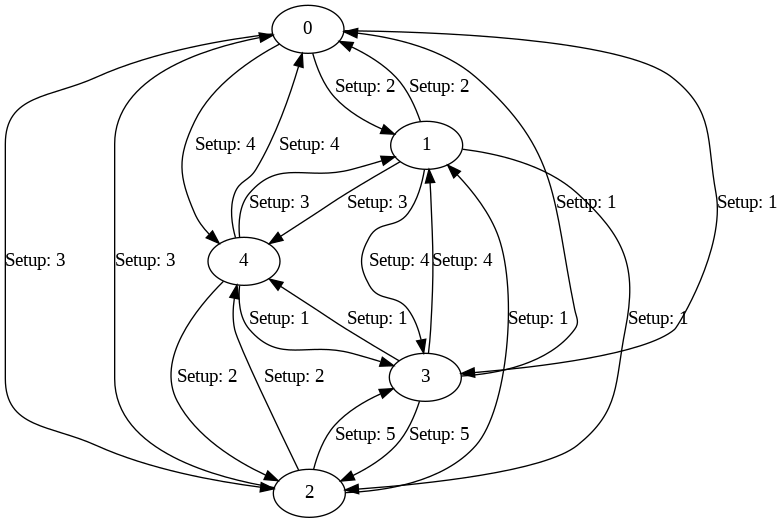

Graph for Iteration 50 displayed.
Iteration 52/100: Best Tardiness = 20.0


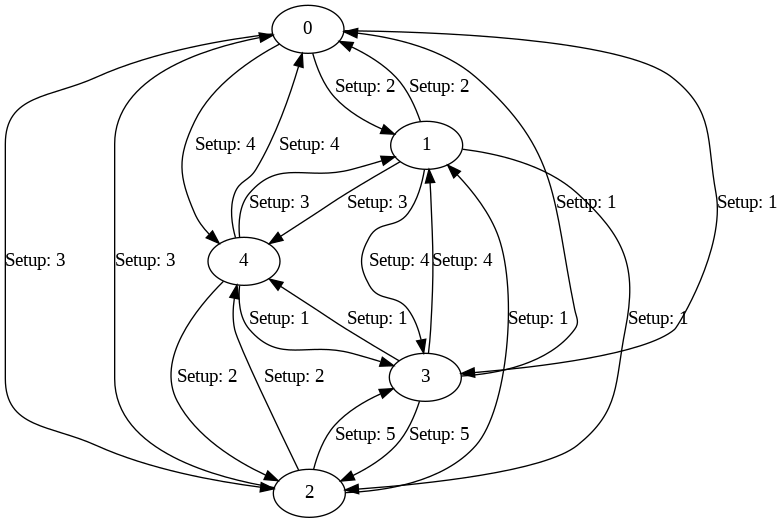

Graph for Iteration 51 displayed.
Iteration 53/100: Best Tardiness = 20.0


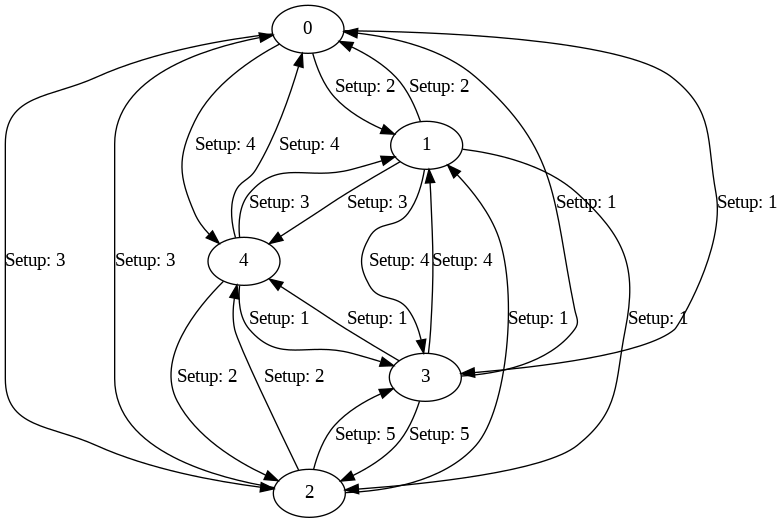

Graph for Iteration 52 displayed.
Iteration 54/100: Best Tardiness = 20.0


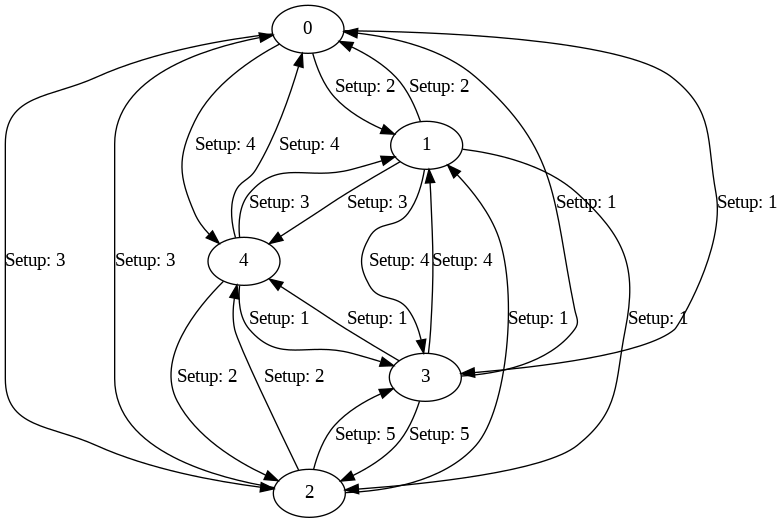

Graph for Iteration 53 displayed.
Iteration 55/100: Best Tardiness = 20.0


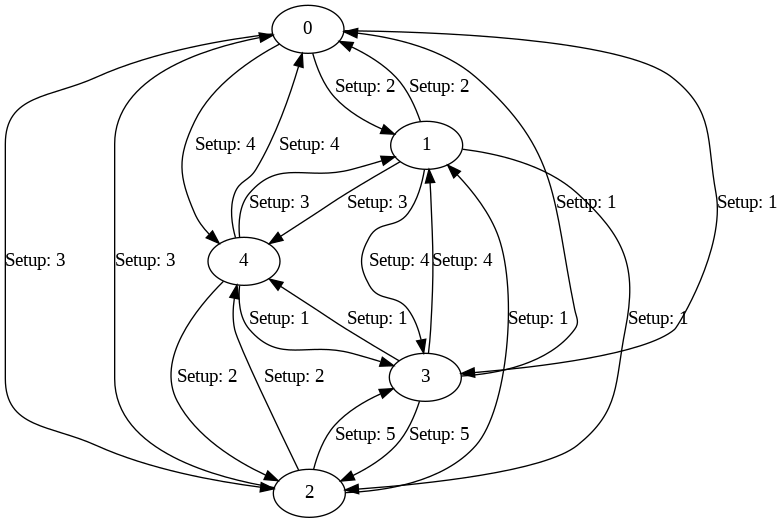

Graph for Iteration 54 displayed.
Iteration 56/100: Best Tardiness = 20.0


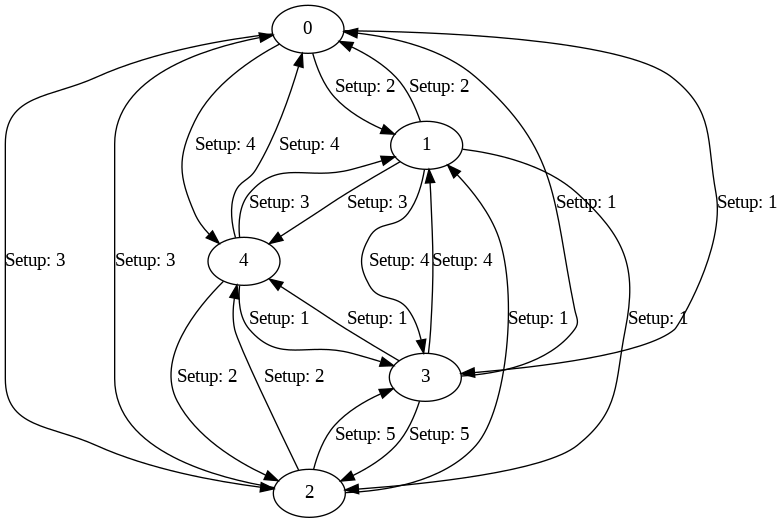

Graph for Iteration 55 displayed.
Iteration 57/100: Best Tardiness = 20.0


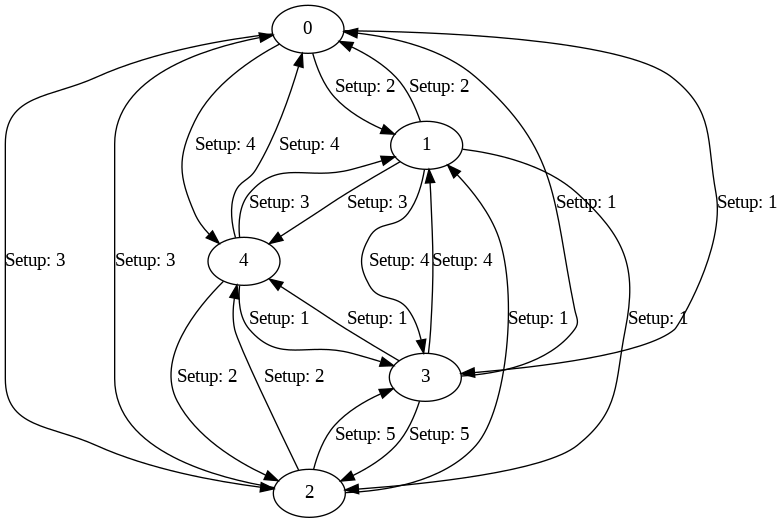

Graph for Iteration 56 displayed.
Iteration 58/100: Best Tardiness = 20.0


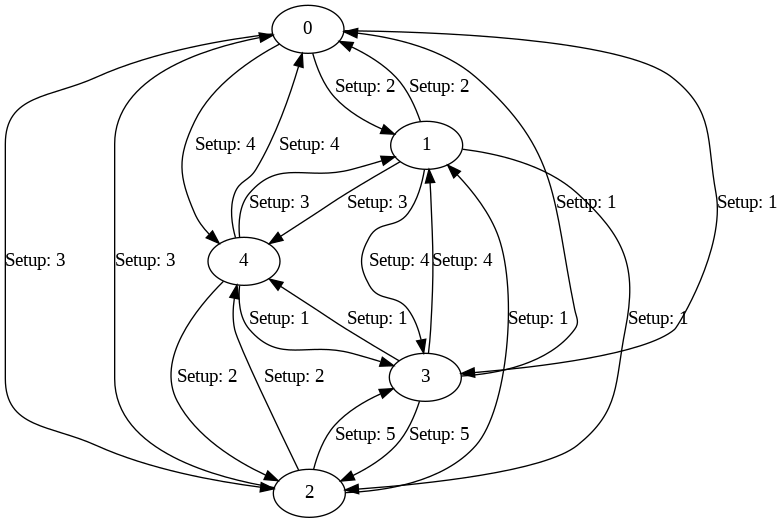

Graph for Iteration 57 displayed.
Iteration 59/100: Best Tardiness = 20.0


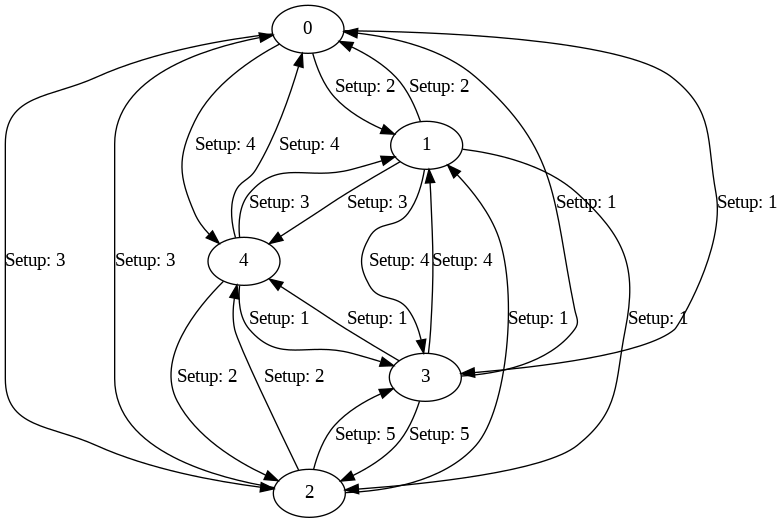

Graph for Iteration 58 displayed.
Iteration 60/100: Best Tardiness = 20.0


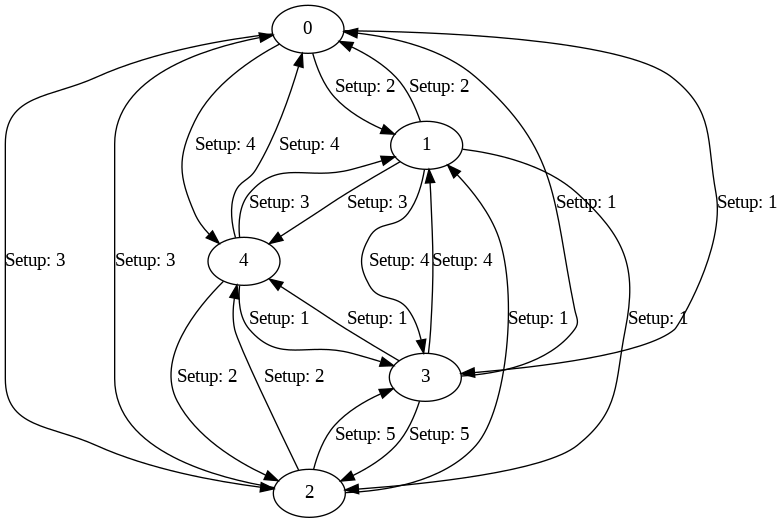

Graph for Iteration 59 displayed.
Iteration 61/100: Best Tardiness = 21.0


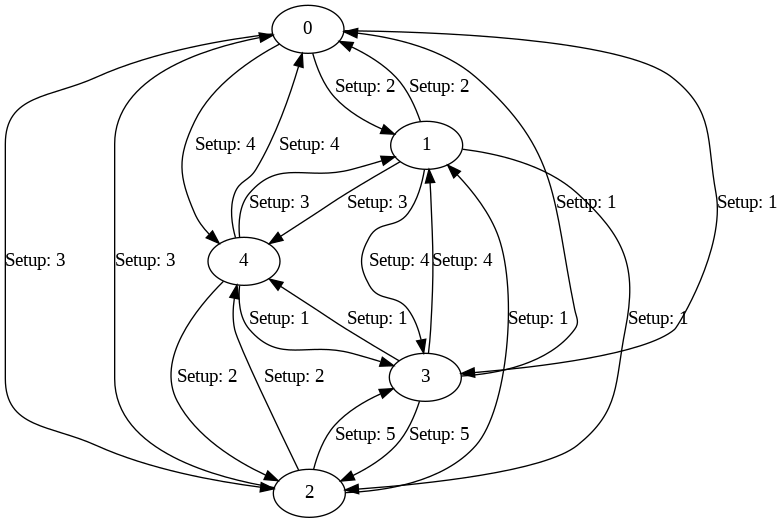

Graph for Iteration 60 displayed.
Iteration 62/100: Best Tardiness = 20.0


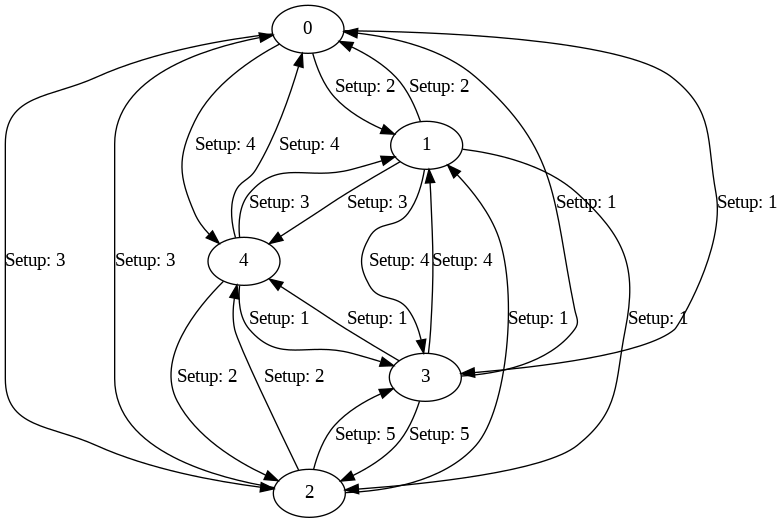

Graph for Iteration 61 displayed.
Iteration 63/100: Best Tardiness = 21.0


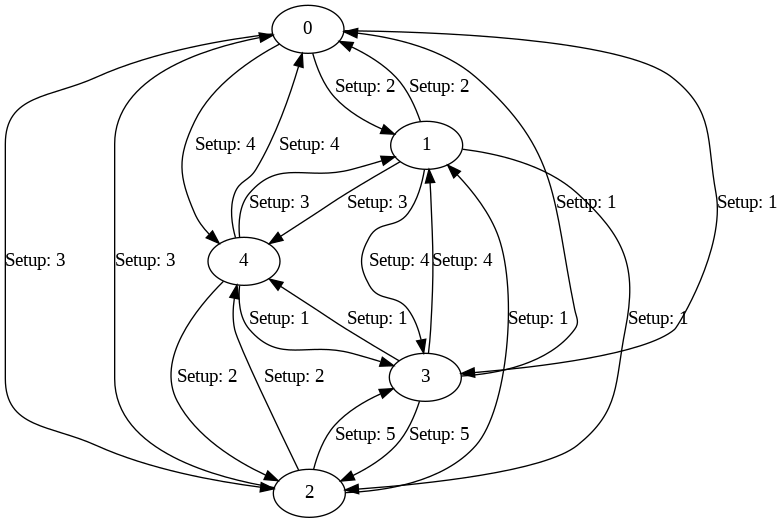

Graph for Iteration 62 displayed.
Iteration 64/100: Best Tardiness = 20.0


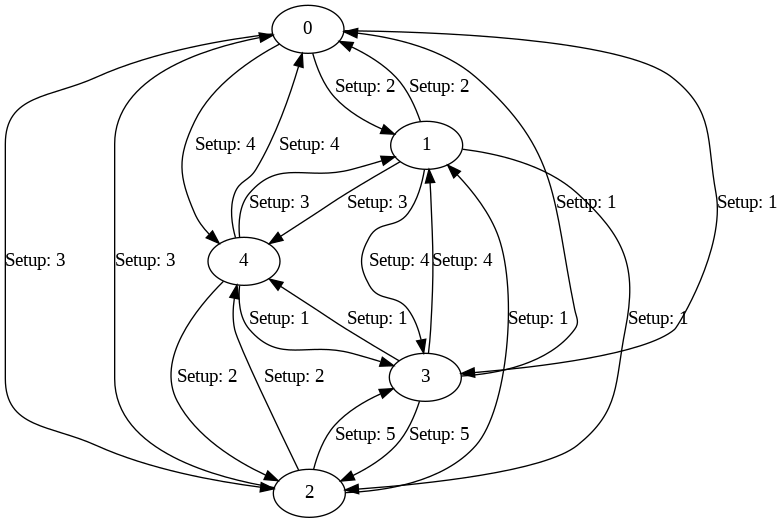

Graph for Iteration 63 displayed.
Iteration 65/100: Best Tardiness = 20.0


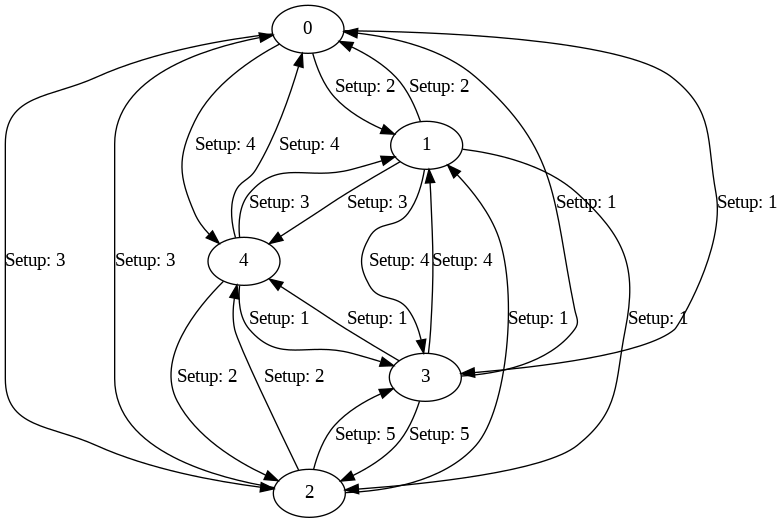

Graph for Iteration 64 displayed.
Iteration 66/100: Best Tardiness = 21.0


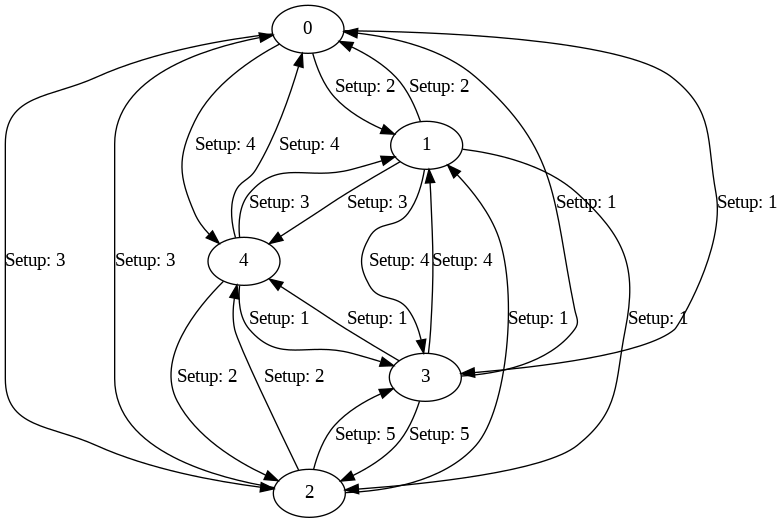

Graph for Iteration 65 displayed.
Iteration 67/100: Best Tardiness = 21.0


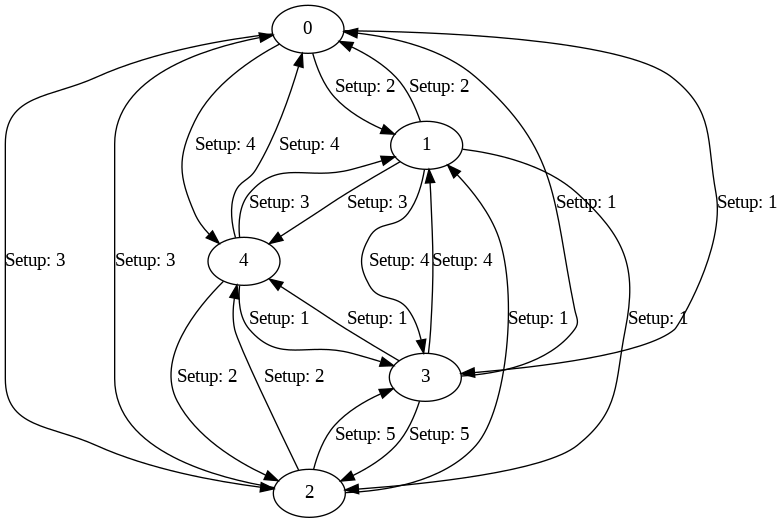

Graph for Iteration 66 displayed.
Iteration 68/100: Best Tardiness = 21.0


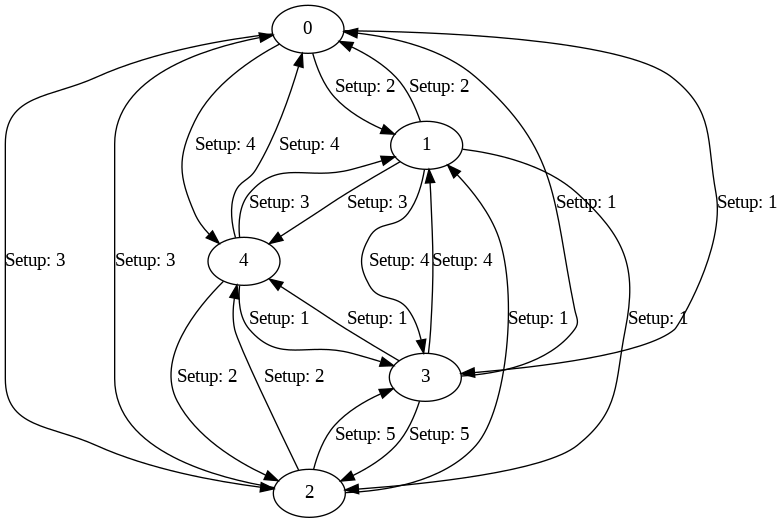

Graph for Iteration 67 displayed.
Iteration 69/100: Best Tardiness = 21.0


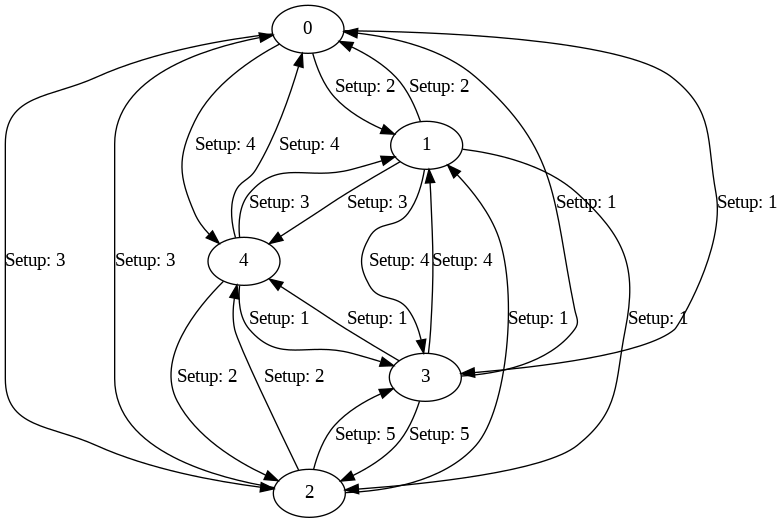

Graph for Iteration 68 displayed.
Iteration 70/100: Best Tardiness = 20.0


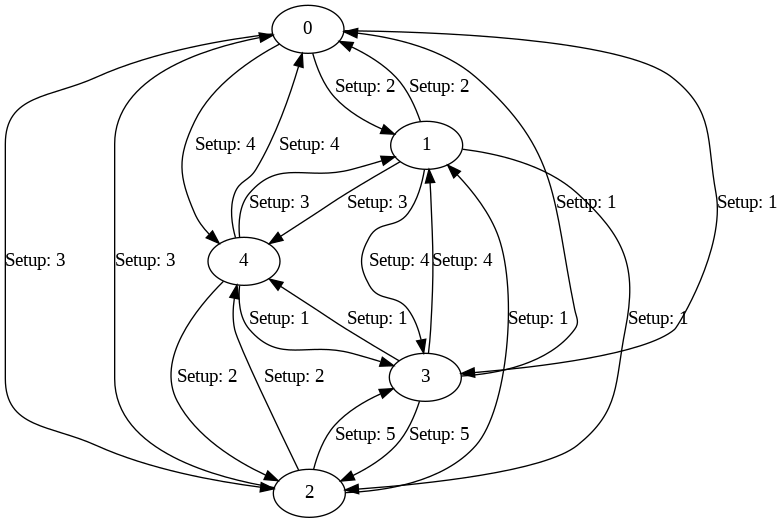

Graph for Iteration 69 displayed.
Iteration 71/100: Best Tardiness = 20.0


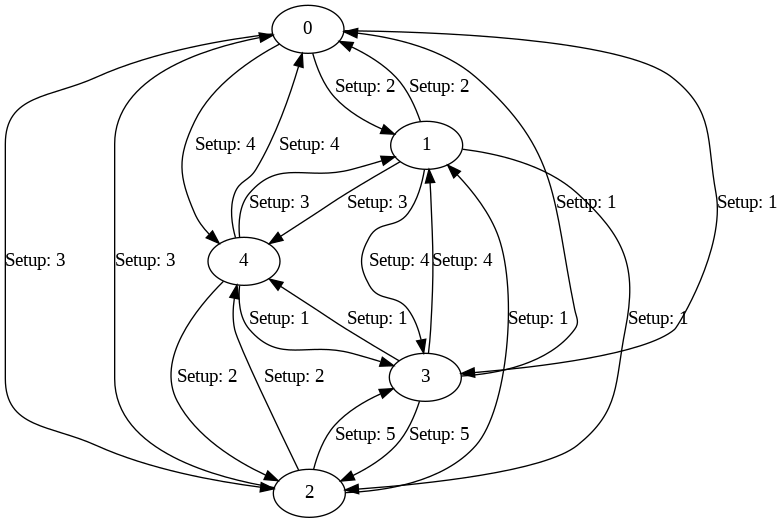

Graph for Iteration 70 displayed.
Iteration 72/100: Best Tardiness = 20.0


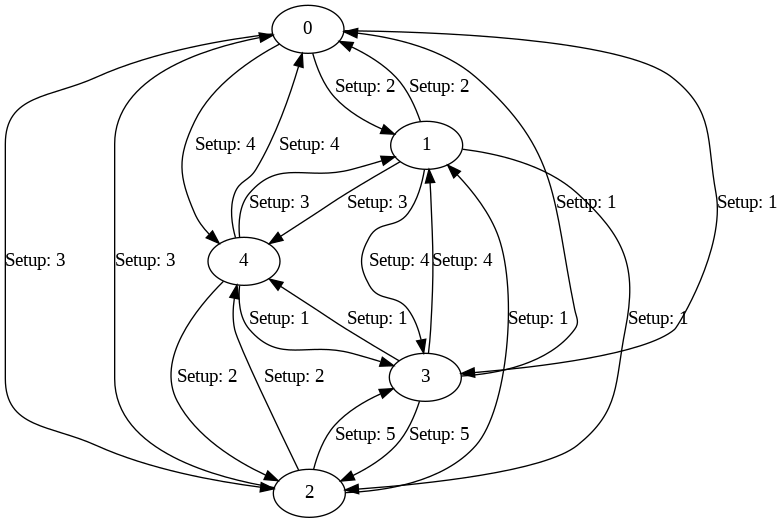

Graph for Iteration 71 displayed.
Iteration 73/100: Best Tardiness = 20.0


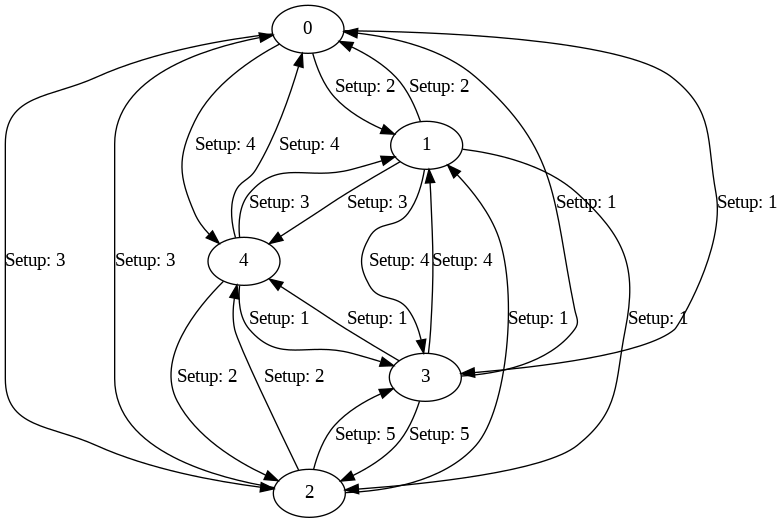

Graph for Iteration 72 displayed.
Iteration 74/100: Best Tardiness = 20.0


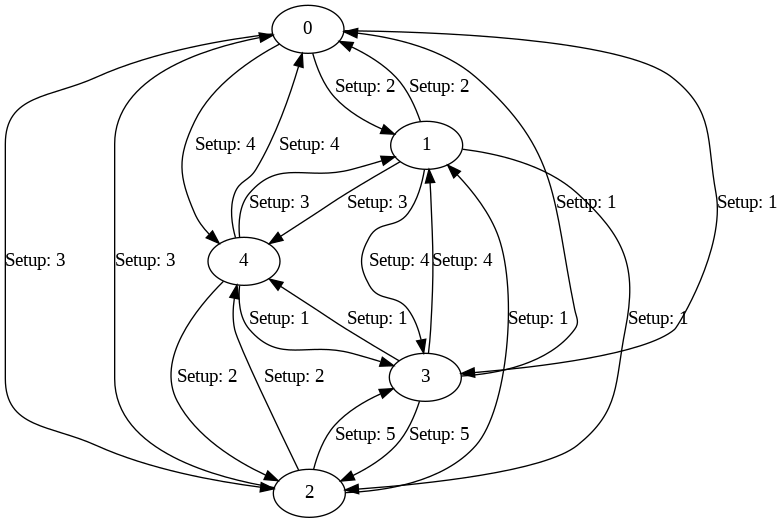

Graph for Iteration 73 displayed.
Iteration 75/100: Best Tardiness = 20.0


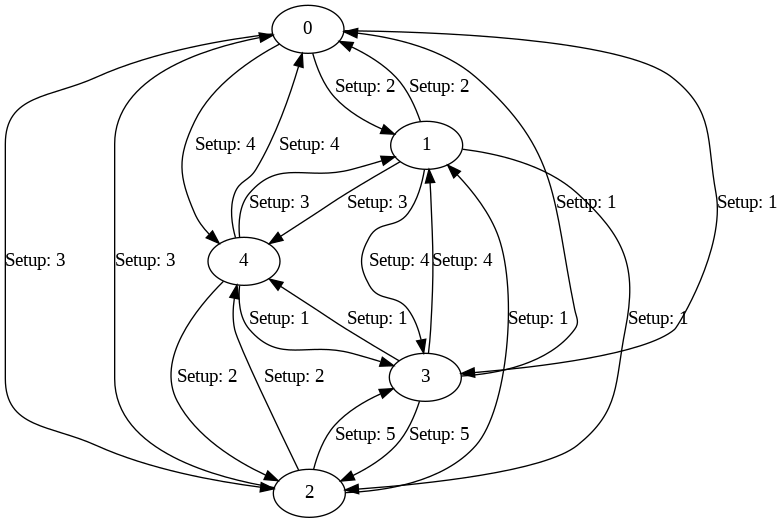

Graph for Iteration 74 displayed.
Iteration 76/100: Best Tardiness = 20.0


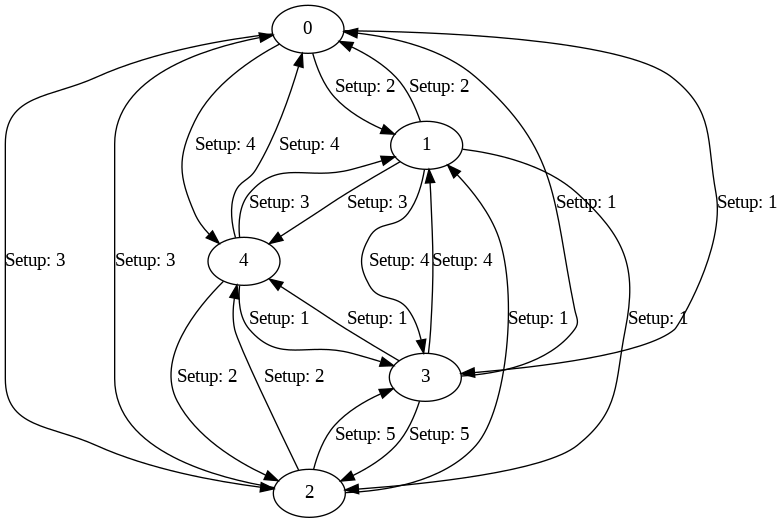

Graph for Iteration 75 displayed.
Iteration 77/100: Best Tardiness = 20.0


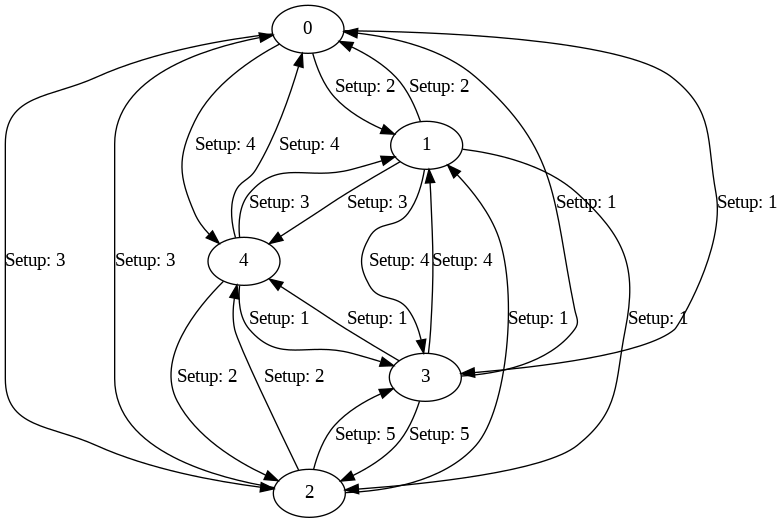

Graph for Iteration 76 displayed.
Iteration 78/100: Best Tardiness = 20.0


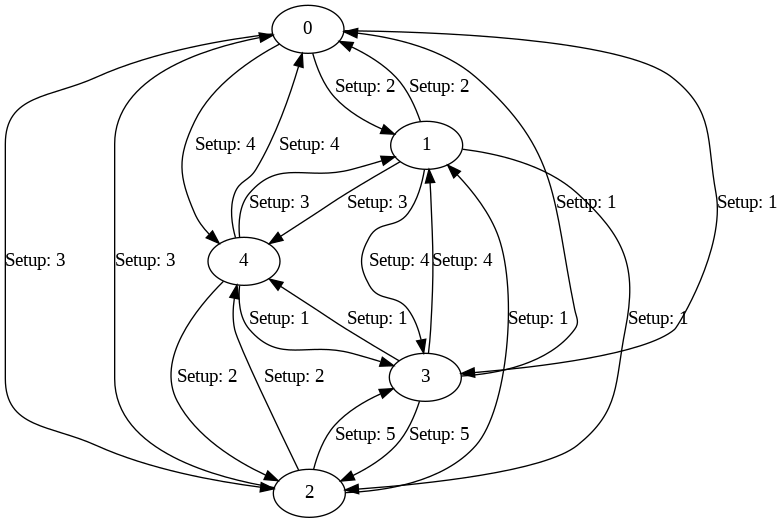

Graph for Iteration 77 displayed.
Iteration 79/100: Best Tardiness = 20.0


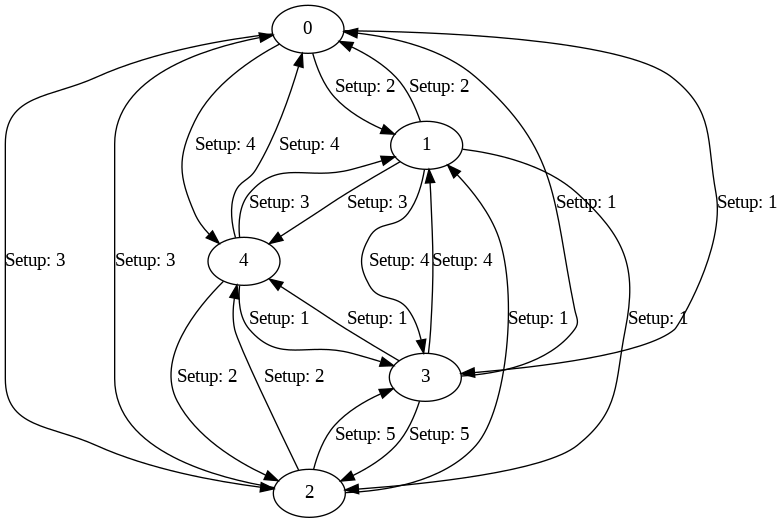

Graph for Iteration 78 displayed.
Iteration 80/100: Best Tardiness = 20.0


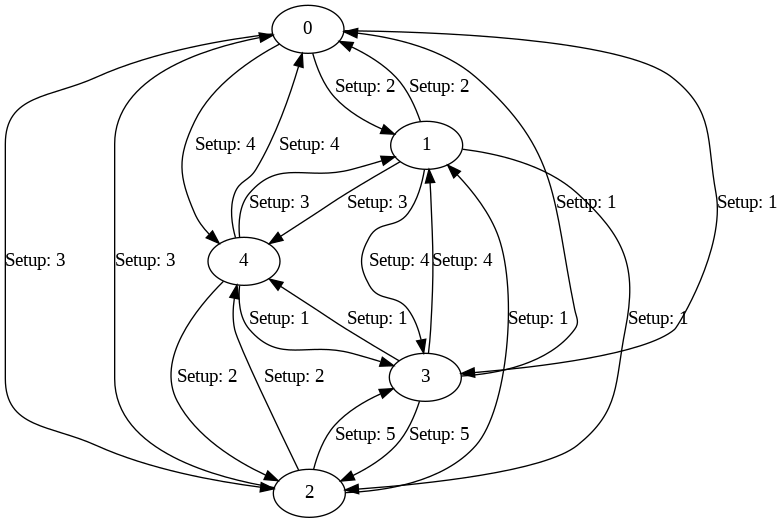

Graph for Iteration 79 displayed.
Iteration 81/100: Best Tardiness = 20.0


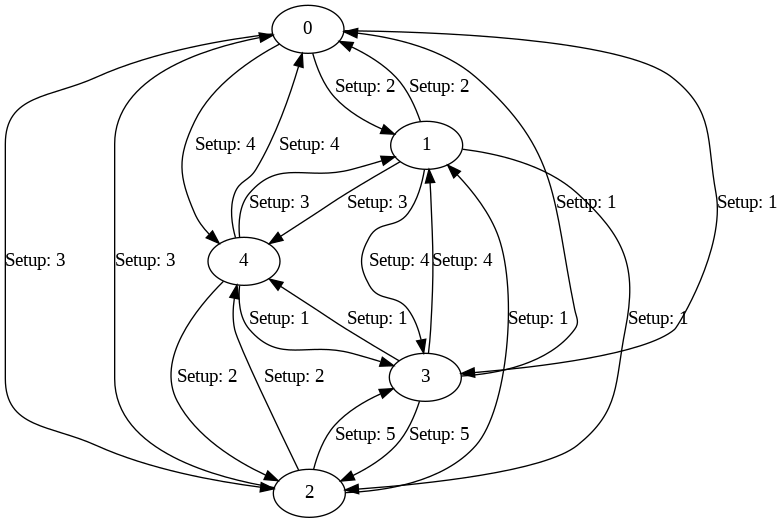

Graph for Iteration 80 displayed.
Iteration 82/100: Best Tardiness = 20.0


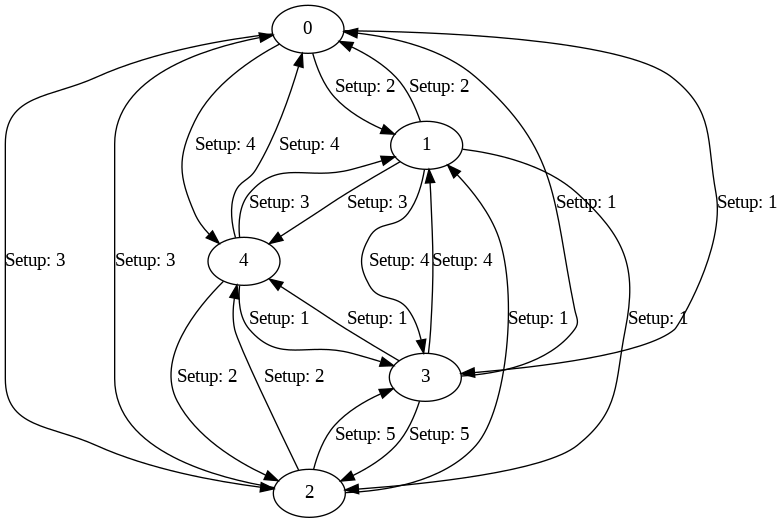

Graph for Iteration 81 displayed.
Iteration 83/100: Best Tardiness = 20.0


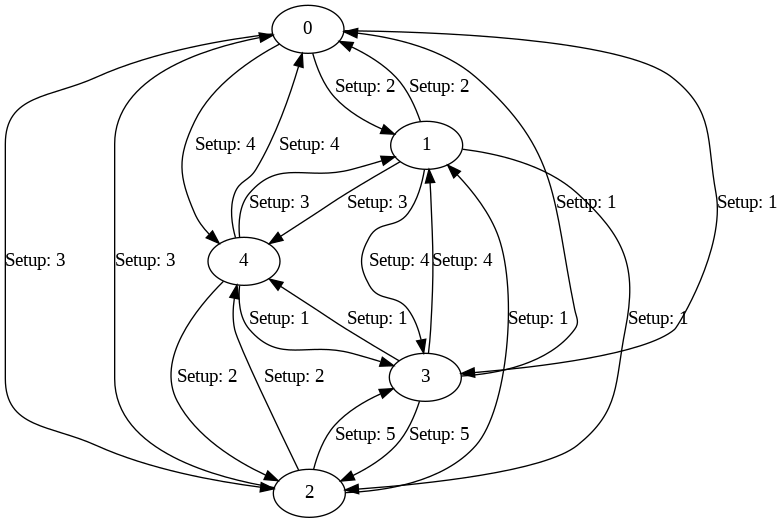

Graph for Iteration 82 displayed.
Iteration 84/100: Best Tardiness = 20.0


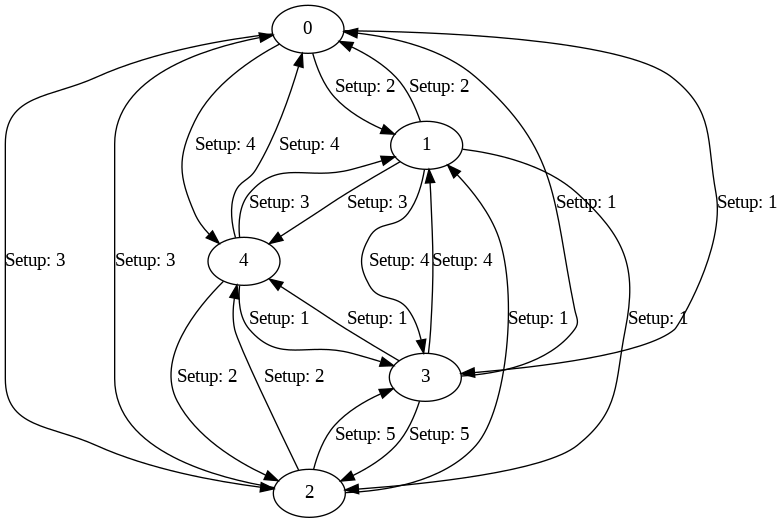

Graph for Iteration 83 displayed.
Iteration 85/100: Best Tardiness = 20.0


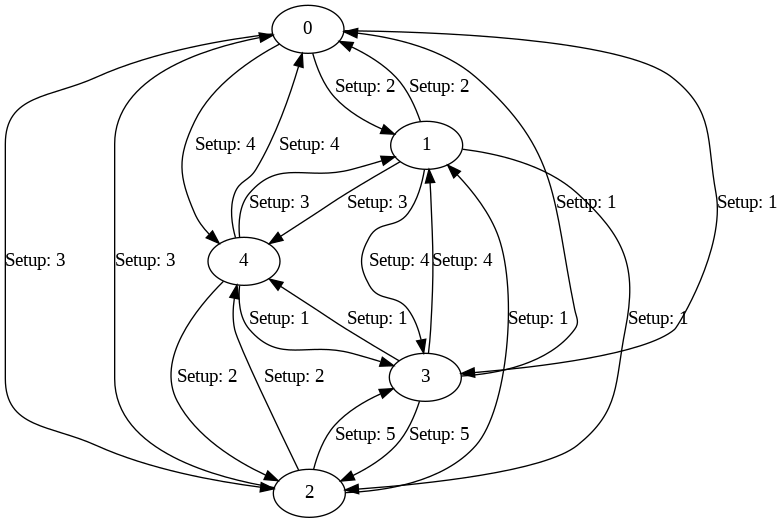

Graph for Iteration 84 displayed.
Iteration 86/100: Best Tardiness = 20.0


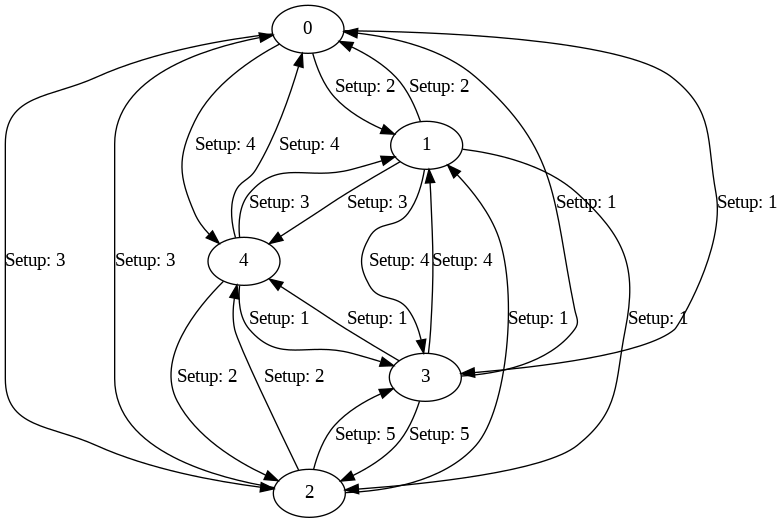

Graph for Iteration 85 displayed.
Iteration 87/100: Best Tardiness = 21.0


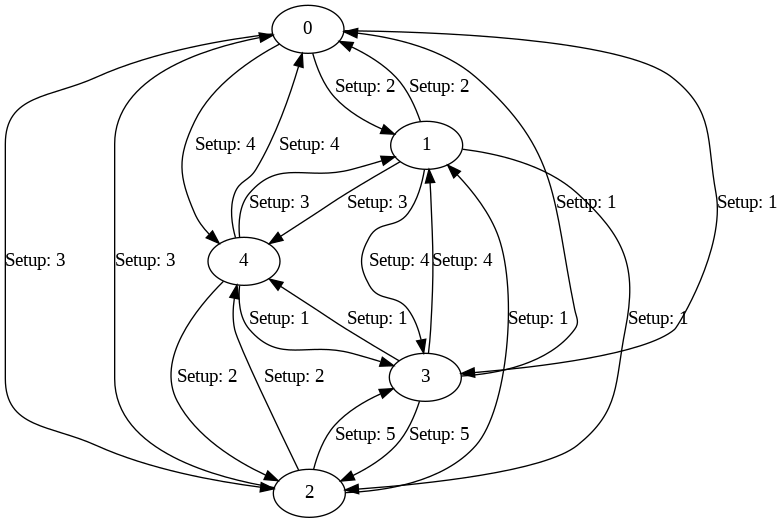

Graph for Iteration 86 displayed.
Iteration 88/100: Best Tardiness = 20.0


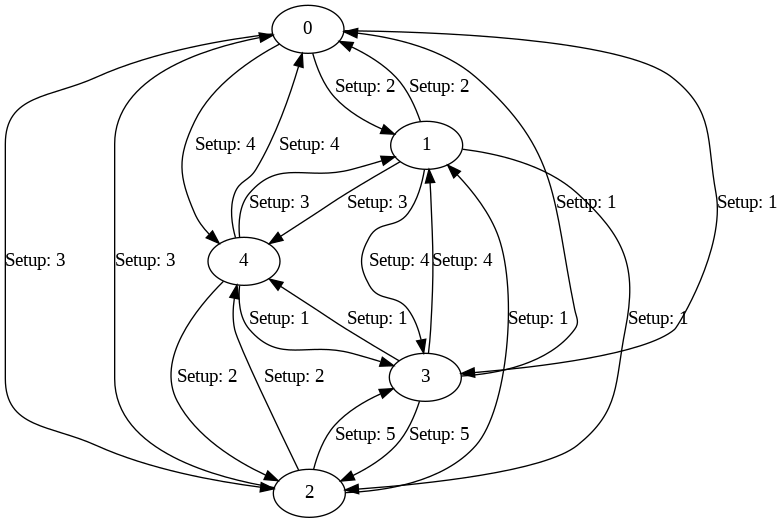

Graph for Iteration 87 displayed.
Iteration 89/100: Best Tardiness = 20.0


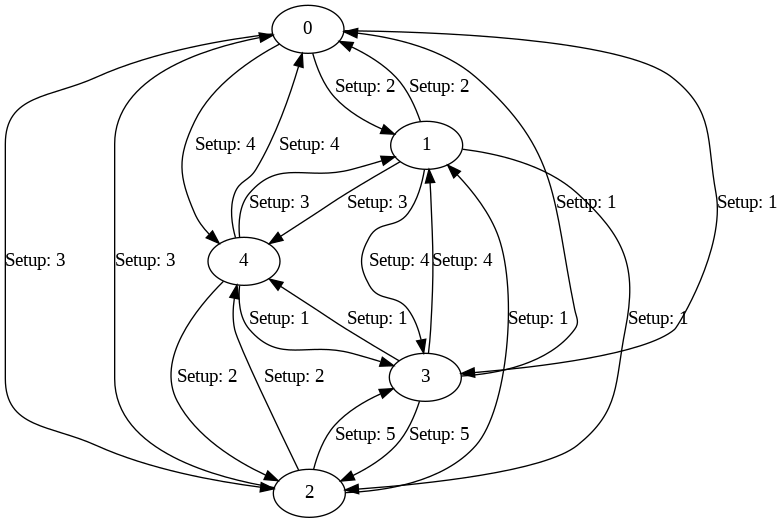

Graph for Iteration 88 displayed.
Iteration 90/100: Best Tardiness = 20.0


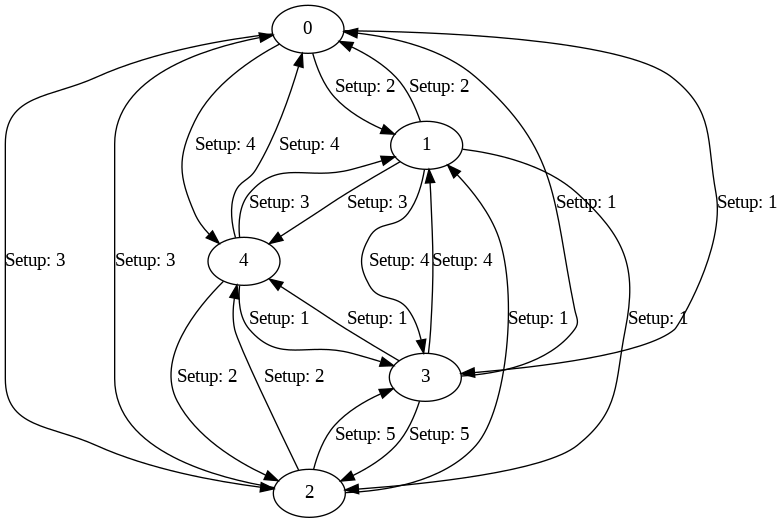

Graph for Iteration 89 displayed.
Iteration 91/100: Best Tardiness = 21.0


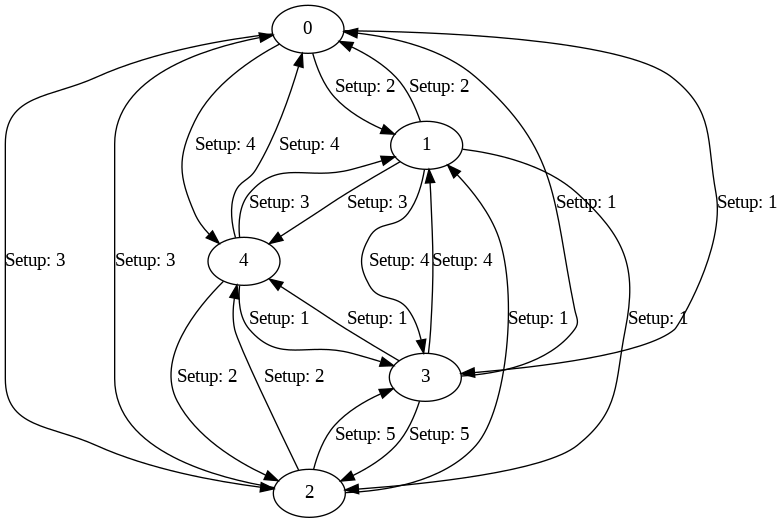

Graph for Iteration 90 displayed.
Iteration 92/100: Best Tardiness = 20.0


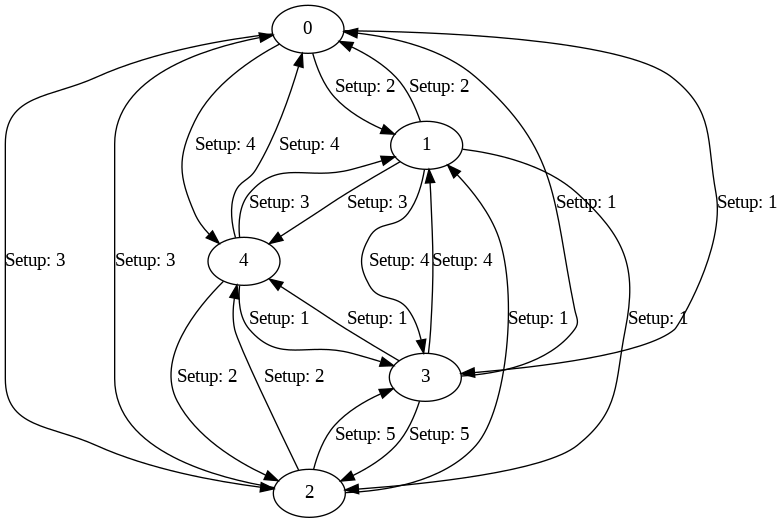

Graph for Iteration 91 displayed.
Iteration 93/100: Best Tardiness = 20.0


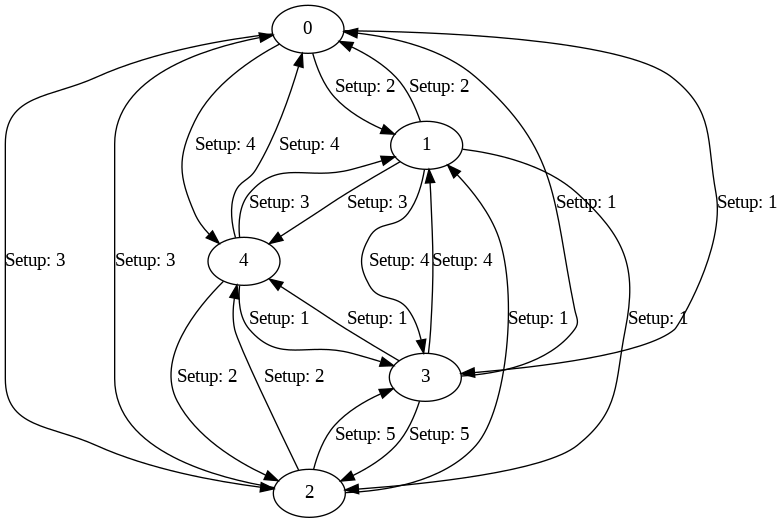

Graph for Iteration 92 displayed.
Iteration 94/100: Best Tardiness = 20.0


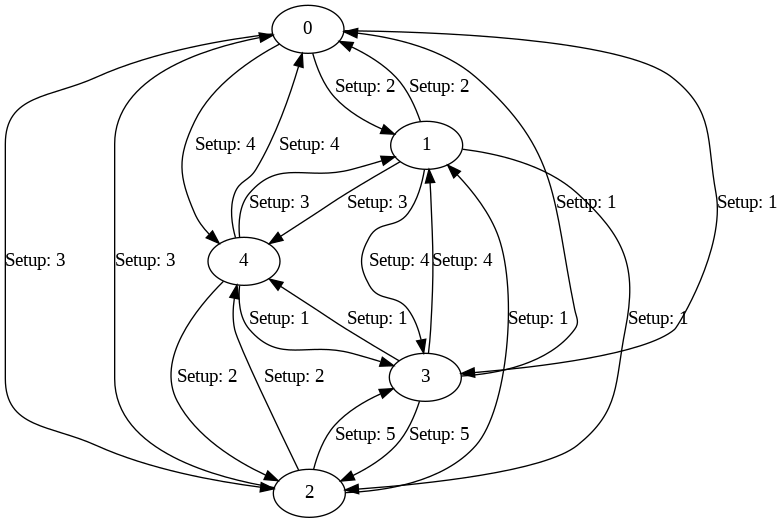

Graph for Iteration 93 displayed.
Iteration 95/100: Best Tardiness = 20.0


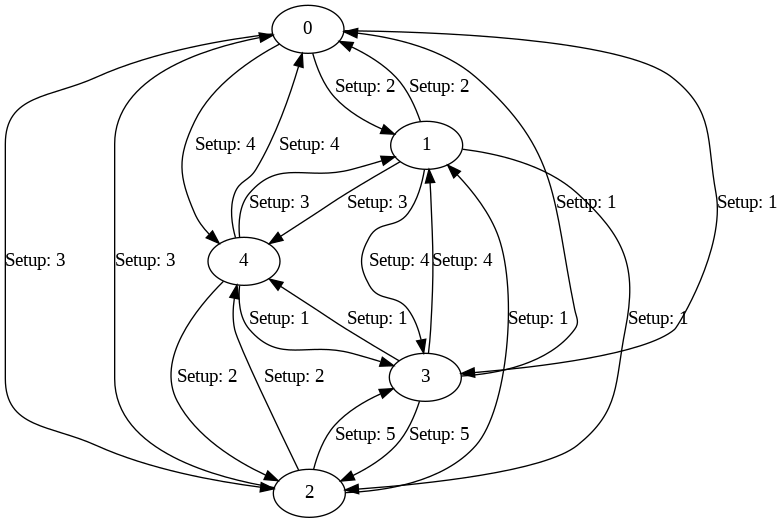

Graph for Iteration 94 displayed.
Iteration 96/100: Best Tardiness = 20.0


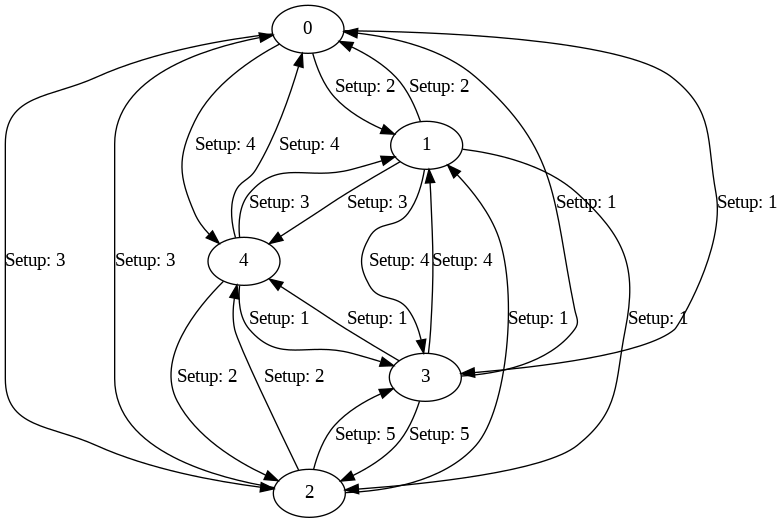

Graph for Iteration 95 displayed.
Iteration 97/100: Best Tardiness = 20.0


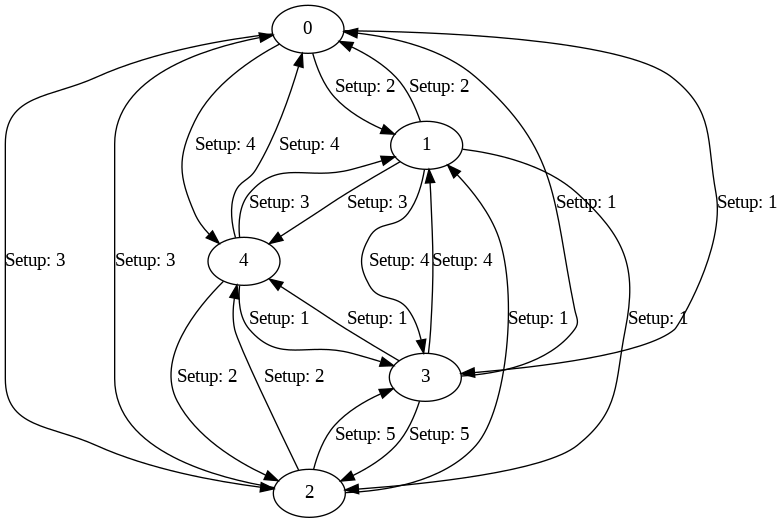

Graph for Iteration 96 displayed.
Iteration 98/100: Best Tardiness = 20.0


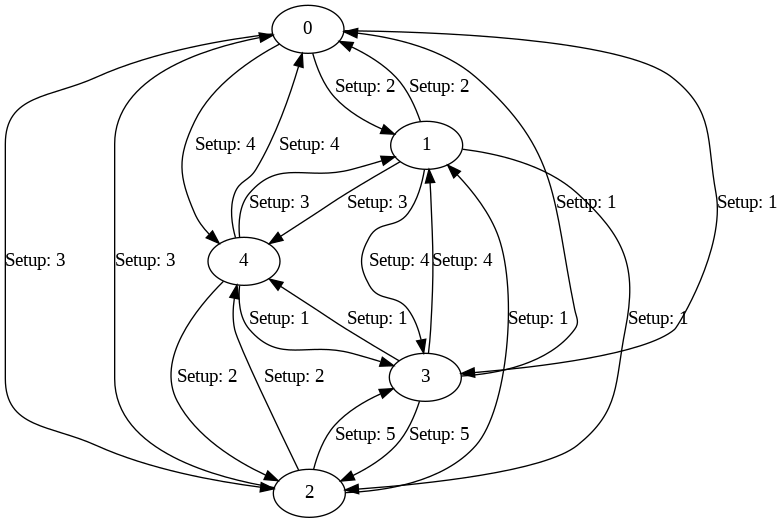

Graph for Iteration 97 displayed.
Iteration 99/100: Best Tardiness = 20.0


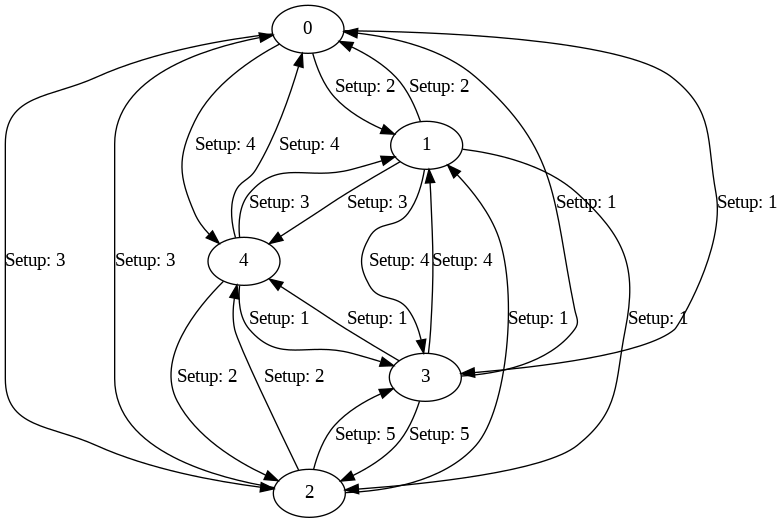

Graph for Iteration 98 displayed.
Iteration 100/100: Best Tardiness = 20.0


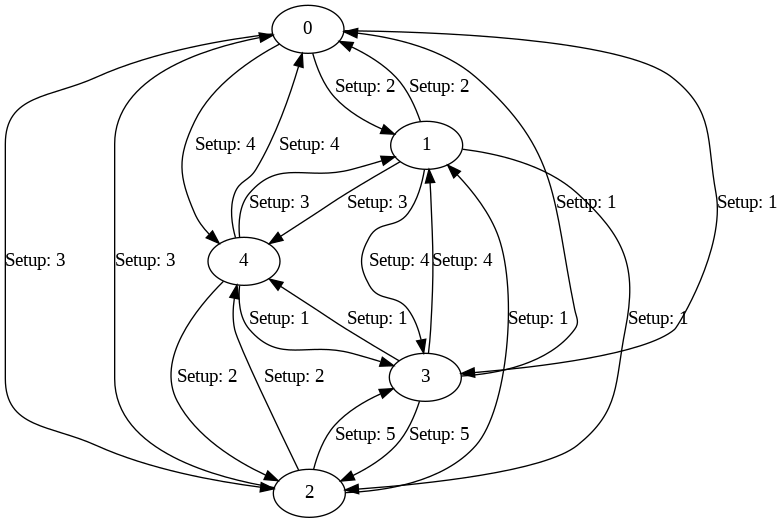

Graph for Iteration 99 displayed.


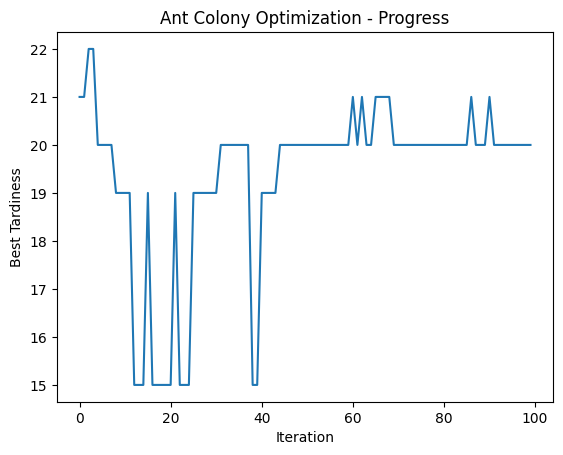

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pygraphviz as pgv
from IPython.display import Image, display
class AntColony:
    def __init__(self, num_ants, num_jobs, setup_times, processing_times, due_dates, alpha=1.0, beta=2.0, evaporation_rate=0.5):
        self.num_ants = num_ants
        self.num_jobs = num_jobs
        self.setup_times = setup_times
        self.processing_times = processing_times
        self.due_dates = due_dates
        self.alpha = alpha
        self.beta = beta
        self.evaporation_rate = evaporation_rate
        self.pheromone_matrix = np.ones((num_jobs, num_jobs))
        self.graph = self.create_dependency_graph()
    def create_dependency_graph(self):
        graph = pgv.AGraph(directed=True)
        for i in range(self.num_jobs):
            for j in range(self.num_jobs):
                if self.setup_times[i, j] > 0:
                    graph.add_edge(i, j, label=f'Setup: {self.setup_times[i, j]}')
        return graph
    def visualize_graph(self, iteration):
        filename = f'aco_iteration_{iteration}.png'
        self.graph.draw(filename, format='png', prog='dot')
        display(Image(filename))
        print(f"Graph for Iteration {iteration} displayed.")
    def run(self, num_iterations):
        best_tardiness_list = []
        for iteration in range(num_iterations):
            solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution()
                solutions.append((solution, self.calculate_tardiness(solution)))
            best_solution = min(solutions, key=lambda x: x[1])[0]
            self.update_pheromones(best_solution)
            best_tardiness = self.calculate_tardiness(best_solution)
            best_tardiness_list.append(best_tardiness)
            print(f"Iteration {iteration + 1}/{num_iterations}: Best Tardiness = {best_tardiness}")
            self.visualize_graph(iteration)
        self.plot_progress(best_tardiness_list)
    def construct_solution(self):
        solution = []
        remaining_jobs = set(range(self.num_jobs))
        current_job = np.random.choice(list(remaining_jobs))
        remaining_jobs.remove(current_job)
        solution.append(current_job)
        while remaining_jobs:
            next_job = self.select_next_job(current_job, remaining_jobs)
            solution.append(next_job)
            remaining_jobs.remove(next_job)
            current_job = next_job
        return solution
    def select_next_job(self, current_job, remaining_jobs):
        probabilities = []
        for job in remaining_jobs:
            transition_prob = self.calculate_transition_probability(current_job, job)
            probabilities.append(transition_prob)
        probabilities = np.array(probabilities)
        normalized_probs = probabilities / probabilities.sum()
        next_job = np.random.choice(list(remaining_jobs), p=normalized_probs)
        return next_job
    def calculate_transition_probability(self, current_job, next_job):
        pheromone = self.pheromone_matrix[current_job, next_job]
        visibility = 1.0 / (self.setup_times[current_job, next_job] + self.processing_times[next_job])
        return pheromone ** self.alpha * visibility ** self.beta
    def calculate_tardiness(self, solution):
        completion_times = np.zeros(self.num_jobs)
        tardiness = 0
        for job in solution:
            completion_times[job] = max(completion_times[job - 1], self.due_dates[job]) + self.processing_times[job]
        for job in solution:
            tardiness += max(0, completion_times[job] - self.due_dates[job])
        return tardiness
    def update_pheromones(self, best_solution):
        evaporation_rate = self.evaporation_rate
        for i in range(self.num_jobs - 1):
            for j in range(i + 1, self.num_jobs):
                self.pheromone_matrix[i, j] *= (1 - evaporation_rate)
                self.pheromone_matrix[j, i] = self.pheromone_matrix[i, j]
        for i in range(self.num_jobs - 1):
            self.pheromone_matrix[best_solution[i], best_solution[i + 1]] += 1.0 / self.calculate_tardiness(best_solution)
    def plot_progress(self, best_tardiness_list):
        plt.plot(best_tardiness_list)
        plt.title('Ant Colony Optimization - Progress')
        plt.xlabel('Iteration')
        plt.ylabel('Best Tardiness')
        plt.show()
num_ants = 10
num_jobs = 5
setup_times = np.array([[0, 2, 3, 1, 4],
                        [2, 0, 1, 4, 3],
                        [3, 1, 0, 5, 2],
                        [1, 4, 5, 0, 1],
                        [4, 3, 2, 1, 0]])
processing_times = np.array([5, 4, 3, 2, 1])
due_dates = np.array([10, 8, 6, 4, 2])
aco = AntColony(num_ants, num_jobs, setup_times, processing_times, due_dates)
aco.run(num_iterations=100)

**`Multistage Flowshop Scheduling Problem (MFSP) with Sequence Dependent Setup/Changeover Times`**

In [ ]:
import numpy as np
class MFSP_ACO:
    def __init__(self, num_jobs, num_stages, processing_times, setup_times):
        self.num_jobs = num_jobs
        self.num_stages = num_stages
        self.processing_times = processing_times
        self.setup_times = setup_times
        self.pheromones = np.ones((num_stages - 1, num_stages - 1))
        self.evaporation_rate = 0.5
        self.alpha = 1.0
        self.beta = 2.0
        self.num_ants = 10
        self.iterations = 100
    def calculate_total_time(self, solution):
        total_time = 0
        for i in range(self.num_jobs):
            for j in range(self.num_stages - 1):
                total_time += self.processing_times[i][j]
                total_time += self.setup_times[j][solution[i][j]]
        return total_time
    def generate_ant_solution(self):
        solution = np.zeros((self.num_jobs, self.num_stages - 1), dtype=int)
        for i in range(self.num_jobs):
            for j in range(self.num_stages - 1):
                valid_indices = np.setdiff1d(np.arange(self.num_stages - 1), solution[i])
                if len(valid_indices) == 0:
                    choice = np.random.choice(np.arange(self.num_stages - 1))
                else:
                    probabilities = (self.pheromones[j][valid_indices] ** self.alpha) * \
                                    ((1 / (self.processing_times[i][j] + self.setup_times[j][valid_indices])) ** self.beta)
                    probabilities /= probabilities.sum()
                    choice = np.random.choice(valid_indices, p=probabilities)
                solution[i][j] = choice
        return solution
    def update_pheromones(self, solutions):
        pheromone_delta = np.zeros((self.num_stages - 1, self.num_stages - 1))
        for solution in solutions:
            total_time = self.calculate_total_time(solution)
            for i in range(self.num_jobs):
                for j in range(self.num_stages - 1):
                    pheromone_delta[j][solution[i][j]] += 1 / total_time
        self.pheromones = (1 - self.evaporation_rate) * self.pheromones + pheromone_delta
    def solve(self):
        for iteration in range(self.iterations):
            ant_solutions = [self.generate_ant_solution() for _ in range(self.num_ants)]
            best_solution = min(ant_solutions, key=lambda x: self.calculate_total_time(x))
            self.update_pheromones(ant_solutions)
        best_time = self.calculate_total_time(best_solution)
        print("Best solution =\n", best_solution)
        print("Best completion time =", best_time)
num_jobs = 3
num_stages = 4
processing_times = np.array([[2, 3, 4, 2],
                              [1, 2, 1, 3],
                              [3, 2, 4, 1]])
setup_times = np.array([[0, 2, 1, 3],
                        [2, 0, 1, 2],
                        [1, 2, 0, 1]])
mfsp_aco = MFSP_ACO(num_jobs, num_stages, processing_times, setup_times)
mfsp_aco.solve()

Best solution =
 [[2 1 2]
 [2 1 2]
 [2 1 2]]
Best completion time = 25


<ipython-input-47-f4d80fd14581>:48: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('viridis', self.num_jobs)


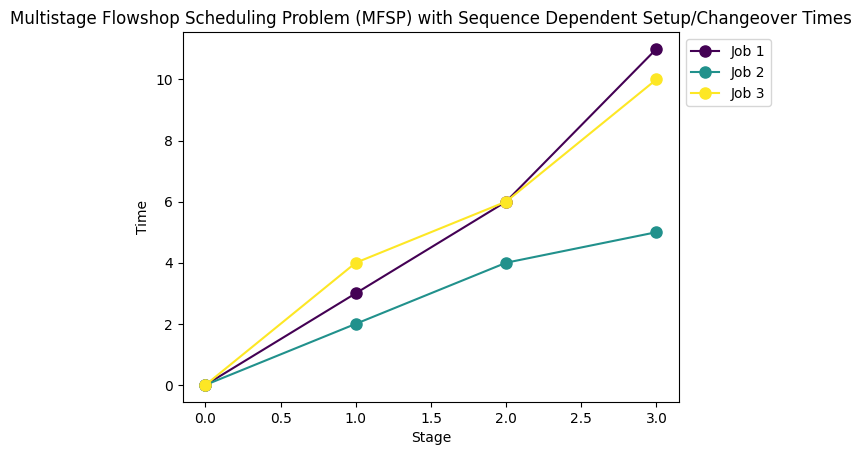

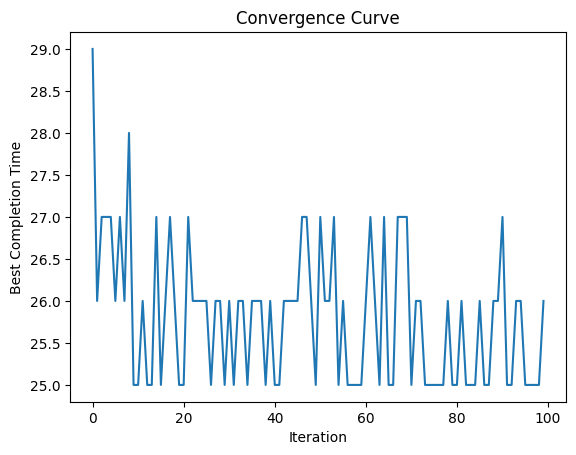

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
class MFSP_ACO:
    def __init__(self, num_jobs, num_stages, processing_times, setup_times):
        self.num_jobs = num_jobs
        self.num_stages = num_stages
        self.processing_times = processing_times
        self.setup_times = setup_times
        self.pheromones = np.ones((num_stages - 1, num_stages - 1))
        self.evaporation_rate = 0.5
        self.alpha = 1.0
        self.beta = 2.0
        self.num_ants = 10
        self.iterations = 100
        self.plot_data = {'times': [], 'solutions': []}
    def calculate_total_time(self, solution):
        total_time = 0
        for i in range(self.num_jobs):
            for j in range(self.num_stages - 1):
                total_time += self.processing_times[i][j]
                total_time += self.setup_times[j][solution[i][j]]
        return total_time
    def generate_ant_solution(self):
        solution = np.zeros((self.num_jobs, self.num_stages - 1), dtype=int)
        for i in range(self.num_jobs):
            for j in range(self.num_stages - 1):
                valid_indices = np.setdiff1d(np.arange(self.num_stages - 1), solution[i])
                if len(valid_indices) == 0:
                    choice = np.random.choice(np.arange(self.num_stages - 1))
                else:
                    probabilities = (self.pheromones[j][valid_indices] ** self.alpha) * \
                                    ((1 / (self.processing_times[i][j] + self.setup_times[j][valid_indices])) ** self.beta)
                    probabilities /= probabilities.sum()
                    choice = np.random.choice(valid_indices, p=probabilities)
                solution[i][j] = choice
        return solution
    def update_pheromones(self, solutions):
        pheromone_delta = np.zeros((self.num_stages - 1, self.num_stages - 1))
        for solution in solutions:
            total_time = self.calculate_total_time(solution)
            for i in range(self.num_jobs):
                for j in range(self.num_stages - 1):
                    pheromone_delta[j][solution[i][j]] += 1 / total_time
        self.pheromones = (1 - self.evaporation_rate) * self.pheromones + pheromone_delta
    def visualize_solution(self, solution):
        fig, ax = plt.subplots()
        colors = plt.cm.get_cmap('viridis', self.num_jobs)
        lines = []
        for i in range(self.num_jobs):
            x = np.arange(self.num_stages)
            y = [0] + [self.processing_times[i][j] + self.setup_times[j][solution[i][j]] for j in range(self.num_stages - 1)]
            line = Line2D(x, np.cumsum(y), color=colors(i), marker='o', markersize=8, label=f'Job {i+1}')
            lines.append(line)
        for line in lines:
            ax.add_line(line)
        ax.autoscale()
        ax.legend(loc='upper left', bbox_to_anchor=(1, 1))
        plt.xlabel('Stage')
        plt.ylabel('Time')
        plt.title('Multistage Flowshop Scheduling Problem (MFSP) with Sequence Dependent Setup/Changeover Times')
        plt.show()
    def solve(self):
        for iteration in range(self.iterations):
            ant_solutions = [self.generate_ant_solution() for _ in range(self.num_ants)]
            best_solution = min(ant_solutions, key=lambda x: self.calculate_total_time(x))
            self.update_pheromones(ant_solutions)
            best_time = self.calculate_total_time(best_solution)
            self.plot_data['times'].append(best_time)
            self.plot_data['solutions'].append(best_solution)
        self.visualize_solution(self.plot_data['solutions'][-1])
        plt.figure()
        plt.plot(range(self.iterations), self.plot_data['times'])
        plt.xlabel('Iteration')
        plt.ylabel('Best Completion Time')
        plt.title('Convergence Curve')
        plt.show()
num_jobs = 3
num_stages = 4
processing_times = np.array([[2, 3, 4, 2],
                              [1, 2, 1, 3],
                              [3, 2, 4, 1]])
setup_times = np.array([[0, 2, 1, 3],
                        [2, 0, 1, 2],
                        [1, 2, 0, 1]])
mfsp_aco = MFSP_ACO(num_jobs, num_stages, processing_times, setup_times)
mfsp_aco.solve()

**`Assembly Sequence Planning`**

In [2]:
import numpy as np
class Task:
    def __init__(self, task_id, description, duration, resource_requirement):
        self.task_id = task_id
        self.description = description
        self.duration = duration
        self.resource_requirement = resource_requirement
class AssemblySequencePlanning:
    def __init__(self, num_ants, num_iterations, alpha, beta, rho, q):
        self.num_ants = num_ants
        self.num_iterations = num_iterations
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q = q
    def initialize(self, tasks):
        self.tasks = tasks
        num_tasks = len(tasks)
        self.pheromone_levels = np.ones((num_tasks, num_tasks))
        np.fill_diagonal(self.pheromone_levels, 0)
        self.heuristic_info = np.random.rand(num_tasks, num_tasks)
    def ant_colony_optimization(self):
        best_sequence = None
        best_cost = float('inf')
        for iteration in range(self.num_iterations):
            ant_solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution()
                cost = self.calculate_sequence_cost(solution)
                if cost < best_cost:
                    best_cost = cost
                    best_sequence = solution
                ant_solutions.append((solution, cost))
            self.update_pheromones(ant_solutions)
        return best_sequence, best_cost
    def construct_solution(self):
        num_tasks = len(self.tasks)
        start_task = np.random.choice(range(num_tasks))
        solution = [start_task]
        while len(solution) < num_tasks:
            next_task = self.select_next_task(solution[-1], solution)
            solution.append(next_task)
        return solution

    def select_next_task(self, current_task, solution):
        num_tasks = len(self.tasks)
        probabilities = np.zeros(num_tasks)
        for task_id in range(num_tasks):
            if task_id not in solution:
                probabilities[task_id] = (self.pheromone_levels[current_task, task_id] ** self.alpha) * \
                                         (self.heuristic_info[current_task, task_id] ** self.beta)
        probabilities /= probabilities.sum()
        next_task = np.random.choice(range(num_tasks), p=probabilities)
        return next_task
    def calculate_sequence_cost(self, sequence):
        total_time = 0
        total_resources = 0
        for i in range(len(sequence) - 1):
            current_task = sequence[i]
            next_task = sequence[i + 1]
            total_time += self.tasks[next_task].duration
            total_resources += self.tasks[next_task].resource_requirement
        return total_time + total_resources
    def update_pheromones(self, ant_solutions):
        self.pheromone_levels *= (1 - self.rho)
        for solution, cost in ant_solutions:
            for i in range(len(solution) - 1):
                self.pheromone_levels[solution[i], solution[i + 1]] += self.q / cost
tasks = [
    Task(0, "Task A", 3, 2),
    Task(1, "Task B", 5, 3),
    Task(2, "Task C", 2, 1),
    Task(3, "Task D", 4, 2)
]
num_ants = 5
num_iterations = 100
alpha = 1.0
beta = 2.0
rho = 0.1
q = 1.0
asp = AssemblySequencePlanning(num_ants, num_iterations, alpha, beta, rho, q)
asp.initialize(tasks)
best_sequence, best_cost = asp.ant_colony_optimization()
print("Best Sequence:")
for task_id in best_sequence:
    task = tasks[task_id]
    print(f"Task-{task.task_id}: {task.description}, Duration = {task.duration}, Resource Requirement = {task.resource_requirement}")
print("Best Cost =", best_cost)

Best Sequence:
Task-1: Task B, Duration = 5, Resource Requirement = 3
Task-2: Task C, Duration = 2, Resource Requirement = 1
Task-3: Task D, Duration = 4, Resource Requirement = 2
Task-0: Task A, Duration = 3, Resource Requirement = 2
Best Cost = 14


In [4]:
!pip install matplotlib

Best Sequence:
Task-1: Task B, Duration = 5, Resource Requirement = 3
Task-0: Task A, Duration = 3, Resource Requirement = 2
Task-3: Task D, Duration = 4, Resource Requirement = 2
Task-2: Task C, Duration = 2, Resource Requirement = 1
Best Cost = 14


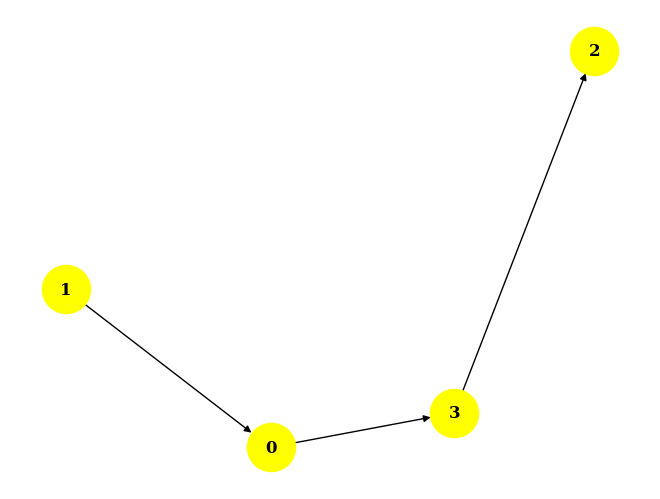

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
class Task:
    def __init__(self, task_id, description, duration, resource_requirement):
        self.task_id = task_id
        self.description = description
        self.duration = duration
        self.resource_requirement = resource_requirement
class AssemblySequencePlanning:
    def __init__(self, num_ants, num_iterations, alpha, beta, rho, q):
        self.num_ants = num_ants
        self.num_iterations = num_iterations
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q = q
    def initialize(self, tasks):
        self.tasks = tasks
        num_tasks = len(tasks)
        self.pheromone_levels = np.ones((num_tasks, num_tasks))
        np.fill_diagonal(self.pheromone_levels, 0)
        self.heuristic_info = np.random.rand(num_tasks, num_tasks)
    def ant_colony_optimization(self):
        best_sequence = None
        best_cost = float('inf')
        for iteration in range(self.num_iterations):
            ant_solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution()
                cost = self.calculate_sequence_cost(solution)
                if cost < best_cost:
                    best_cost = cost
                    best_sequence = solution
                ant_solutions.append((solution, cost))
            self.update_pheromones(ant_solutions)
        return best_sequence, best_cost
    def construct_solution(self):
        num_tasks = len(self.tasks)
        start_task = np.random.choice(range(num_tasks))
        solution = [start_task]
        while len(solution) < num_tasks:
            next_task = self.select_next_task(solution[-1], solution)
            solution.append(next_task)
        return solution
    def select_next_task(self, current_task, solution):
        num_tasks = len(self.tasks)
        probabilities = np.zeros(num_tasks)
        for task_id in range(num_tasks):
            if task_id not in solution:
                probabilities[task_id] = (self.pheromone_levels[current_task, task_id] ** self.alpha) * \
                                         (self.heuristic_info[current_task, task_id] ** self.beta)
        probabilities /= probabilities.sum()
        next_task = np.random.choice(range(num_tasks), p=probabilities)
        return next_task
    def calculate_sequence_cost(self, sequence):
        total_time = 0
        total_resources = 0
        for i in range(len(sequence) - 1):
            current_task = sequence[i]
            next_task = sequence[i + 1]
            total_time += self.tasks[next_task].duration
            total_resources += self.tasks[next_task].resource_requirement
        return total_time + total_resources
    def update_pheromones(self, ant_solutions):
        self.pheromone_levels *= (1 - self.rho)
        for solution, cost in ant_solutions:
            for i in range(len(solution) - 1):
                self.pheromone_levels[solution[i], solution[i + 1]] += self.q / cost
    def plot_assembly_sequence(self, best_sequence):
        G = self.create_graph(best_sequence)
        self.draw_graph(G)
    def create_graph(self, best_sequence):
        import networkx as nx
        G = nx.DiGraph()
        for task_id, task in enumerate(self.tasks):
            G.add_node(task_id, label=f"{task.description}\nDuration: {task.duration}\nResources: {task.resource_requirement}")
        for i in range(len(best_sequence) - 1):
            G.add_edge(best_sequence[i], best_sequence[i + 1])
        return G
    def draw_graph(self, G):
        pos = nx.spring_layout(G)
        labels = nx.get_edge_attributes(G, 'weight')
        nx.draw(G, pos, with_labels=True, font_weight='bold', node_size=1200, node_color='yellow', font_size=12, font_family='serif')
        nx.draw_networkx_edge_labels(G, pos, edge_labels=labels)
        plt.show()
tasks = [
    Task(0, "Task A", 3, 2),
    Task(1, "Task B", 5, 3),
    Task(2, "Task C", 2, 1),
    Task(3, "Task D", 4, 2)
]
num_ants = 5
num_iterations = 100
alpha = 1.0
beta = 2.0
rho = 0.1
q = 1.0
asp = AssemblySequencePlanning(num_ants, num_iterations, alpha, beta, rho, q)
asp.initialize(tasks)
best_sequence, best_cost = asp.ant_colony_optimization()
print("Best Sequence:")
for task_id in best_sequence:
    task = tasks[task_id]
    print(f"Task-{task.task_id}: {task.description}, Duration = {task.duration}, Resource Requirement = {task.resource_requirement}")
print("Best Cost =", best_cost)
asp.plot_assembly_sequence(best_sequence)

In [10]:
!apt install libgraphviz-dev

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common libgvc6-plugins-gtk
  librsvg2-common libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk librsvg2-common libxdot4
0 upgraded, 9 newly installed, 0 to remove and 33 not upgraded.
Need to get 2,433 kB of archives.
After this operation, 7,694 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-common all 2.24.33-2ubuntu2 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-0 amd64 2.24.33-2ubuntu2 [2,037 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgail18 amd64 2.24.33-2ubuntu2 [15.9 kB]
Get:4 http://archive.ubuntu.com/ubuntu jammy/main amd64

In [11]:
!pip install pygraphviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.9/104.9 kB 3.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pygraphviz: filename=pygraphviz-1.12-cp310-cp310-linux_x86_64.whl size=168132 sha256=655341d5ecafdea57bbe81b6dfb5a8e72dbb6f627174b95e8186eb29122cdcc7
  Stored in directory: /root/.cache/pip/wheels/1d/ee/b5/a2f54f9e9b3951599c05dcce270ca85e472f8e6cec470e397a
Successfully built pygraphviz


Best Sequence:
Task-1: Task B, Duration = 5, Resource Requirement = 3
Task-0: Task A, Duration = 3, Resource Requirement = 2
Task-3: Task D, Duration = 4, Resource Requirement = 2
Task-2: Task C, Duration = 2, Resource Requirement = 1
Best Cost = 14


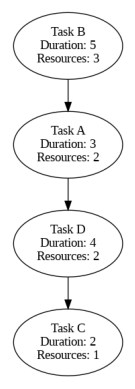

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import pygraphviz as pgv
class Task:
    def __init__(self, task_id, description, duration, resource_requirement):
        self.task_id = task_id
        self.description = description
        self.duration = duration
        self.resource_requirement = resource_requirement
class AssemblySequencePlanning:
    def __init__(self, num_ants, num_iterations, alpha, beta, rho, q):
        self.num_ants = num_ants
        self.num_iterations = num_iterations
        self.alpha = alpha
        self.beta = beta
        self.rho = rho
        self.q = q
    def initialize(self, tasks):
        self.tasks = tasks
        num_tasks = len(tasks)
        self.pheromone_levels = np.ones((num_tasks, num_tasks))
        np.fill_diagonal(self.pheromone_levels, 0)
        self.heuristic_info = np.random.rand(num_tasks, num_tasks)
    def ant_colony_optimization(self):
        best_sequence = None
        best_cost = float('inf')
        for iteration in range(self.num_iterations):
            ant_solutions = []
            for ant in range(self.num_ants):
                solution = self.construct_solution()
                cost = self.calculate_sequence_cost(solution)
                if cost < best_cost:
                    best_cost = cost
                    best_sequence = solution
                ant_solutions.append((solution, cost))
            self.update_pheromones(ant_solutions)
        return best_sequence, best_cost
    def construct_solution(self):
        num_tasks = len(self.tasks)
        start_task = np.random.choice(range(num_tasks))
        solution = [start_task]
        while len(solution) < num_tasks:
            next_task = self.select_next_task(solution[-1], solution)
            solution.append(next_task)
        return solution
    def select_next_task(self, current_task, solution):
        num_tasks = len(self.tasks)
        probabilities = np.zeros(num_tasks)
        for task_id in range(num_tasks):
            if task_id not in solution:
                probabilities[task_id] = (self.pheromone_levels[current_task, task_id] ** self.alpha) * \
                                         (self.heuristic_info[current_task, task_id] ** self.beta)
        probabilities /= probabilities.sum()
        next_task = np.random.choice(range(num_tasks), p=probabilities)
        return next_task
    def calculate_sequence_cost(self, sequence):
        total_time = 0
        total_resources = 0
        for i in range(len(sequence) - 1):
            current_task = sequence[i]
            next_task = sequence[i + 1]
            total_time += self.tasks[next_task].duration
            total_resources += self.tasks[next_task].resource_requirement
        return total_time + total_resources
    def update_pheromones(self, ant_solutions):
        self.pheromone_levels *= (1 - self.rho)
        for solution, cost in ant_solutions:
            for i in range(len(solution) - 1):
                self.pheromone_levels[solution[i], solution[i + 1]] += self.q / cost
    def create_graph(self, best_sequence):
        G = pgv.AGraph(directed=True)
        for task_id, task in enumerate(self.tasks):
            G.add_node(task_id, label=f"{task.description}\nDuration: {task.duration}\nResources: {task.resource_requirement}")
        for i in range(len(best_sequence) - 1):
            G.add_edge(best_sequence[i], best_sequence[i + 1])
        return G
    def draw_graph(self, G):
        G.layout(prog="dot")
        G.draw("assembly_sequence.png")
        plt.imshow(plt.imread("assembly_sequence.png"))
        plt.axis('off')
        plt.show()
    def plot_assembly_sequence(self, best_sequence):
        G = self.create_graph(best_sequence)
        self.draw_graph(G)
tasks = [
    Task(0, "Task A", 3, 2),
    Task(1, "Task B", 5, 3),
    Task(2, "Task C", 2, 1),
    Task(3, "Task D", 4, 2)
]
num_ants = 5
num_iterations = 100
alpha = 1.0
beta = 2.0
rho = 0.1
q = 1.0
asp = AssemblySequencePlanning(num_ants, num_iterations, alpha, beta, rho, q)
asp.initialize(tasks)
best_sequence, best_cost = asp.ant_colony_optimization()
print("Best Sequence:")
for task_id in best_sequence:
    task = tasks[task_id]
    print(f"Task-{task.task_id}: {task.description}, Duration = {task.duration}, Resource Requirement = {task.resource_requirement}")
print("Best Cost =", best_cost)
asp.plot_assembly_sequence(best_sequence)